In [ ]:
import pandas as pd
import numpy as np
import random as rand
import time
import matplotlib.pyplot as plt
import copy
import math
import matplotlib.patches as patches
import random
from typing import Any, List, Dict, Callable, Optional

In [ ]:
class Visualizer:
  @staticmethod
  def visualize_state(state, items, max_capacity=50, title="Bin Packing State Visualization"):
    plt.style.use('seaborn-v0_8-darkgrid')
    fig, (ax, ax_stats) = plt.subplots(1, 2, figsize=(14, 6), gridspec_kw={'width_ratios': [3, 1]})

    container_indices = range(len(state))
    bottoms = [0] * len(state)
    colors = plt.cm.Set3.colors + plt.cm.Pastel1.colors
    color_map = {item_id: colors[i % len(colors)] for i, item_id in enumerate(items.keys())}

    max_total_height = 0
    bin_weights = []
    overflow_bins = 0

    for container_idx, container in enumerate(state):
      bin_weight = 0
      for item in container:
        height = items[item]
        bin_weight += height
        prev_bottom = bottoms[container_idx]
        new_top = prev_bottom + height

        ax.bar(
          container_idx,
          height,
          bottom=prev_bottom,
          color=color_map[item],
          edgecolor="black",
          linewidth=1.5,
          alpha=0.85,
          zorder=3
        )

        rgb = color_map[item]
        brightness = (rgb[0] * 299 + rgb[1] * 587 + rgb[2] * 114) / 1000
        text_color = 'black' if brightness > 0.5 else 'white'
        ax.text(
          container_idx,
          prev_bottom + height / 2,
          f"{item} ({height})",
          ha='center', va='center',
          color=text_color,
          fontsize=8,
          fontweight='bold',
          zorder=4
        )

        bottoms[container_idx] = new_top

      bin_weights.append(bin_weight)
      max_total_height = max(max_total_height, bottoms[container_idx])
      if bin_weight > max_capacity:
        overflow_bins += 1

    bar_width = 0.8
    for i, total in enumerate(bottoms):
      rect = patches.Rectangle(
        (i - bar_width / 2, 0),
        bar_width,
        max_capacity,
        linewidth=2.5,
        edgecolor='#2E86AB',
        facecolor='none',
        linestyle='--',
        zorder=2
      )
      ax.add_patch(rect)

      if total > max_capacity:
        overflow_height = total - max_capacity
        rect_over = patches.Rectangle(
          (i - bar_width / 2, max_capacity),
          bar_width,
          overflow_height,
          linewidth=3,
          edgecolor='#E63946',
          facecolor='#E63946',
          alpha=0.2,
          zorder=1
        )
        ax.add_patch(rect_over)

        overflow_percent = (total / max_capacity - 1) * 100
        ax.text(
          i,
          total + (max_total_height * 0.03),
          f"! +{overflow_percent:.1f}%",
          ha='center',
          va='bottom',
          color='#E63946',
          fontsize=10,
          fontweight='bold',
          bbox=dict(boxstyle='round,pad=0.4', facecolor='white', edgecolor='#E63946', linewidth=2)
        )
      else:
        fill_percent = total / max_capacity * 100
        color = '#06A77D' if fill_percent > 80  else '#457B9D'
        ax.text(
          i,
          max_capacity + (max_total_height * 0.03),
          f"{fill_percent:.1f}%",
          ha='center',
          va='bottom',
          color=color,
          fontsize=9,
          fontweight='bold',
          bbox=dict(boxstyle='round,pad=0.3', facecolor='white', edgecolor=color, linewidth=1.5, alpha=0.9)
        )

    ax.axhline(y=max_capacity, color='#2E86AB', linestyle='--', linewidth=2, alpha=0.7, label=f'Kapasitas: {max_capacity}', zorder=1)
    ax.set_xticks(container_indices)
    ax.set_xticklabels([f"Bin {i+1}" for i in container_indices], fontsize=10, fontweight='bold')
    ax.set_ylim(0, max(max_capacity * 1.35, max_total_height * 1.15))
    ax.set_ylabel("Berat", fontsize=12, fontweight='bold')

    obj_val = BinPackingBase.objective_fun(state, max_capacity, items)
    ax.set_title(f"{title}\nNilai Objektif: {obj_val:.2f}", fontsize=14, fontweight='bold', pad=15)
    ax.grid(axis='y', linestyle=':', alpha=0.4, zorder=0)
    ax.legend(loc='upper left', fontsize=10)

    ax_stats.axis('off')
    stats_text = [
        ("STATISTIK", "", "bold", 14, "#1D3557"),
        ("", "", "normal", 10, "black"),
        ("Jumlah Bin:", f"{len(state)}", "bold", 11, "#2E86AB"),
        ("Total Item:", f"{len(items)}", "normal", 10, "black"),
        ("Kapasitas/Bin:", f"{max_capacity}", "normal", 10, "black"),
        ("", "", "normal", 10, "black"),
        ("PENGGUNAAN", "", "bold", 12, "#1D3557"),
        ("", "", "normal", 10, "black"),
    ]

    for i, weight in enumerate(bin_weights):
        util = (weight / max_capacity) * 100
        status = "!" if weight > max_capacity else "+" if util > 80 else "o"
        color = "#E63946" if weight > max_capacity else "#06A77D" if util > 80 else "#457B9D"
        stats_text.append((f"{status} Bin {i+1}:", f"{weight}/{max_capacity} ({util:.1f}%)", "normal", 9, color))

    stats_text.extend([
        ("", "", "normal", 10, "black"),
        ("Overflow Bins:", f"{overflow_bins}", "bold", 11, "#E63946" if overflow_bins > 0 else "#06A77D"),
        ("Avg. Utilization:", f"{np.mean([w/max_capacity*100 for w in bin_weights]):.1f}%", "normal", 10, "black"),
    ])

    y_pos = 0.95
    for label, value, weight, size, color in stats_text:
        if label and value:
            ax_stats.text(0.05, y_pos, label, fontsize=size, fontweight=weight, color=color, va='top')
            ax_stats.text(0.95, y_pos, value, fontsize=size, fontweight=weight, color=color, va='top', ha='right')
        elif label:
            ax_stats.text(0.05, y_pos, label, fontsize=size, fontweight=weight, color=color, va='top')
        y_pos -= 0.06 if size > 10 else 0.045

    plt.tight_layout()
    plt.show()
    plt.style.use('default')


  @staticmethod
  def plot_objective_values(history, duration, title="Nilai Objektif per Iterasi"):
    plt.style.use('seaborn-v0_8-darkgrid')
    fig, ax1 = plt.subplots(figsize=(12, 6))
    iterations = list(range(1, len(history) + 1))


    ax1.plot(iterations, history, linewidth=2.5, color='#2E86AB', alpha=0.8, label='Objective Value')
    ax1.fill_between(iterations, history, alpha=0.2, color='#2E86AB')

    improvements = [i for i in range(1, len(history)) if history[i] < history[i-1]]
    if improvements:
        ax1.scatter([i+1 for i in improvements], [history[i] for i in improvements],
                   color='#06A77D', s=30, alpha=0.6, zorder=5, label='Improvements')

    start_val = history[0]
    end_val = history[-1]
    improvement_pct = (abs(end_val - start_val) / start_val * 100) if start_val != 0 else 0

    ax1.scatter(iterations[0], start_val, color='#E63946', s=150, zorder=10,
               marker='o', edgecolors='white', linewidths=2, label='Start')
    ax1.scatter(iterations[-1], end_val, color='#06A77D', s=150, zorder=10,
               marker='*', edgecolors='white', linewidths=2, label='End')

    ax1.annotate(f'Start: {start_val:.2f}',
                xy=(iterations[0], start_val), xytext=(20, 20),
                textcoords='offset points', fontsize=11, fontweight='bold',
                bbox=dict(boxstyle='round,pad=0.5', facecolor='#E63946', alpha=0.8, edgecolor='white', linewidth=2),
                color='white', ha='left',
                arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0', color='#E63946', lw=2))

    ax1.annotate(f'End: {end_val:.2f}\nImproved: {improvement_pct:.3f}%',
                xy=(iterations[-1], end_val), xytext=(-20, 20),
                textcoords='offset points', fontsize=11, fontweight='bold',
                bbox=dict(boxstyle='round,pad=0.5', facecolor='#06A77D', alpha=0.8, edgecolor='white', linewidth=2),
                color='white', ha='right',
                arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0', color='#06A77D', lw=2))

    ax1.set_xlabel("Iterasi", fontsize=12, fontweight='bold')
    ax1.set_ylabel("Nilai Objektif", fontsize=12, fontweight='bold')
    ax1.set_title(f"{title} (Durasi: {duration:.3f} detik)",
                 fontsize=14, fontweight='bold', pad=15)
    ax1.grid(True, linestyle=':', alpha=0.5)
    ax1.legend(loc='upper right', fontsize=10, framealpha=0.9)

    plt.tight_layout()
    plt.show()
    plt.style.use('default')

  @staticmethod
  def plot_eet(probability_history, temperature_history=None, history_current=None, title="SA: $e^{-\\Delta/T}$ vs Iteration"):
    if not probability_history:
      print("Tidak ada probability_history untuk diplot.")
      return

    if temperature_history is None or len(temperature_history) == 0:
      plt.style.use('seaborn-v0_8-whitegrid')
      xs = range(len(probability_history))
      plt.figure(figsize=(10, 4))
      plt.plot(xs, probability_history, color='#E63946', linewidth=2)
      plt.ylabel(r"Probabilitas Akseptansi $e^{-\Delta/T}$")
      plt.xlabel("Iterasi")
      plt.title(title + " (Data Langsung)")
      plt.ylim(-0.05, 1.05)
      plt.grid(True, linestyle=':', alpha=0.5)
      plt.tight_layout()
      plt.show()
      plt.style.use('default')
      return

    raw_probs = np.array(probability_history, dtype=float)
    raw_temps = np.array(temperature_history[:len(raw_probs)], dtype=float)
    iterations = np.arange(len(raw_probs))

    valid_mask = (raw_temps > 0) & np.isfinite(raw_probs)
    temps = raw_temps[valid_mask]
    probs = raw_probs[valid_mask]
    iterations = iterations[valid_mask]

    if len(temps) == 0:
      print("Tidak ada suhu valid untuk divisualisasikan.")
      return

    uphill_mask = (probs > 0) & (probs < 1)
    uphill_temps = temps[uphill_mask]
    uphill_probs = probs[uphill_mask]

    derived_deltas = [(-math.log(p) * t) for p, t in zip(uphill_probs, uphill_temps) if p > 0 and p < 1]
    diffs = None
    if derived_deltas:
      quantiles = np.quantile(derived_deltas, [0.2, 0.4, 0.6, 0.8])
      diffs = [round(float(q), 3) for q in quantiles if q > 0]
      diffs = sorted(set(diffs))
    if not diffs:
      diffs = [0.5, 1.0, 1.5, 2.0]

    segments = 1

    n_points = len(temps)

    indices = [np.arange(n_points)]

    current_series = None
    if history_current is not None and len(history_current) > 0:
      curr_array = np.array(history_current, dtype=float)
      if len(curr_array) >= len(raw_probs) + 1:
        curr_array = curr_array[1:len(raw_probs)+1]
      elif len(curr_array) >= len(raw_probs):
        curr_array = curr_array[:len(raw_probs)]
      current_series = curr_array[valid_mask]

    plt.style.use('seaborn-v0_8-whitegrid')
    fig, axes = plt.subplots(1, segments, figsize=(6 * segments, 4.5), sharey=True)
    if segments == 1:
      axes = [axes]

    base_palette = ['#EF476F', '#06D6A0', '#118AB2', '#9C27B0', '#FFB703', '#073B4C']
    if len(diffs) > len(base_palette):
      repeats = (len(diffs) // len(base_palette)) + 1
      palette = (base_palette * repeats)[:len(diffs)]
    else:
      palette = base_palette[:len(diffs)]

    observed_color = '#4C566A'

    for seg_idx, (ax, idxs) in enumerate(zip(axes, indices), start=1):
      seg_temps = temps[idxs]
      seg_iters = iterations[idxs]

      if len(seg_temps) == 0:
        continue

      for diff, color in zip(diffs, palette):
        label = f"Δ={diff}" if seg_idx == 1 else "_nolegend_"
        probs_curve = np.exp(-diff / seg_temps)
        ax.plot(seg_iters, probs_curve, color=color, linewidth=2, label=label)

      seg_uphill_mask = uphill_mask[idxs]
      seg_uphill_iters = seg_iters[seg_uphill_mask]
      seg_uphill_probs = probs[idxs][seg_uphill_mask]
      if len(seg_uphill_iters) > 0:
        obs_label = "Probabilitas Observasi" if seg_idx == 1 else "_nolegend_"
        scatter = ax.scatter(seg_uphill_iters, seg_uphill_probs, color=observed_color, s=22, alpha=0.65, label=obs_label)
        if seg_idx != 1:
          scatter.set_label("_nolegend_")

      ax.set_ylim(-0.02, 1.02)
      left_bound = float(seg_iters[0])
      right_bound = float(seg_iters[-1])
      if abs(right_bound - left_bound) < 1e-6:
        right_bound = left_bound + 1
      ax.set_xlim(left_bound, right_bound)

      xtick_count = min(6, len(seg_iters))
      if xtick_count > 1:
        tick_positions = np.linspace(left_bound, right_bound, xtick_count)
        ax.set_xticks(np.round(tick_positions).astype(int))

      ax.set_xlabel("Iterasi", fontsize=11, fontweight='bold')
      ax.grid(True, linestyle=':', alpha=0.4)

      if current_series is not None and len(current_series[idxs]) > 0:
        avg_curr = np.mean(current_series[idxs])
        ax.set_title(f"Segmen {seg_idx} | Nilai ≈ {avg_curr:.2f}", fontsize=12, fontweight='bold')
      else:
        ax.set_title(f"Segmen {seg_idx}", fontsize=12, fontweight='bold')


    axes[0].set_ylabel("Probabilitas", fontsize=11, fontweight='bold')

    handles, labels = axes[0].get_legend_handles_labels()
    if handles:
      fig.legend(handles, labels, title="Δ (Kenaikan Biaya)", loc='center right', bbox_to_anchor=(1.02, 0.5), fontsize=10)
      plt.tight_layout(rect=[0, 0, 0.88, 1])
    else:
      plt.tight_layout()

    plt.show()
    plt.style.use('default')

  @staticmethod
  def stuck_metrics(history_best, window=150, verbose=True):
    episodes = 0
    stagnant_len = 0
    total_stagnant = 0
    stuck_periods = []

    for i in range(1, len(history_best)):
      if history_best[i] < history_best[i-1]:
        if stagnant_len >= window:
          episodes += 1
          stuck_periods.append((i - stagnant_len, i))
        stagnant_len = 0
      else:
        stagnant_len += 1
        total_stagnant += 1

    frac = total_stagnant / max(1, len(history_best) - 1)

    if verbose:
      print("=" * 42)
      print(" " * 8 + "SA STUCK METRICS")
      print("=" * 42)
      print(f"Window Size      : {window:>6} iterasi")
      print(f"Stuck Episodes   : {episodes:>6}")
      print(f"Total Stagnant   : {total_stagnant:>6} ({frac*100:>5.2f}%)")
      print(f"Productive Iters : {len(history_best) - total_stagnant:>6} ({(1-frac)*100:>5.2f}%)")
      print("=" * 42)

      if stuck_periods and len(history_best) > 0:
        plt.style.use('seaborn-v0_8-darkgrid')
        fig, ax = plt.subplots(figsize=(12, 5))

        xs = list(range(len(history_best)))
        ax.plot(xs, history_best, linewidth=2, color='#2E86AB', alpha=0.8, label='Best Objective')

        for start, end in stuck_periods:
          ax.axvspan(start, end, alpha=0.3, color='#E63946', label='Stuck Period' if start == stuck_periods[0][0] else '')

        ax.set_xlabel("Iterasi", fontsize=12, fontweight='bold')
        ax.set_ylabel("Best Objective Value", fontsize=12, fontweight='bold')
        ax.set_title(f"Convergence with Stuck Periods Highlighted (Window={window})",
                    fontsize=14, fontweight='bold', pad=15)
        ax.grid(True, linestyle=':', alpha=0.5)
        ax.legend(loc='upper right', fontsize=10)

        plt.tight_layout()
        plt.show()
        plt.style.use('default')

    return episodes, total_stagnant, frac

In [ ]:
class BinPackingBase:
  @staticmethod
  def initialize(containers, items):
    for item in items:
      container_index = rand.randint(0,len(items)-1)
      if (container_index >= len(containers)):
        containers.append([item])
      else:
        containers[container_index].append(item)

  @staticmethod
  def objective_fun(containers, max_capacity, items):
      W_CONT  = 1_000
      W_OVER  = 1_000_000
      W_UNUSED= 0.001
      W_PACK  = 0.001


      num_cont = len(containers)
      total_unused = 0
      sum_w2 = 0
      overflow_penalty = 0

      for container in containers:
          w = sum(items[i] for i in container)
          if w > max_capacity:
              overflow_penalty += (w - max_capacity) * W_OVER
          else:
              total_unused += (max_capacity - w)
          sum_w2 += w * w

      penalty = (
          num_cont * W_CONT +
          total_unused * W_UNUSED +
          overflow_penalty -
          W_PACK * sum_w2
      )
      return penalty

  @staticmethod
  def swap(item1, item2, containers):
    index1 = index2 = None
    for i, container in enumerate(containers):
      if item1 in container:
        index1 = (i, container.index(item1))
      if item2 in container:
        index2 = (i, container.index(item2))
      if index1 and index2:
        break

    if not index1 or not index2:
      return

    i1, j1 = index1
    i2, j2 = index2

    containers[i1][j1], containers[i2][j2] = containers[i2][j2], containers[i1][j1]

  @staticmethod
  def shift(item, container_index, containers):
    source_idx = next((i for i, c in enumerate(containers) if item in c), None)
    if source_idx is None:
      return

    containers[source_idx].remove(item)
    if container_index >= len(containers):
      containers.append([item])
    else:
      containers[container_index].append(item)

  @staticmethod
  def visualize(initial_state, final_state, objective_values, time,plt):
    print(f"Initial state: {initial_state}")
    print(f"Final state: {final_state}")
    x = len(objective_values)
    y = objective_values
    plt.plot(x,y)
    print(f"Execution Time: {time}")


# **1. HILL CLIMBING**


## a. Stochastic Hill-Climbing

In [ ]:
class StochasticHillClimbing(BinPackingBase):
  @staticmethod
  def move(containers, items, max_capacity):
    non_empty_containers = [c for c in containers if c]
    if not non_empty_containers:
      return containers

    random_container = rand.choice(non_empty_containers)
    random_item = rand.choice(random_container)
    random_move = rand.randint(0,1)
    successor = copy.deepcopy(containers)

    if random_move == 0:
      all_items = [item for container in non_empty_containers for item in container]
      if len(all_items) < 2:
          return containers
      random_item2 = rand.choice(all_items)
      BinPackingBase.swap(random_item, random_item2, successor)
    else:
      target_container_index = rand.randint(0, len(successor))
      BinPackingBase.shift(random_item, target_container_index, successor)

    successor = [c for c in successor if c]

    if BinPackingBase.objective_fun(successor, max_capacity, items) < BinPackingBase.objective_fun(containers, max_capacity, items):
      return successor
    else:
      return containers

  @staticmethod
  def run(items, max_capacity=50, max_iter=500, seed=None):
    if seed is not None:
        rand.seed(seed)

    time_start = time.time()
    containers = []
    if items:
        BinPackingBase.initialize(containers, items)
        containers = [c for c in containers if c]
        if not containers:
            containers = [[list(items.keys())[0]]]
            for item in list(items.keys())[1:]:
                 BinPackingBase.shift(item, rand.randint(0, len(containers)), containers)
            containers = [c for c in containers if c]

    initial_state = copy.deepcopy(containers)
    objective_values = [BinPackingBase.objective_fun(containers, max_capacity, items)]

    for _ in range(max_iter):
      containers = StochasticHillClimbing.move(containers, items, max_capacity)
      if not containers:
           containers = [[]]
      objective_values.append(BinPackingBase.objective_fun(containers, max_capacity, items))

    duration = time.time() - time_start
    return initial_state, containers, objective_values, duration

## b. Steepest Ascent Hill-Climbing

In [ ]:
class SteepestHill(BinPackingBase):
    @staticmethod
    def clean_nonempty(containers):
        return [c for c in containers if len(c) > 0]

    @staticmethod
    def score(state, items, max_capacity):
        return BinPackingBase.objective_fun(state, max_capacity, items)

    @staticmethod
    def neighbors_all(state, items, max_capacity):
        base = SteepestHill.clean_nonempty(copy.deepcopy(state))
        m = len(base)
        seen = set()
        neighbors = []

        dst_range = range(m + 1)
        for i in range(m):
            for item in base[i]:
                for j in dst_range:
                    if j == i:
                        continue
                    s = copy.deepcopy(base)
                    BinPackingBase.shift(item, j, s)
                    s = SteepestHill.clean_nonempty(s)
                    key = tuple(tuple(c) for c in s)
                    if key not in seen:
                        seen.add(key)
                        neighbors.append(s)

        for a in range(m):
            for item_a in base[a]:
                for b in range(a + 1, m):
                    for item_b in base[b]:
                        s = copy.deepcopy(base)
                        BinPackingBase.swap(item_a, item_b, s)
                        s = SteepestHill.clean_nonempty(s)
                        key = tuple(tuple(c) for c in s)
                        if key not in seen:
                            seen.add(key)
                            neighbors.append(s)

        return neighbors

    @staticmethod
    def run(items, max_capacity=50, max_iter=500, seed=None):
      if seed is not None:
        rand.seed(seed)

      containers = []
      state = BinPackingBase.initialize(containers, items)
      start_time = time.time()
      state = SteepestHill.clean_nonempty(copy.deepcopy(containers))
      initial_state = state
      best_val = SteepestHill.score(state, items, max_capacity)
      history = [best_val]

      for it in range(1, max_iter + 1):
          best_neighbor = None
          best_neighbor_val = best_val

          for nb in SteepestHill.neighbors_all(state, items, max_capacity):
              val = SteepestHill.score(nb, items, max_capacity)
              if val < best_neighbor_val:
                  best_neighbor_val = val
                  best_neighbor = nb

          if best_neighbor is None or best_neighbor_val >= best_val:
              duration = time.time() - start_time
              return initial_state, state, best_val, it, history, duration

          state, best_val = best_neighbor, best_neighbor_val
          history.append(best_val)
      duration = time.time() - start_time
      return initial_state, state, best_val, it, history, duration

## c. Hill-Climbing with Sideways Move

In [ ]:
import copy, time
import numpy as np

class SidewaysHill(BinPackingBase):

    @staticmethod
    def cleanup_nonempty(containers):
        return [c for c in containers if len(c) > 0]

    @staticmethod
    def score(state, items, max_capacity):
        return BinPackingBase.objective_fun(state, max_capacity, items)

    @staticmethod
    def neighbors_all(state, items, max_capacity):
        base = SidewaysHill.cleanup_nonempty(copy.deepcopy(state))
        m = len(base)
        seen = set()
        neighbors = []

        dst_range = range(m + 1)
        for i in range(m):
            for item in base[i]:
                for j in dst_range:
                    if j == i:
                        continue
                    s = copy.deepcopy(base)
                    BinPackingBase.shift(item, j, s)
                    s = SidewaysHill.cleanup_nonempty(s)
                    key = tuple(tuple(c) for c in s)
                    if key not in seen:
                        seen.add(key)
                        neighbors.append(s)

        for a in range(m):
            for item_a in base[a]:
                for b in range(a + 1, m):
                    for item_b in base[b]:
                        s = copy.deepcopy(base)
                        BinPackingBase.swap(item_a, item_b, s)
                        s = SidewaysHill.cleanup_nonempty(s)
                        key = tuple(tuple(c) for c in s)
                        if key not in seen:
                            seen.add(key)
                            neighbors.append(s)
        return neighbors

    @staticmethod
    def run(items, max_capacity=50, max_iter=2000, max_sideways=50, seed=None):
        if seed is not None:
            rand.seed(seed)
        containers = []
        state = BinPackingBase.initialize(containers, items)
        state = SidewaysHill.cleanup_nonempty(copy.deepcopy(containers))
        initial_state = state
        best_val = SidewaysHill.score(state, items, max_capacity)
        history = [best_val]

        start = time.time()
        consecutive_sideways = 0
        total_sideways = 0

        for it in range(1, max_iter + 1):
            best_neighbor = None
            best_neighbor_val = None

            for nb in SidewaysHill.neighbors_all(state, items, max_capacity):
                val = SidewaysHill.score(nb, items, max_capacity)
                if (best_neighbor is None) or (val < best_neighbor_val):
                    best_neighbor = nb
                    best_neighbor_val = val

            if best_neighbor is None:
                duration = time.time() - start
                return initial_state, state, best_val, it, history, duration, total_sideways

            if best_neighbor_val < best_val:
                state = best_neighbor
                best_val = best_neighbor_val
                history.append(best_val)
                consecutive_sideways = 0
            elif best_neighbor_val == best_val:
                consecutive_sideways += 1
                total_sideways += 1
                if consecutive_sideways > max_sideways:
                    duration = time.time() - start
                    return initial_state, state, best_val, it, history, duration, total_sideways
                state = best_neighbor
                history.append(best_val)
            else:
                duration = time.time() - start
                return initial_state, state, best_val, it, history, duration, total_sideways

        duration = time.time() - start
        return initial_state, state, best_val, it, history, duration, total_sideways


## d. Random Restart Hill-Climbing

In [ ]:
class RandomRestartHill(BinPackingBase):
    @staticmethod
    def cleanup_nonempty(containers):
        return [c for c in containers if len(c) > 0]

    @staticmethod
    def normalize_state(state):
        norm = [tuple(sorted(c)) for c in state if len(c) > 0]
        norm.sort()
        return tuple(norm)

    @staticmethod
    def score(state, items, max_capacity):
        return BinPackingBase.objective_fun(state, max_capacity, items)

    @staticmethod
    def neighbors_all(state, items, max_capacity, allow_new_bin=True):
        base = RandomRestartHill.cleanup_nonempty(copy.deepcopy(state))
        m = len(base)
        seen = set()
        neighbors = []

        dst_range = range(m + 1) if allow_new_bin else range(m)
        for i in range(m):
            for item in base[i]:
                for j in dst_range:
                    if j == i:
                        continue
                    s = copy.deepcopy(base)
                    BinPackingBase.shift(item, j, s)
                    s = RandomRestartHill.cleanup_nonempty(s)
                    key = RandomRestartHill.normalize_state(s)
                    if key not in seen:
                        seen.add(key)
                        neighbors.append(s)

        for a in range(m):
            for item_a in base[a]:
                for b in range(a + 1, m):
                    for item_b in base[b]:
                        s = copy.deepcopy(base)
                        BinPackingBase.swap(item_a, item_b, s)
                        s = RandomRestartHill.cleanup_nonempty(s)
                        key = RandomRestartHill.normalize_state(s)
                        if key not in seen:
                            seen.add(key)
                            neighbors.append(s)

        return neighbors

    @staticmethod
    def single_run(initial_state, items, max_capacity=50, max_iter=500,
                   allow_new_bin=True, verbose=False):
        state = RandomRestartHill.cleanup_nonempty(copy.deepcopy(initial_state))
        best_val = RandomRestartHill.score(state, items, max_capacity)
        history = [best_val]

        for it in range(1, max_iter + 1):
            best_neighbor, best_neighbor_val = None, best_val
            for nb in RandomRestartHill.neighbors_all(state, items, max_capacity, allow_new_bin):
                val = RandomRestartHill.score(nb, items, max_capacity)
                if val < best_neighbor_val:
                    best_neighbor, best_neighbor_val = nb, val

            if verbose:
                print(f"[HC] iter {it}: {best_val} -> {best_neighbor_val}")

            if best_neighbor is None or best_neighbor_val >= best_val:
                return state, best_val, it-1, history

            state, best_val = best_neighbor, best_neighbor_val
            history.append(best_val)

        return state, best_val, max_iter, history

    @staticmethod
    def run(items, max_capacity=50,
            max_restarts=20, iters_per_restart=500,
            allow_new_bin=True,
            verbose=False):
        start = time.time()

        best_state, best_obj = None, float('inf')
        best_history = None
        restart_objectives = []
        total_iters = 0
        last_init_state = None

        all_histories = []
        per_restart_iters = []

        for r in range(1, max_restarts + 1):
            init_state = []
            BinPackingBase.initialize(init_state, items)
            init_state = RandomRestartHill.cleanup_nonempty(copy.deepcopy(init_state))
            last_init_state = init_state

            if verbose:
                print(f"\n[RR] restart {r}/{max_restarts} | init obj = {RandomRestartHill.score(init_state, items, max_capacity)}")

            state_r, obj_r, iters_r, hist_r = RandomRestartHill.single_run(
                init_state, items,
                max_capacity=max_capacity,
                max_iter=iters_per_restart,
                allow_new_bin=allow_new_bin,
                verbose=verbose
            )

            total_iters += iters_r
            restart_objectives.append(obj_r)

            all_histories.append(hist_r)
            per_restart_iters.append(len(hist_r))

            if verbose:
                print(f"[RR] restart {r} done | best obj = {obj_r} in {iters_r} iters")

            if obj_r < best_obj:
                best_obj = obj_r
                best_state = state_r
                best_history = hist_r

        duration = time.time() - start
        return last_init_state, best_state, best_obj, len(restart_objectives), total_iters, restart_objectives, best_history, duration, all_histories, per_restart_iters

    @staticmethod
    def plot_objective_all_histories(all_histories, duration=None, title="Nilai Objektif (Gabungan Restart)"):

        import matplotlib.pyplot as plt

        xs = []
        ys = []
        restart_boundaries = []
        offset = 0

        per_restart_iters = []

        for r, hist in enumerate(all_histories, start=1):
            n = len(hist)
            if n == 0:
                continue
            local_x = list(range(offset + 1, offset + n + 1))
            xs.extend(local_x)
            ys.extend(hist)
            offset += n
            restart_boundaries.append(offset)
            per_restart_iters.append(n)

        if len(xs) == 0:
            print("Tidak ada history untuk dipetakan.")
            return

        fig, ax = plt.subplots(figsize=(10, 5))
        ax.plot(xs, ys, marker='o', linestyle='-', linewidth=1.8)

        dur_txt = f" (Durasi: {duration:.3f} detik)" if duration is not None else ""
        ax.set_title(f"{title}{dur_txt}", pad=14)
        ax.set_xlabel("Iterasi (akumulatif lintas restart)")
        ax.set_ylabel("Nilai Objektif")
        ax.grid(True, linestyle='--', alpha=0.5)

        ax.text(xs[0], ys[0], f"{ys[0]:.3f}", ha='right', va='bottom',
                bbox=dict(facecolor='white', edgecolor='none', alpha=0.8))
        ax.scatter([xs[0]], [ys[0]], s=50, zorder=3)

        ax.text(xs[-1], ys[-1], f"{ys[-1]:.3f}", ha='left', va='bottom',
                bbox=dict(facecolor='white', edgecolor='none', alpha=0.8))
        ax.scatter([xs[-1]], [ys[-1]], s=50, zorder=3)

        cum_iters = 0
        y_top = ax.get_ylim()[1]

        for idx, (boundary_x, n_iter) in enumerate(zip(restart_boundaries, per_restart_iters), start=1):
            if idx < len(restart_boundaries):
                ax.axvline(boundary_x + 0.5, linestyle='--', alpha=0.4)

            start_x = boundary_x - n_iter + 1
            mid_x = start_x + (n_iter - 1) / 2

            ax.text(
                mid_x, y_top,
                n_iter,
                ha='center', va='bottom',
                fontsize=8,
                rotation=0,
                bbox=dict(facecolor='white', edgecolor='none', alpha=0.7, boxstyle='round,pad=0.2')
            )

        plt.tight_layout()
        plt.show()

# **2. SIMULATED ANNEALING**

In [ ]:
class SimulatedAnnealing(BinPackingBase):
  @staticmethod
  def _cleanup_nonempty(containers: List[List[str]]) -> List[List[str]]:
    return [c for c in containers if c]

  @staticmethod
  def random_init(items: Dict[str, int], rng: random.Random, p_new: float = 0.15) -> List[List[str]]:
    containers: List[List[str]] = []
    keys = list(items.keys())
    rng.shuffle(keys)
    for it in keys:
      if not containers or rng.random() < p_new:
        containers.append([it])
      else:
        containers[rng.randrange(len(containers))].append(it)
    return SimulatedAnnealing._cleanup_nonempty(containers)

  @staticmethod
  def geometric_cooling(T0: float, alpha: float, Tend: float = 1e-3) -> Callable[[int], float]:
    if not (0 < alpha < 1):
      raise ValueError("alpha harus di (0,1)")
    return lambda k: max(Tend, T0 * (alpha ** k))

  @staticmethod
  def random_neighbor(containers: List[List[str]], rng: random.Random) -> List[List[str]]:
    new_state = [c[:] for c in containers if c]
    if not new_state: return []

    all_items = [it for c in new_state for it in c]
    if not all_items: return []

    if rng.random() < 0.5 and len(new_state) > 1 and len(all_items) >= 2:
      i1, i2 = rng.sample(range(len(new_state)), 2)
      if not new_state[i1] or not new_state[i2]:
        return []
      a = rng.choice(new_state[i1])
      b = rng.choice(new_state[i2])
      if a == b: return []
      SimulatedAnnealing.swap(a, b, new_state)
    else:
      x = rng.choice(all_items)
      tgt = rng.randint(0, len(new_state))
      src = next((i for i, c in enumerate(new_state) if x in c), None)
      if src is None: return []
      if tgt < len(new_state) and src == tgt and len(new_state[src]) == 1:
        return []
      SimulatedAnnealing.shift(x, tgt, new_state)

    return SimulatedAnnealing._cleanup_nonempty(new_state)

  @staticmethod
  def estimate_T0(state: List[List[str]], items: Dict[str,int], max_capacity:int,
                  rng: random.Random, samples:int=128, p0:float=0.8) -> float:
    base = SimulatedAnnealing.objective_fun(state, max_capacity, items)
    deltas = []
    for _ in range(samples):
      nbh = SimulatedAnnealing.random_neighbor(state, rng)
      if not nbh: continue
      dc = SimulatedAnnealing.objective_fun(nbh, max_capacity, items) - base
      if dc > 0: deltas.append(dc)
    if not deltas: return 1.0
    mean_pos = sum(deltas)/len(deltas)
    p0 = max(1e-6, min(0.999, p0))
    return max(1e-9, -mean_pos / math.log(p0))

  @staticmethod
  def optimize(initial_containers: List[List[str]],
               items: Dict[str,int], max_capacity:int,
               schedule: Callable[[int], float],
               max_iters:int=50_000, max_stagnant:int=5_000,
               seed=182,
               stuck_window:int=100) -> Dict[str,Any]:
    rng = random.Random(seed)
    current = SimulatedAnnealing._cleanup_nonempty(copy.deepcopy(initial_containers))
    curr_cost = SimulatedAnnealing.objective_fun(current, max_capacity, items)

    best = copy.deepcopy(current)
    best_cost = curr_cost

    hist_best = [best_cost]
    hist_curr = [curr_cost]
    prob_hist = []
    temp_hist = []
    delta_hist = []

    stagnant = 0
    no_improve_best = 0
    stuck_events = 0

    moves_log = []
    accepted_worse_idx = []
    worse_snapshots = []

    final_T = schedule(0)
    t0 = time.time()

    for k in range(max_iters):
      T = schedule(k); final_T = T
      temp_hist.append(T)
      if T <= 1e-9:
        break

      state_before = copy.deepcopy(current)
      curr_before = curr_cost

      cand = SimulatedAnnealing.random_neighbor(current, rng)
      if not cand:
        hist_best.append(best_cost); hist_curr.append(curr_cost)
        prob_hist.append(None)
        delta_hist.append(None)
        stagnant += 1
        no_improve_best += 1

        if no_improve_best >= stuck_window:
          stuck_events += 1
          no_improve_best = 0
        if stagnant >= max_stagnant:
          break
        continue

      c_cost = SimulatedAnnealing.objective_fun(cand, max_capacity, items)
      d = c_cost - curr_cost
      delta_hist.append(d)

      if d < 0:
        prob = None
        accept = True
      else:
        exp_arg = -d / T if T > 0 else -1e9
        prob = 0.0 if exp_arg < -700 else math.exp(exp_arg)
        accept = (rng.random() < prob)

      mv = {
        "iter": k,
        "T": T,
        "delta": d,
        "worse": (d > 0),
        "prob": prob,
        "accepted": accept,
        "curr_obj_before": curr_before,
        "cand_obj": c_cost,
        "state_before": state_before,
      }
      moves_log.append(mv)

      if accept:
        current, curr_cost = cand, c_cost
        if curr_cost < best_cost:
          best, best_cost = copy.deepcopy(current), curr_cost
          stagnant = 0
          no_improve_best = 0
        else:
          if d < 0:
            no_improve_best += 1
          elif d == 0:
            no_improve_best += 1
          else:
            accepted_worse_idx.append(k)
            worse_snapshots.append({
              "iter": k,
              "state": copy.deepcopy(current),
              "obj": curr_cost
            })
            stagnant += 1
            no_improve_best += 1
      else:
        stagnant += 1
        no_improve_best += 1

      if no_improve_best >= stuck_window:
        stuck_events += 1
        no_improve_best = 0

      hist_best.append(best_cost)
      hist_curr.append(curr_cost)
      if stagnant >= max_stagnant:
        break

    return {
      "best_state": best,
      "best_cost": best_cost,
      "history_best": hist_best,
      "history_current": hist_curr,
      "probability_history": prob_hist,
      "temperature_history": temp_hist,
      "delta_history": delta_hist,
      "accepted_worse_idx": accepted_worse_idx,
      "worse_snapshots": worse_snapshots,
      "moves_log": moves_log,
      "final_temperature": final_T,
      "time_sec": time.time() - t0,
      "iterations": len(hist_curr)-1,
      "stuck_events": stuck_events
    }

  @staticmethod
  def run(items: Dict[str,int], max_capacity:int=50, max_iter:int=500,
          seed:int=42, alpha:float=0.995, p_new:float=0.2,
          stuck_window:int=100):
    rng = random.Random(seed)
    containers = SimulatedAnnealing.random_init(items, rng, p_new=p_new)
    initial_state = copy.deepcopy(containers)

    T0 = SimulatedAnnealing.estimate_T0(initial_state, items, max_capacity, rng, samples=128, p0=0.8)
    schedule = SimulatedAnnealing.geometric_cooling(T0, alpha, Tend=1e-3)

    start = time.time()
    res = SimulatedAnnealing.optimize(
        initial_containers=initial_state,
        items=items,
        max_capacity=max_capacity,
        schedule=schedule,
        max_iters=max_iter,
        max_stagnant=max_iter//5,
        seed=seed,
        stuck_window=stuck_window
    )
    duration = time.time() - start

    return {
      "initial_state": initial_state,
      "final_state": res["best_state"],
      "objective_values": res["history_best"],
      "history_current": res["history_current"],
      "probability_history": res["probability_history"],
      "temperature_values": res["temperature_history"],
      "delta_history": res["delta_history"],
      "accepted_worse_idx": res["accepted_worse_idx"],
      "worse_snapshots": res["worse_snapshots"],
      "moves_log": res["moves_log"],
      "final_temperature": res["final_temperature"],
      "stuck_events": res["stuck_events"],
      "iterations": res["iterations"],
      "duration": duration
    }

import matplotlib.pyplot as plt

def plot_sa_worse_markers(history_current: List[float],
                          accepted_worse_idx: List[int],
                          title: str = "SA: Objective vs Iteration (× = accepted worse)"):
  plt.figure(figsize=(8,4))
  plt.plot(history_current, label="current objective")
  if accepted_worse_idx:
    y = [history_current[i] for i in accepted_worse_idx if 0 <= i < len(history_current)]
    x = [i for i in accepted_worse_idx if 0 <= i < len(history_current)]
    plt.scatter(x, y, marker='x', s=60, label="worse move accepted")
  plt.xlabel("iteration"); plt.ylabel("objective")
  plt.title(title); plt.legend(); plt.tight_layout(); plt.show()

def plot_delta_and_accept(moves_log: List[Dict[str,Any]],
                          title: str = "SA: Δ per iteration (× = accepted worse)"):
  delta = [m["delta"] for m in moves_log]
  accepted = [i for i,m in enumerate(moves_log) if m["worse"] and m["accepted"]]
  plt.figure(figsize=(8,4))
  plt.plot(delta, label="delta (cand - curr)")
  if accepted:
    y = [delta[i] for i in accepted]
    plt.scatter(accepted, y, marker='x', s=60, label="accepted worse")
  plt.axhline(0, linestyle="--")
  plt.xlabel("iteration"); plt.ylabel("delta")
  plt.title(title); plt.legend(); plt.tight_layout(); plt.show()

def _draw_state_bars(containers: List[List[str]],
                     items: Dict[str,int],
                     ax,
                     title: str = "",
                     max_capacity: Optional[int] = None):
  totals = [sum(items[it] for it in c) for c in containers]
  x = range(len(containers))
  bottom = [0]*len(containers)

  unique_items = sorted({it for c in containers for it in c})
  for it in unique_items:
    heights = []
    for idx, c in enumerate(containers):
      h = items[it] if it in c else 0
      heights.append(h)
    ax.bar(list(x), heights, bottom=bottom)
    bottom = [b+h for b,h in zip(bottom, heights)]
  ax.set_xticks(list(x))
  ax.set_xticklabels([f"C{idx}\n({tot})" for idx, tot in enumerate(totals)])
  ax.set_ylabel("load")
  if max_capacity is not None:
    ax.axhline(max_capacity, linestyle="--")
  ax.set_title(title)

def show_worse_transition(res: Dict[str,Any],
                          items: Dict[str,int],
                          max_capacity: int,
                          k_pick: Optional[int] = None):
  if not res["accepted_worse_idx"]:
    print("Tidak ada langkah worse yang diterima.")
    return
  k = res["accepted_worse_idx"][-1] if k_pick is None else k_pick

  mv = res["moves_log"][k]
  state_before = mv.get("state_before")
  state_after = None
  for snap in res["worse_snapshots"]:
    if snap["iter"] == k:
      state_after = snap["state"]
      obj_after = snap["obj"]
      break

  if state_before is None or state_after is None:
    print("State sebelum/sesudah tidak lengkap di log. Pastikan logging di optimize() sudah benar.")
    return

  fig, axs = plt.subplots(1, 2, figsize=(10,4), sharey=True)
  _draw_state_bars(state_before, items, axs[0], title=f"Before (iter {k})\nobj={mv['curr_obj_before']:.2f}", max_capacity=max_capacity)
  _draw_state_bars(state_after,  items, axs[1], title=f"After WORSE (iter {k})\nobj={obj_after:.2f}", max_capacity=max_capacity)
  fig.suptitle("Accepted worse move: before → after")
  plt.tight_layout(); plt.show()

# **3. GENETIC ALGORITHM**

In [ ]:
class Genetic(BinPackingBase):
  @staticmethod
  def fitness_fun(containers, max_capacity, items):
    return 1/(1 + BinPackingBase.objective_fun(containers, max_capacity,items))

  @staticmethod
  def reverse_fitness(fitness_value):
    return (1 / fitness_value) - 1

  @staticmethod
  def populate(population, size, items):
    for _ in range(size):
      containers = []
      BinPackingBase.initialize(containers, items)
      population.append(containers)

  @staticmethod
  def select(population, max_capacity, items):
    population_fitness = [Genetic.fitness_fun(individual, max_capacity, items) for individual in population]
    return random.choices(population, weights=population_fitness, k=len(population))

  @staticmethod
  def clean(individual_to_clean, individual_to_compare):
    compare_set = {item for container in individual_to_compare for item in container}
    cleaned_individual = []

    for container in individual_to_clean:
      cleaned_container = [item for item in container if item not in compare_set]
      if cleaned_container:
        cleaned_individual.append(cleaned_container)

    return cleaned_individual

  @staticmethod
  def crossover(parent1, parent2):
    max_point = min(len(parent1), len(parent2)) - 1
    if max_point < 1:
      return parent1[:], parent2[:]

    crossover_point = rand.randint(0, max_point)

    offspring1_half1 = parent1[:crossover_point+1]
    offspring1_half2 = Genetic.clean(parent2, offspring1_half1)
    offspring1 = offspring1_half1 + offspring1_half2

    offspring2_half1 = parent2[:crossover_point+1]
    offspring2_half2 = Genetic.clean(parent1, offspring2_half1)
    offspring2 = offspring2_half1 + offspring2_half2

    return offspring1, offspring2

  @staticmethod
  def mutate(containers, items, mutation_rate=0.1):
    if rand.random() > mutation_rate:
      return containers

    successor = copy.deepcopy(containers)

    non_empty = [c for c in successor if c]
    if not non_empty:
      return successor

    random_container = rand.choice(non_empty)
    random_item = rand.choice(random_container)
    random_move = rand.randint(0, 1)

    if random_move == 0:
      other_containers = [c for c in successor if c is not random_container]
      if not other_containers:
        return successor
      random_container2 = rand.choice(other_containers)
      random_item2 = rand.choice(random_container2)
      BinPackingBase.swap(random_item, random_item2, successor)
    else:
      BinPackingBase.shift(random_item, rand.randint(0, len(successor) - 1), successor)

    successor = [c for c in successor if c]
    return successor

  @staticmethod
  def run(items, max_capacity, population_size, max_iteration, mutation_rate):
    population = []
    Genetic.populate(population, population_size, items)
    initial_population = population

    best_initial_individual = min(initial_population, key=lambda x: BinPackingBase.objective_fun(x, max_capacity, items))
    min_initial_objective_value = BinPackingBase.objective_fun(best_initial_individual, max_capacity, items)


    min_objective_values = [min_initial_objective_value]
    avg_objective_values = []

    initial_objectives = [BinPackingBase.objective_fun(ind, max_capacity, items) for ind in population]
    avg_objective_values.append(np.mean(initial_objectives))

    start_time = time.time()
    for i in range(max_iteration):
      all_objectives = [BinPackingBase.objective_fun(ind, max_capacity, items) for ind in population]
      avg_objective_values.append(np.mean(all_objectives))

      population_fitness = [Genetic.fitness_fun(individual, max_capacity, items) for individual in population]
      min_objective_values.append(Genetic.reverse_fitness(max(population_fitness)))
      population = random.choices(population, weights=population_fitness, k=len(population))
      new_population = []

      for j in range(0, len(population), 2):
        child1, child2 = Genetic.crossover(population[j], population[j+1])
        new_population.append(child1)
        new_population.append(child2)
      population = new_population
      for k in range(0, len(population)):
        population[k] = Genetic.mutate(population[k], items, mutation_rate)

    final_time = time.time()
    duration = final_time - start_time

    best_final_individual = min(population, key=lambda x: BinPackingBase.objective_fun(x, max_capacity, items))

    return min_objective_values, avg_objective_values, best_initial_individual, best_final_individual, duration

In [ ]:
import copy
import random
import time

class Genetic(BinPackingBase):
  @staticmethod
  def fitness_fun(containers, max_capacity, items):
    return 1.0 / (1.0 + BinPackingBase.objective_fun(containers, max_capacity, items))

  @staticmethod
  def reverse_fitness(fitness_value):
    return (1.0 / fitness_value) - 1.0

  @staticmethod
  def populate(population, size, items):
    if size % 2 == 1:
      size += 1
    for _ in range(size):
      containers = []
      BinPackingBase.initialize(containers, items)
      population.append(containers)

  @staticmethod
  def select(population, max_capacity, items):
    population_fitness = [Genetic.fitness_fun(ind, max_capacity, items) for ind in population]
    eps = 1e-12
    weights = [f + eps for f in population_fitness]
    return random.choices(population, weights=weights, k=len(population)), max(population_fitness)

  @staticmethod
  def clean(individual_to_clean, individual_to_compare):
    compare_set = {item for container in individual_to_compare for item in container}
    cleaned_individual = []
    for container in individual_to_clean:
      cleaned_container = [item for item in container if item not in compare_set]
      if cleaned_container:
        cleaned_individual.append(cleaned_container)
    return cleaned_individual

  @staticmethod
  def crossover(parent1, parent2):
    p1 = [c[:] for c in parent1]
    p2 = [c[:] for c in parent2]

    max_point = min(len(p1), len(p2)) - 1
    if max_point < 1:
      return p1, p2

    crossover_point = random.randint(0, max_point)

    off1_half1 = p1[:crossover_point + 1]
    off1_half2 = Genetic.clean(p2, off1_half1)
    offspring1 = off1_half1 + off1_half2

    off2_half1 = p2[:crossover_point + 1]
    off2_half2 = Genetic.clean(p1, off2_half1)
    offspring2 = off2_half1 + off2_half2

    return offspring1, offspring2

  @staticmethod
  def mutate(containers, items, mutation_rate=0.1):
    if random.random() > mutation_rate:
      return containers

    successor = copy.deepcopy(containers)
    non_empty = [c for c in successor if c]
    if not non_empty:
      return successor

    random_container = random.choice(non_empty)
    random_item = random.choice(random_container)
    random_move = random.randint(0, 1)

    if random_move == 0:
      other_containers = [c for c in successor if c is not random_container]
      if not other_containers:
        return successor
      random_container2 = random.choice(other_containers)
      random_item2 = random.choice(random_container2)
      BinPackingBase.swap(random_item, random_item2, successor)
    else:
      BinPackingBase.shift(random_item, random.randint(0, len(successor) - 1), successor)

    successor = [c for c in successor if c]
    return successor

  @staticmethod
  def get_best_individual(pop, max_capacity, items):
    return min(pop, key=lambda x: BinPackingBase.objective_fun(x, max_capacity, items))

  @staticmethod
  def run(items, max_capacity, population_size, max_iteration, mutation_rate, elitism=1, log_post_step=False):
    population = []
    Genetic.populate(population, population_size, items)

    best_initial = Genetic.get_best_individual(population, max_capacity, items)
    best_initial_obj = BinPackingBase.objective_fun(best_initial, max_capacity, items)

    min_objective_values = [best_initial_obj]
    global_best = copy.deepcopy(best_initial)
    global_best_obj = best_initial_obj

    start_time = time.time()
    for _ in range(max_iteration):
      selected, best_fitness = Genetic.select(population, max_capacity, items)
      min_objective_values.append(Genetic.reverse_fitness(best_fitness))

      ranked = sorted(population, key=lambda x: BinPackingBase.objective_fun(x, max_capacity, items))
      elites = [copy.deepcopy(ind) for ind in ranked[:elitism]]

      new_population = []
      if len(selected) % 2 == 1:
        selected = selected[:-1]
      for j in range(0, len(selected), 2):
        c1, c2 = Genetic.crossover(selected[j], selected[j+1])
        new_population.append(c1)
        new_population.append(c2)

      for k in range(len(new_population)):
        new_population[k] = Genetic.mutate(new_population[k], items, mutation_rate)

      if elites:
        new_population.sort(key=lambda x: BinPackingBase.objective_fun(x, max_capacity, items), reverse=True)
        for e_idx, e in enumerate(elites):
          if e_idx < len(new_population):
            new_population[e_idx] = e
          else:
            new_population.append(e)

      population = new_population

      if log_post_step:
        curr_best = Genetic.get_best_individual(population, max_capacity, items)
        curr_best_obj = BinPackingBase.objective_fun(curr_best, max_capacity, items)
        min_objective_values[-1] = min(min_objective_values[-1], curr_best_obj)

      curr_best = Genetic.get_best_individual(population, max_capacity, items)
      curr_best_obj = BinPackingBase.objective_fun(curr_best, max_capacity, items)
      if curr_best_obj < global_best_obj:
        global_best = copy.deepcopy(curr_best)
        global_best_obj = curr_best_obj

    duration = time.time() - start_time
    best_final_individual = Genetic.get_best_individual(population, max_capacity, items)

    return min_objective_values, best_initial, best_final_individual, duration


# **EXPERIMENT**

In [ ]:
EXPERIMENT_ITEMS = {
    "BRG-01": 8, "BRG-02": 2, "BRG-03": 5, "BRG-04": 4, "BRG-05": 7,
    "BRG-06": 1, "BRG-07": 3, "BRG-08": 6, "BRG-09": 9, "BRG-10": 2,
    "BRG-11": 8, "BRG-12": 4, "BRG-13": 5, "BRG-14": 1, "BRG-15": 7,
    "BRG-16": 3, "BRG-17": 6, "BRG-18": 9, "BRG-19": 2, "BRG-20": 5,
    "BRG-21": 4, "BRG-22": 6, "BRG-23": 3, "BRG-24": 7, "BRG-25": 1,
    "BRG-26": 8
}
EXPERIMENT_CAPACITY = 20

NUM_RUNS = 3
SEEDS = [67, 182, 69]

print("=" * 60)
print("SETUP EKSPERIMEN TUGAS BESAR")
print("=" * 60)
print(f"Dataset: {len(EXPERIMENT_ITEMS)} items")
print(f"Kapasitas: {EXPERIMENT_CAPACITY}")
print(f"Jumlah run per algoritma: {NUM_RUNS}")
print(f"Seeds: {SEEDS}")
print("=" * 60)

SETUP EKSPERIMEN TUGAS BESAR
Dataset: 26 items
Kapasitas: 20
Jumlah run per algoritma: 3
Seeds: [67, 182, 69]


## **EKSPERIMEN 1: Hill Climbing**

**Metrik yang dicatat:**
- State awal dan akhir
- Nilai objective function akhir
- Plot objective function vs iterasi
- Durasi pencarian
- **Banyak iterasi hingga berhenti**

In [ ]:
print("\n" + "=" * 60)
print("EKSPERIMEN 1: STOCHASTIC HILL CLIMBING")
print("=" * 60)

hc_results = []
MAX_ITER_HC = 5000

for run_idx, seed in enumerate(SEEDS, 1):
    print(f"\n--- Run {run_idx} (Seed: {seed}) ---")

    init_state, final_state, history, duration = StochasticHillClimbing.run(
        EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        max_iter=MAX_ITER_HC,
        seed=seed
    )

    result = {
        'run': run_idx,
        'seed': seed,
        'initial_state': init_state,
        'final_state': final_state,
        'history': history,
        'final_objective': history[-1],
        'duration': duration,
        'iterations': len(history) - 1
    }
    hc_results.append(result)

    print(f"Initial Objective: {history[0]:.2f}")
    print(f"Final Objective: {history[-1]:.2f}")
    print(f"Improvement: {((history[0] - history[-1]) / history[0] * 100):.2f}%")
    print(f"Iterasi: {result['iterations']}")
    print(f"Durasi: {duration:.3f} detik")

print("\n" + "=" * 60)
print("RINGKASAN STOCHASTIC HILL CLIMBING")
print("=" * 60)
final_objectives = [r['final_objective'] for r in hc_results]
durations = [r['duration'] for r in hc_results]
print(f"Objective Function Akhir:")
print(f"  Min: {min(final_objectives):.2f}")
print(f"  Max: {max(final_objectives):.2f}")
print(f"  Rata-rata: {np.mean(final_objectives):.2f}")
print(f"  Std Dev: {np.std(final_objectives):.2f}")
print(f"\nDurasi:")
print(f"  Rata-rata: {np.mean(durations):.3f} detik")
print("=" * 60)


EKSPERIMEN 1: STOCHASTIC HILL CLIMBING

--- Run 1 (Seed: 67) ---
Initial Objective: 15998.95
Final Objective: 6997.60
Improvement: 56.26%
Iterasi: 5000
Durasi: 0.190 detik

--- Run 2 (Seed: 182) ---
Initial Objective: 2016998.80
Final Objective: 6997.58
Improvement: 99.65%
Iterasi: 5000
Durasi: 0.197 detik

--- Run 3 (Seed: 69) ---
Initial Objective: 18999.24
Final Objective: 6997.58
Improvement: 63.17%
Iterasi: 5000
Durasi: 0.180 detik

RINGKASAN STOCHASTIC HILL CLIMBING
Objective Function Akhir:
  Min: 6997.58
  Max: 6997.60
  Rata-rata: 6997.59
  Std Dev: 0.01

Durasi:
  Rata-rata: 0.189 detik



 VISUALISASI STOCHASTIC HILL CLIMBING

🏁 RUN 1 — Seed: 67 | Final Objective: 6997.60


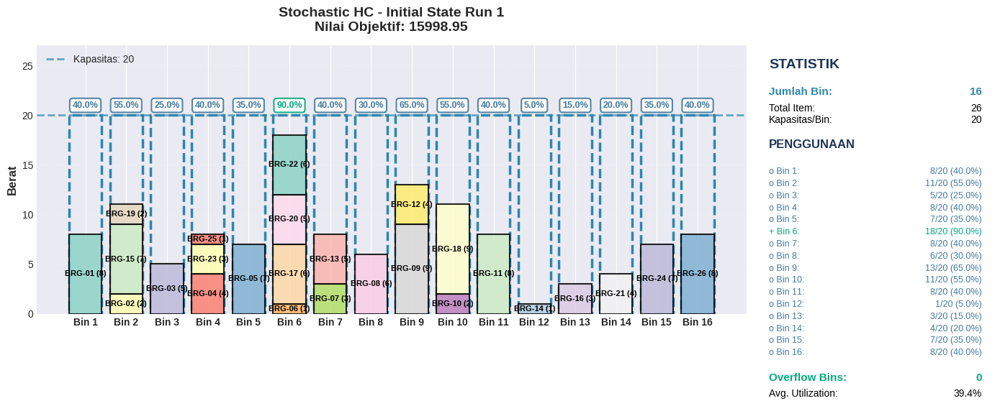

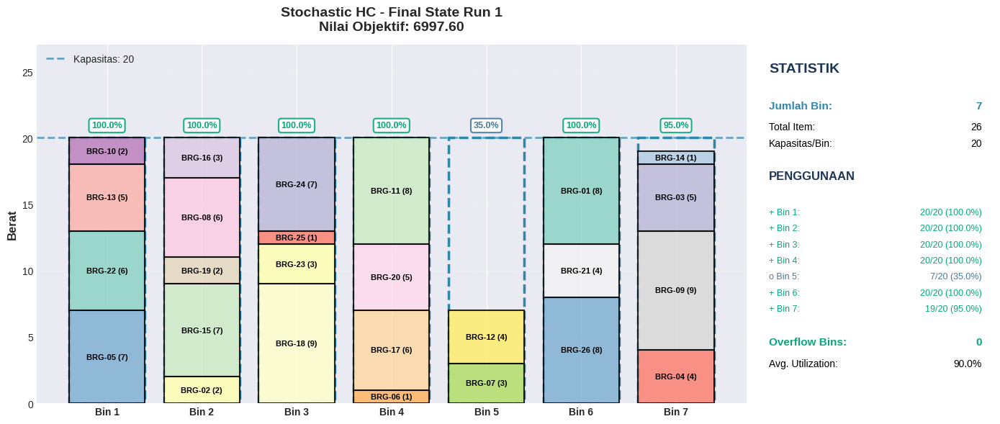

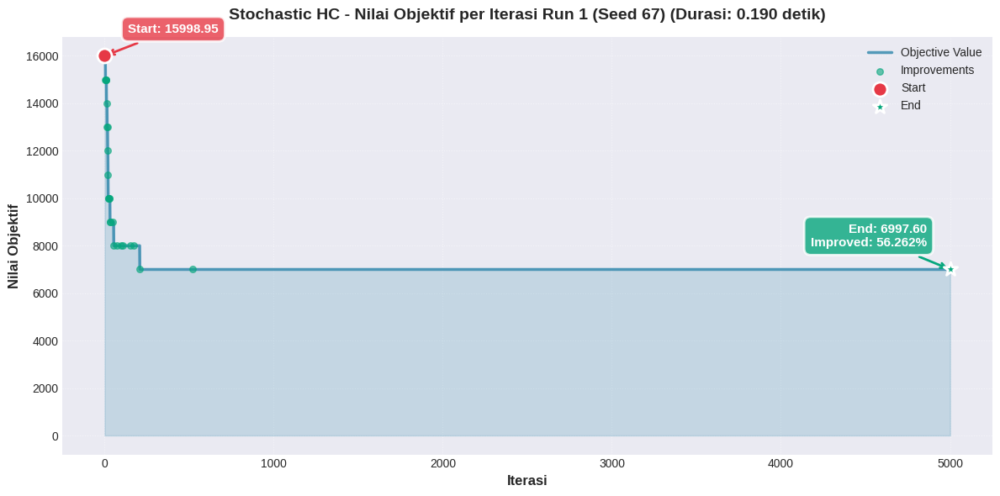


🏁 RUN 2 — Seed: 182 | Final Objective: 6997.58


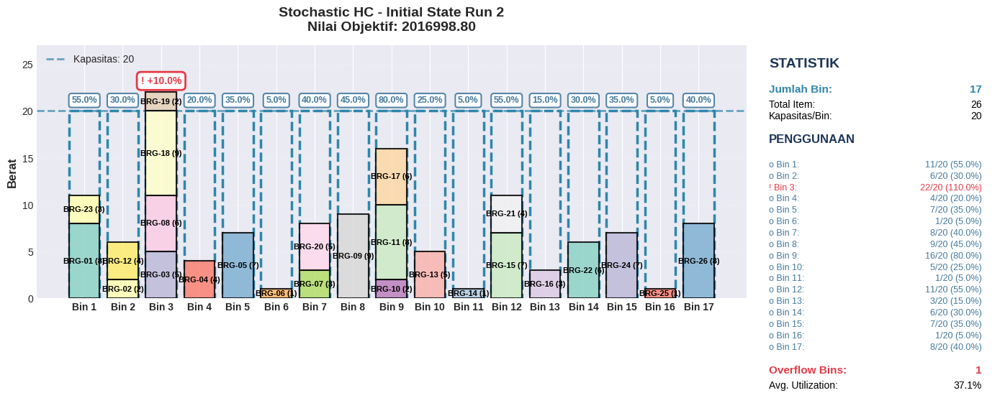

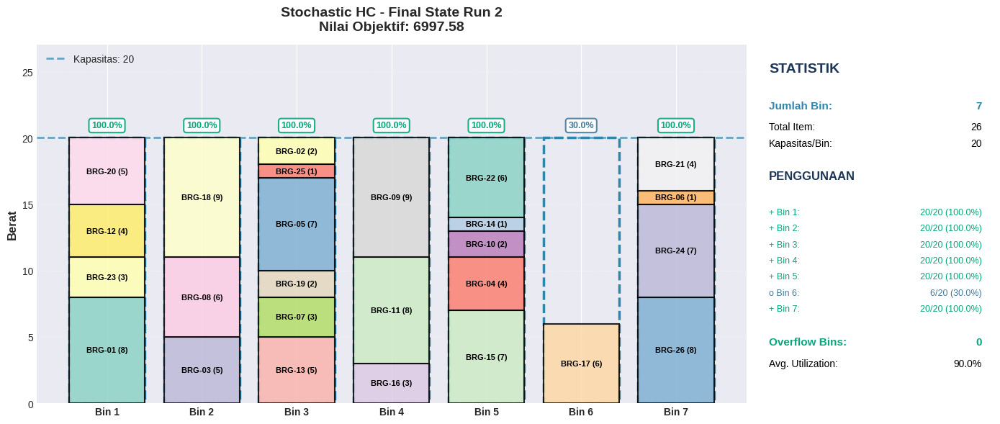

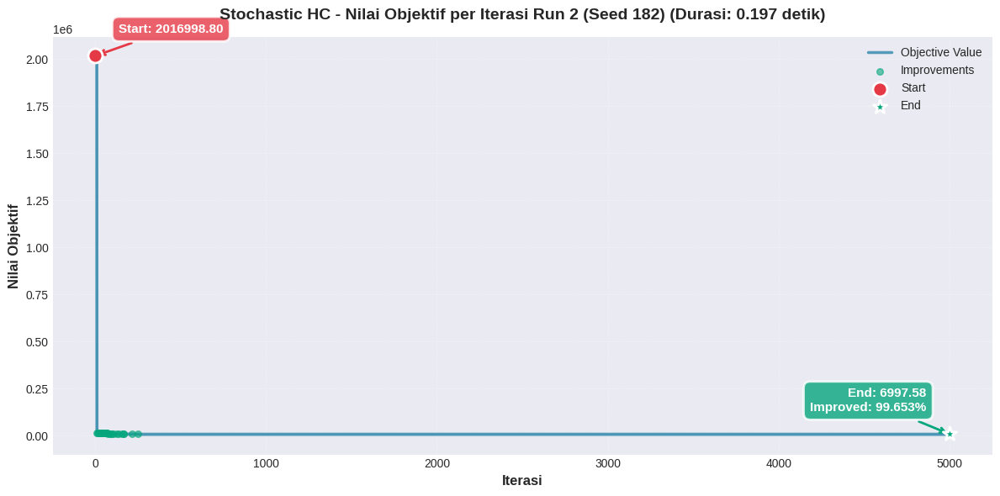


🏁 RUN 3 — Seed: 69 | Final Objective: 6997.58


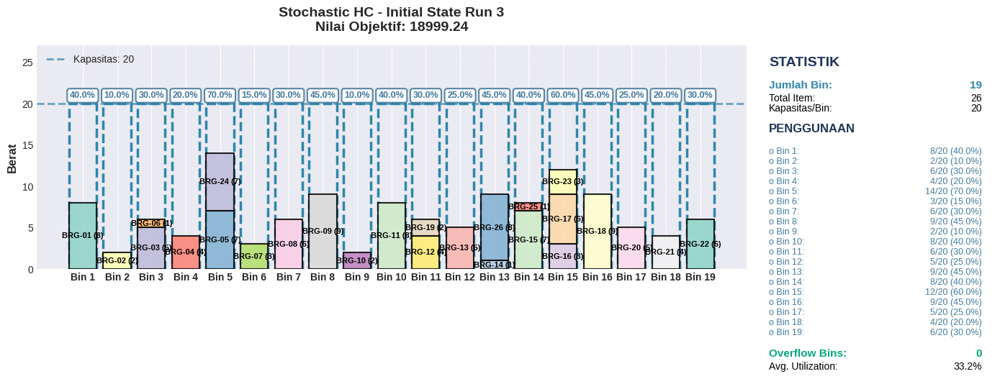

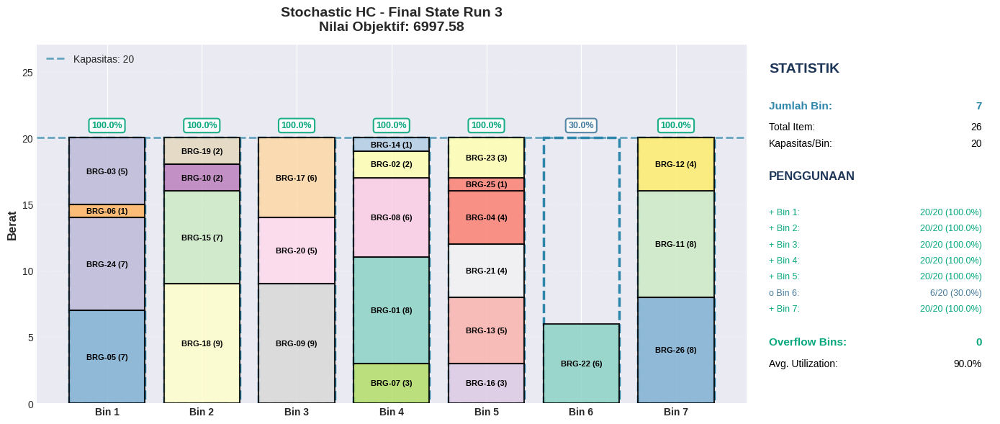

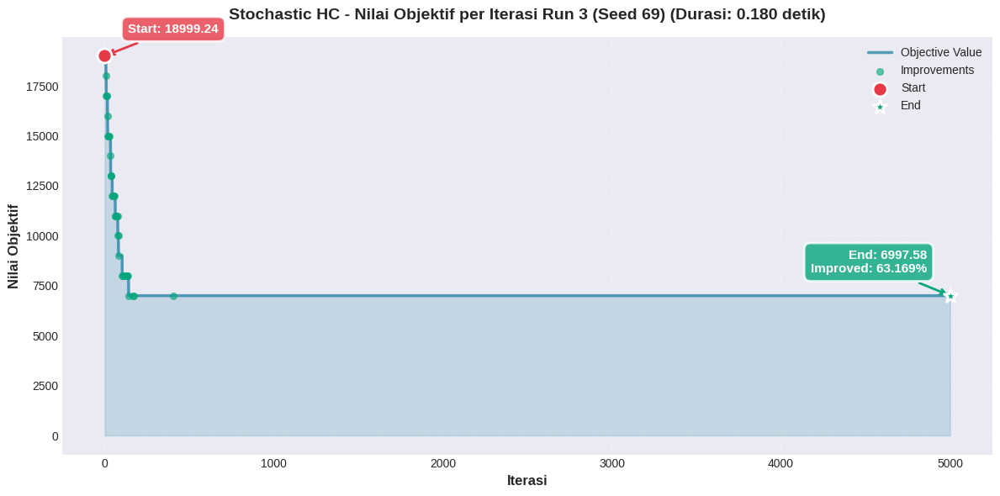

In [ ]:
print("\n VISUALISASI STOCHASTIC HILL CLIMBING")
for result in hc_results:
  run_id = result['run']
  final_obj = result['final_objective']

  print(f"\n🏁 RUN {run_id} — Seed: {result['seed']} | Final Objective: {final_obj:.2f}")

  Visualizer.visualize_state(
    result['initial_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"Stochastic HC - Initial State Run {run_id}",
  )

  Visualizer.visualize_state(
    result['final_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"Stochastic HC - Final State Run {run_id}"
  )

  Visualizer.plot_objective_values(
    result['history'],
    result['duration'],
    title=f"Stochastic HC - Nilai Objektif per Iterasi Run {run_id} (Seed {result['seed']})"
  )

1.2 Steepest Ascent Hill Climbing

In [ ]:
print("\n" + "=" * 60)
print("EKSPERIMEN 1.2: STEEPEST ASCENT HILL CLIMBING")
print("=" * 60)

hc_results = []
MAX_ITER_HC = 5000

for run_idx, seed in enumerate(SEEDS, 1):
    print(f"\n--- Run {run_idx} (Seed: {seed}) ---")

    initial_state, final_state, best_val, iterations_run, history, duration = SteepestHill.run(
        EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        max_iter=MAX_ITER_HC,
        seed=seed
    )

    result = {
        'run': run_idx,
        'seed': seed,
        'initial_state': initial_state,
        'final_state': final_state,
        'history': history,
        'final_objective': best_val,
        'duration': duration,
        'iterations': iterations_run
    }
    hc_results.append(result)

    print(f"Initial Objective: {history[0]:.2f}")
    print(f"Final Objective: {result['final_objective']:.2f}")
    improvement = ((history[0] - result['final_objective']) / history[0] * 100) if history[0] != 0 else 0
    print(f"Improvement: {improvement:.2f}%")
    print(f"Iterasi: {result['iterations']}")
    print(f"Durasi: {duration:.3f} detik")


print("\n" + "=" * 60)
print("RINGKASAN STEEPEST ASCENT HILL CLIMBING")
print("=" * 60)
final_objectives = [r['final_objective'] for r in hc_results]
durations = [r['duration'] for r in hc_results]
print(f"Objective Function Akhir:")
print(f"  Min: {min(final_objectives):.2f}")
print(f"  Max: {max(final_objectives):.2f}")
print(f"  Rata-rata: {np.mean(final_objectives):.2f}")
print(f"  Std Dev: {np.std(final_objectives):.2f}")
print(f"\nDurasi:")
print(f"  Rata-rata: {np.mean(durations):.3f} detik")
print("=" * 60)


EKSPERIMEN 1.2: STEEPEST ASCENT HILL CLIMBING

--- Run 1 (Seed: 67) ---
Initial Objective: 15998.95
Final Objective: 6997.58
Improvement: 56.26%
Iterasi: 12
Durasi: 0.732 detik

--- Run 2 (Seed: 182) ---
Initial Objective: 2016998.80
Final Objective: 6997.58
Improvement: 99.65%
Iterasi: 12
Durasi: 0.674 detik

--- Run 3 (Seed: 69) ---
Initial Objective: 18999.24
Final Objective: 6997.58
Improvement: 63.17%
Iterasi: 15
Durasi: 0.972 detik

RINGKASAN STEEPEST ASCENT HILL CLIMBING
Objective Function Akhir:
  Min: 6997.58
  Max: 6997.58
  Rata-rata: 6997.58
  Std Dev: 0.00

Durasi:
  Rata-rata: 0.793 detik



 VISUALISASI STEEPEST ASCENT HILL CLIMBING

🏁 RUN 1 — Seed: 67 | Final Objective: 6997.58


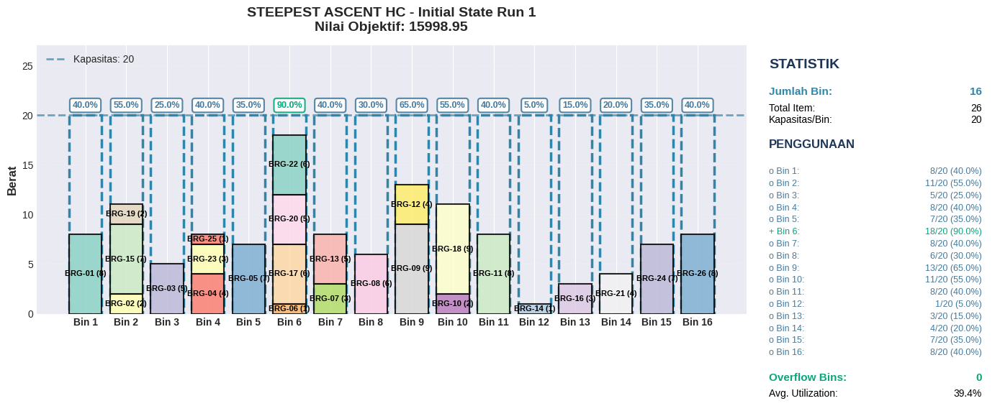

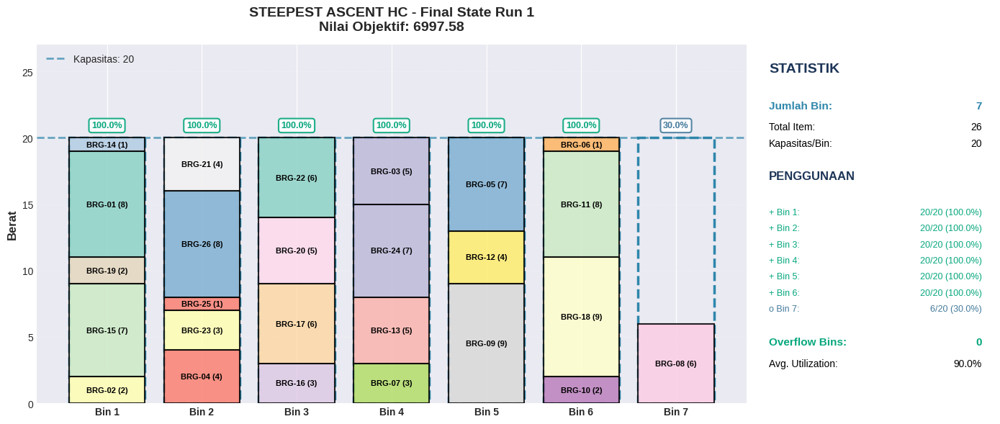

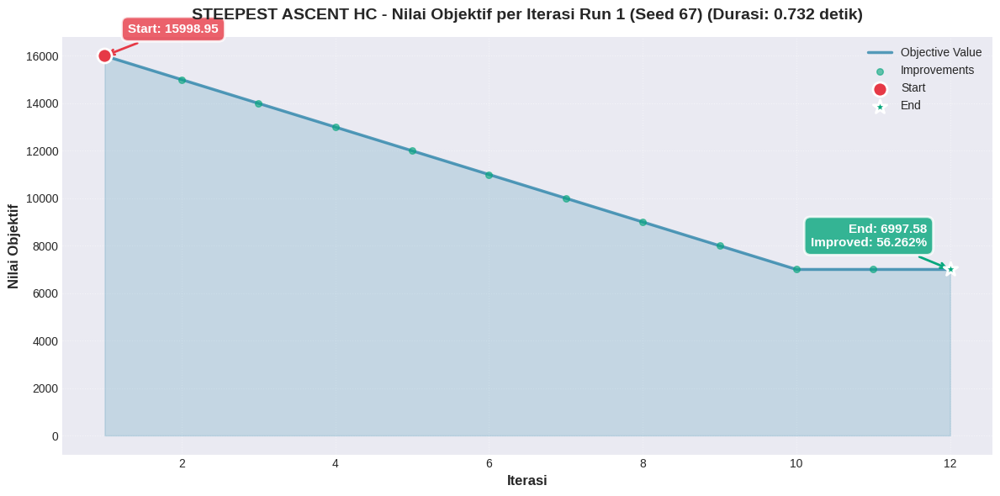


🏁 RUN 2 — Seed: 182 | Final Objective: 6997.58


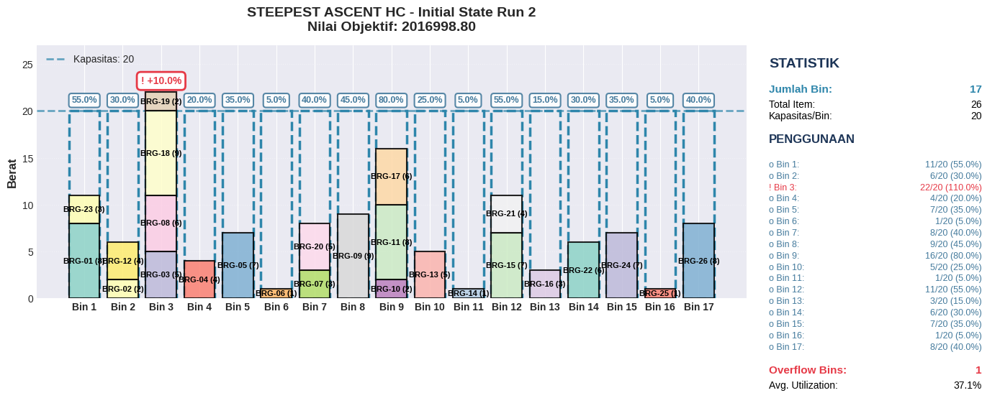

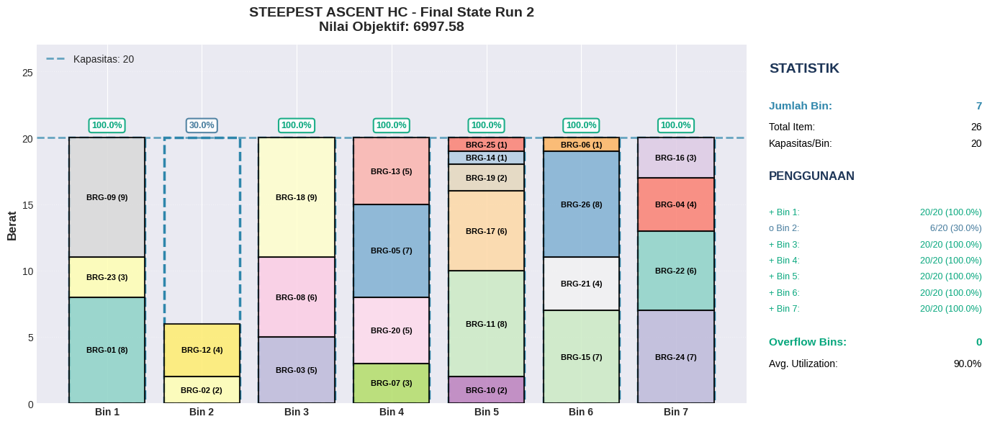

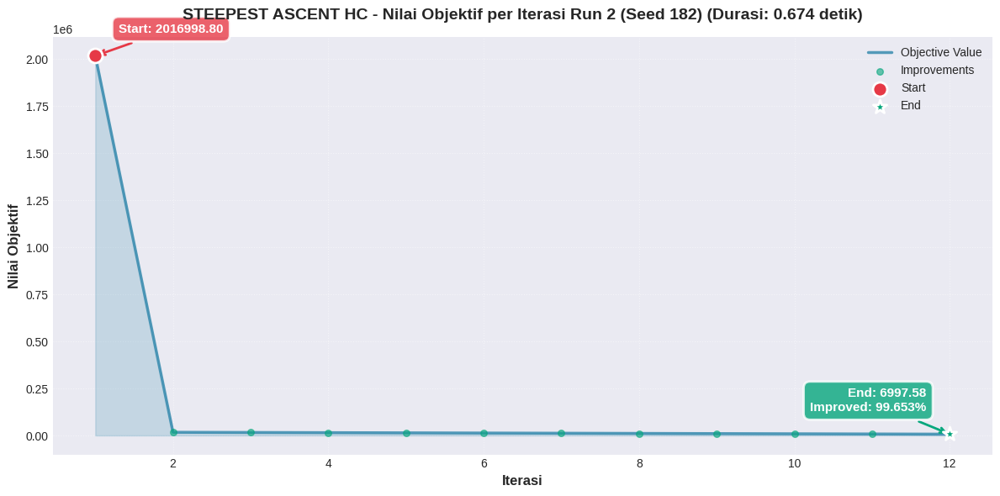


🏁 RUN 3 — Seed: 69 | Final Objective: 6997.58


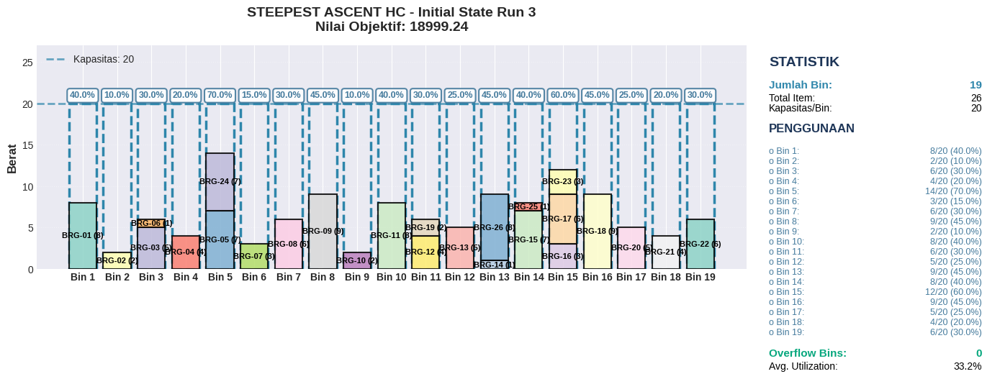

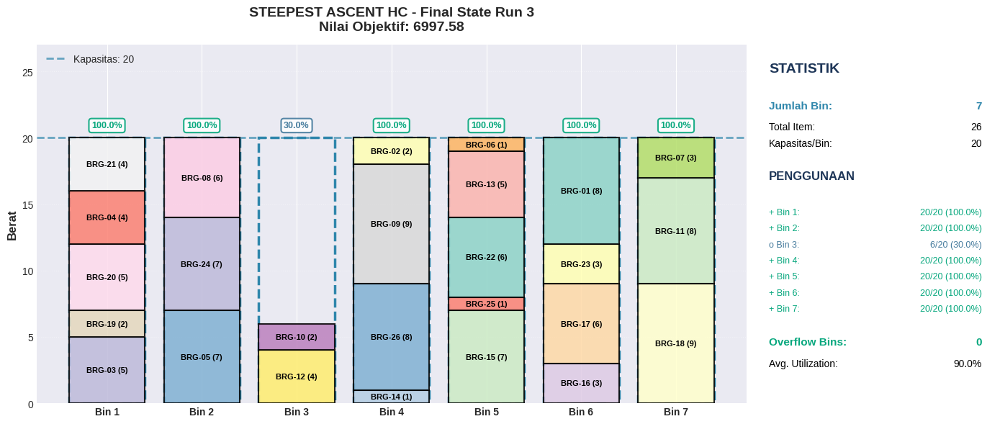

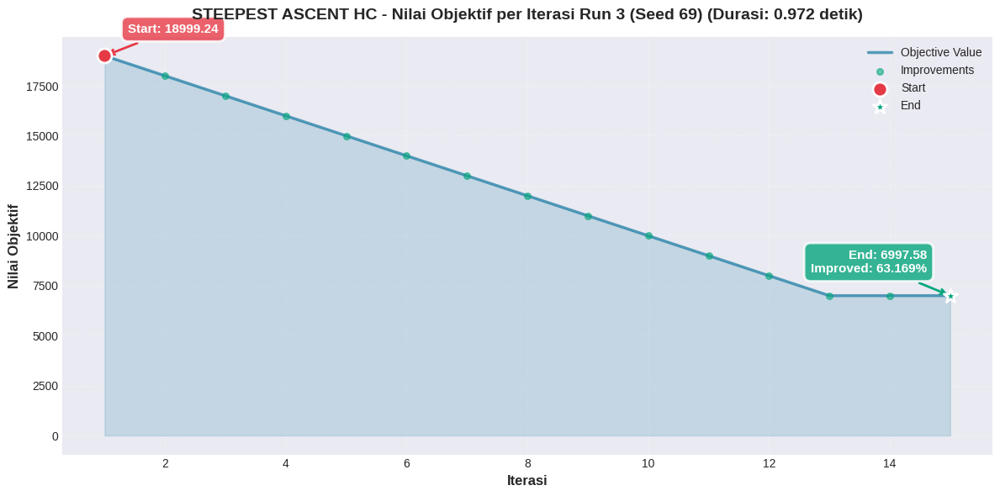

In [ ]:
print("\n VISUALISASI STEEPEST ASCENT HILL CLIMBING")

for result in hc_results:
  run_id = result['run']
  final_obj = result['final_objective']

  print(f"\n🏁 RUN {run_id} — Seed: {result['seed']} | Final Objective: {final_obj:.2f}")

  Visualizer.visualize_state(
    result['initial_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"STEEPEST ASCENT HC - Initial State Run {run_id}",
  )

  Visualizer.visualize_state(
    result['final_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"STEEPEST ASCENT HC - Final State Run {run_id}"
  )

  Visualizer.plot_objective_values(
    result['history'],
    result['duration'],
    title=f"STEEPEST ASCENT HC - Nilai Objektif per Iterasi Run {run_id} (Seed {result['seed']})"
  )

1.3 Hill Climbing With Sideways Move

In [ ]:
print("\n" + "=" * 60)
print("EKSPERIMEN 1.3: HILL CLIMBING WITH SIDEWAYS MOVE")
print("=" * 60)

hc_results = []
MAX_ITER_HC = 5000

for run_idx, seed in enumerate(SEEDS, 1):
    print(f"\n--- Run {run_idx} (Seed: {seed}) ---")

    initial_state, final_state, best_val, iterations_run, history, duration = SteepestHill.run(
        EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        max_iter=MAX_ITER_HC,
        seed=seed
    )

    result = {
        'run': run_idx,
        'seed': seed,
        'initial_state': initial_state,
        'final_state': final_state,
        'history': history,
        'final_objective': best_val,
        'duration': duration,
        'iterations': iterations_run
    }
    hc_results.append(result)

    print(f"Initial Objective: {history[0]:.2f}")
    print(f"Final Objective: {result['final_objective']:.2f}")
    improvement = ((history[0] - result['final_objective']) / history[0] * 100) if history[0] != 0 else 0
    print(f"Improvement: {improvement:.2f}%")
    print(f"Iterasi: {result['iterations']}")
    print(f"Durasi: {duration:.3f} detik")


print("\n" + "=" * 60)
print("RINGKASAN STEEPEST ASCENT HILL CLIMBING")
print("=" * 60)
final_objectives = [r['final_objective'] for r in hc_results]
durations = [r['duration'] for r in hc_results]
print(f"Objective Function Akhir:")
print(f"  Min: {min(final_objectives):.2f}")
print(f"  Max: {max(final_objectives):.2f}")
print(f"  Rata-rata: {np.mean(final_objectives):.2f}")
print(f"  Std Dev: {np.std(final_objectives):.2f}")
print(f"\nDurasi:")
print(f"  Rata-rata: {np.mean(durations):.3f} detik")
print("=" * 60)


EKSPERIMEN 1.3: HILL CLIMBING WITH SIDEWAYS MOVE

--- Run 1 (Seed: 67) ---
Initial Objective: 15998.95
Final Objective: 6997.58
Improvement: 56.26%
Iterasi: 12
Durasi: 0.481 detik

--- Run 2 (Seed: 182) ---
Initial Objective: 2016998.80
Final Objective: 6997.58
Improvement: 99.65%
Iterasi: 12
Durasi: 0.434 detik

--- Run 3 (Seed: 69) ---
Initial Objective: 18999.24
Final Objective: 6997.58
Improvement: 63.17%
Iterasi: 15
Durasi: 0.621 detik

RINGKASAN STEEPEST ASCENT HILL CLIMBING
Objective Function Akhir:
  Min: 6997.58
  Max: 6997.58
  Rata-rata: 6997.58
  Std Dev: 0.00

Durasi:
  Rata-rata: 0.512 detik



 HILL CLIMBING WITH SIDEWAYS MOVE

🏁 RUN 1 — Seed: 67 | Final Objective: 6997.58


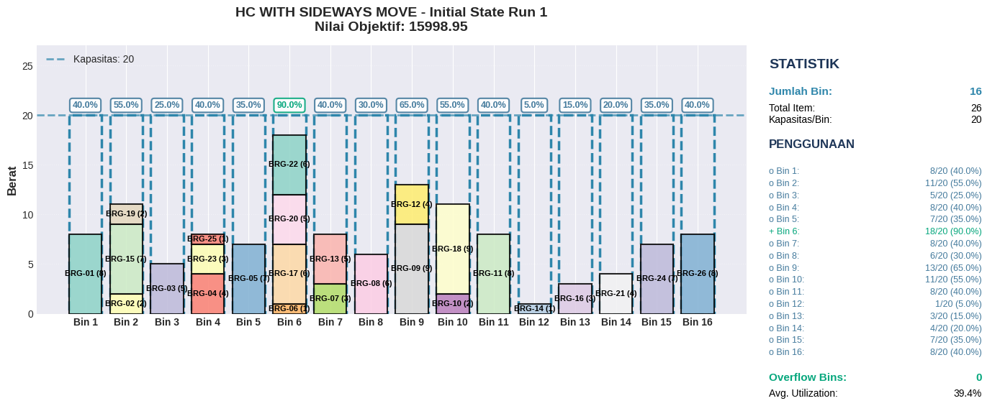

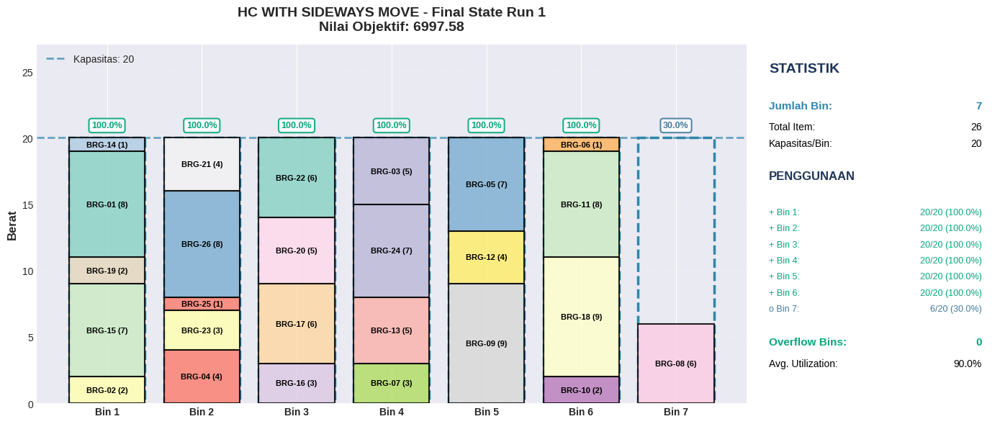

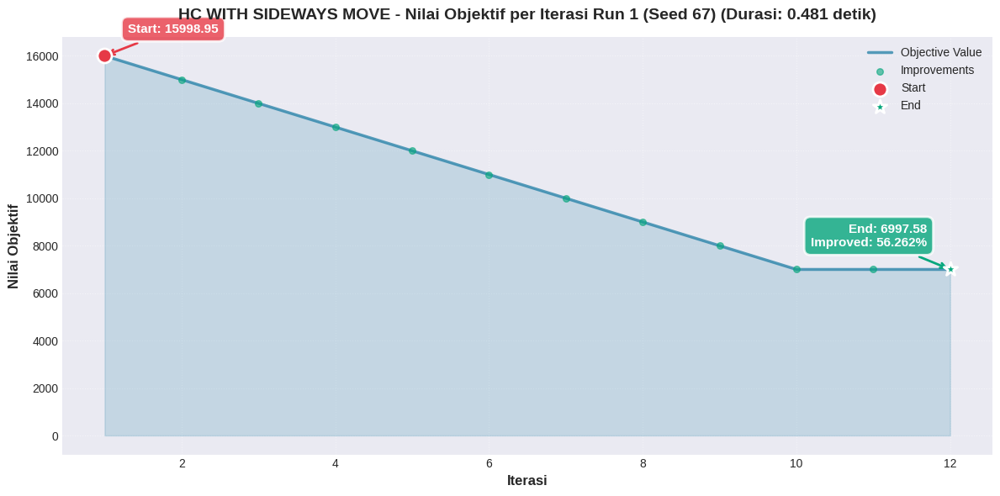


🏁 RUN 2 — Seed: 182 | Final Objective: 6997.58


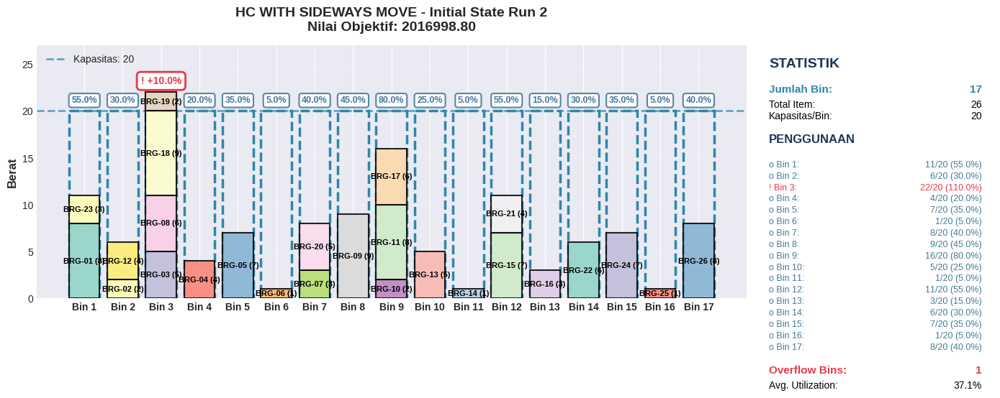

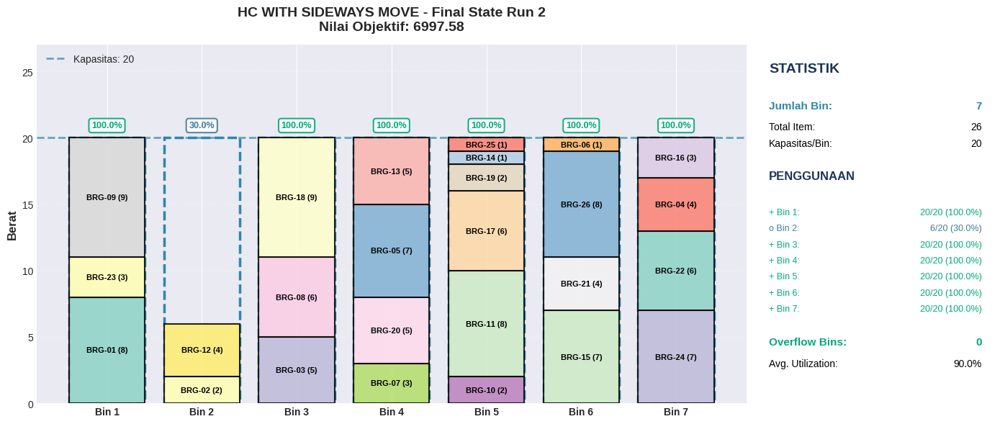

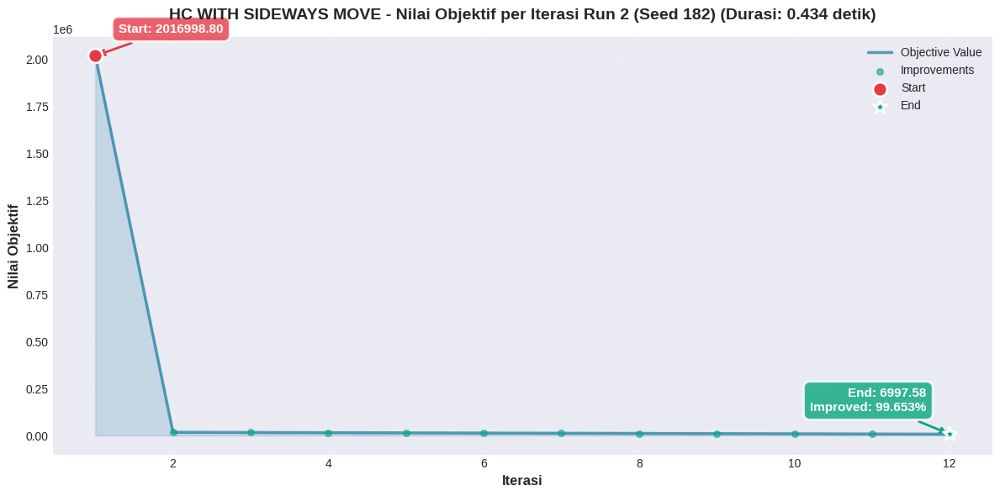


🏁 RUN 3 — Seed: 69 | Final Objective: 6997.58


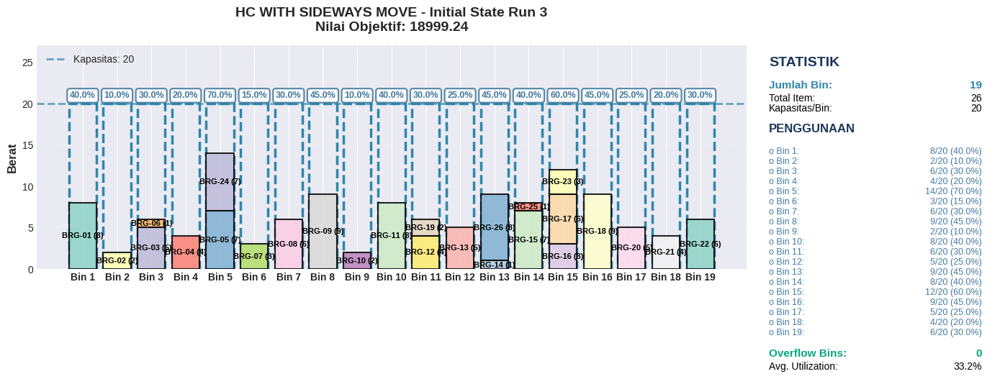

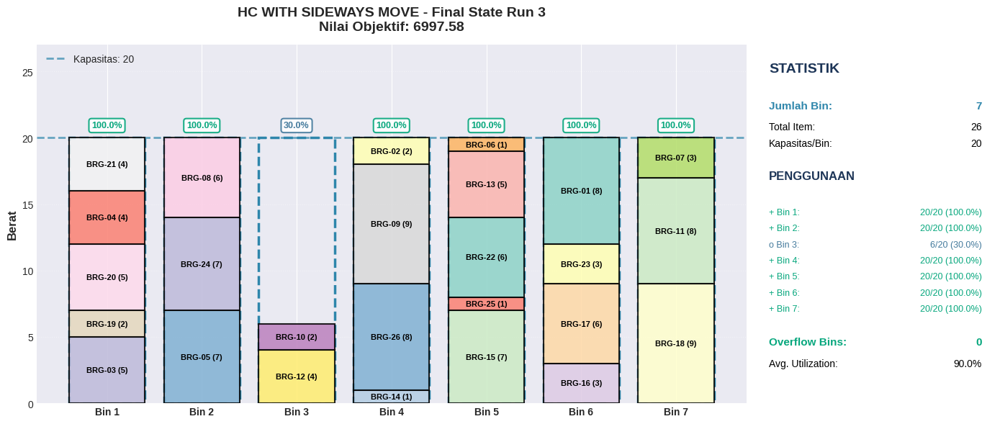

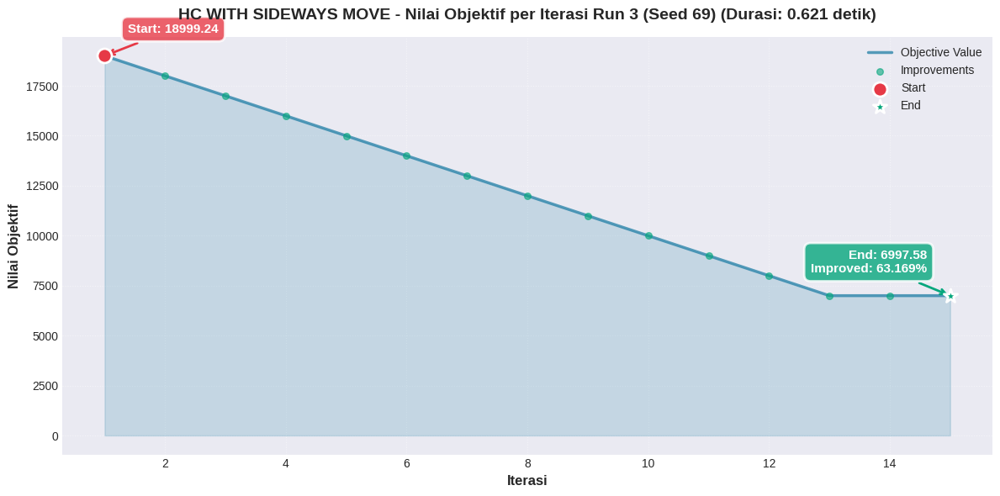

In [ ]:
print("\n HILL CLIMBING WITH SIDEWAYS MOVE")

for result in hc_results:
  run_id = result['run']
  final_obj = result['final_objective']

  print(f"\n🏁 RUN {run_id} — Seed: {result['seed']} | Final Objective: {final_obj:.2f}")

  Visualizer.visualize_state(
    result['initial_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"HC WITH SIDEWAYS MOVE - Initial State Run {run_id}",
  )

  Visualizer.visualize_state(
    result['final_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"HC WITH SIDEWAYS MOVE - Final State Run {run_id}"
  )

  Visualizer.plot_objective_values(
    result['history'],
    result['duration'],
    title=f"HC WITH SIDEWAYS MOVE - Nilai Objektif per Iterasi Run {run_id} (Seed {result['seed']})"
  )

Random Restart

In [ ]:
print("\n" + "=" * 60)
print("EKSPERIMEN 1.4: RANDOM RESTART HILL CLIMBING")
print("=" * 60)

rr_results = []
MAX_RESTARTS = 20
ITERS_PER_RESTART = 500

for run_idx, seed in enumerate(SEEDS, 1):
    print(f"\n--- Run {run_idx} (Seed: {seed}) ---")

    np.random.seed(seed)
    random.seed(seed)

    initial_state, final_state, best_val, restarts_done, total_iters, restart_objectives, best_history, duration, all_histories, per_restart_iters = RandomRestartHill.run(
        EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        max_restarts=MAX_RESTARTS,
        iters_per_restart=ITERS_PER_RESTART,
        allow_new_bin=True
    )
    initial_obj_from_state = BinPackingBase.objective_fun(initial_state, EXPERIMENT_CAPACITY, EXPERIMENT_ITEMS)

    result = {
        'run': run_idx,
        'seed': seed,
        'initial_state': initial_state,
        'final_state': final_state,
        'restart_objectives': restart_objectives,
        'final_objective': best_val,
        'best_val': best_val,
        'restarts_done': restarts_done,
        'total_iters': total_iters,
        'duration': duration,
        'all_histories': all_histories,
        'per_restart_iters': per_restart_iters,
        'best_history': best_history,
        'initial_obj_from_state': initial_obj_from_state

    }
    rr_results.append(result)

    print(f"Initial Objective: {initial_obj_from_state:.2f}")
    print(f"Final Objective: {result['final_objective']:.2f}")
    print(f"Total Iterasi: {total_iters}")
    print(f"Durasi: {duration:.3f} detik")
    print(f"Jumlah Restart: {restarts_done}")
    print(f"Iterasi per Restart: {per_restart_iters}")

    # print(f"Objective Terbaik: {best_val:.2f}")
    # print(f"Objective Tiap Restart: {['%.2f' % v for v in restart_objectives]}")


print("\n" + "=" * 60)
print("RINGKASAN RANDOM RESTART HILL CLIMBING")
print("=" * 60)

final_objectives = [r['best_val'] for r in rr_results]
durations = [r['duration'] for r in rr_results]
total_iters_list = [r['total_iters'] for r in rr_results]

print(f"Objective Function Akhir:")
print(f"  Min: {min(final_objectives):.2f}")
print(f"  Max: {max(final_objectives):.2f}")
print(f"  Rata-rata: {np.mean(final_objectives):.2f}")
print(f"  Std Dev: {np.std(final_objectives):.2f}")
print(f"\nIterasi Total:")
print(f"  Rata-rata: {np.mean(total_iters_list):.1f}")
print(f"  Std Dev: {np.std(total_iters_list):.1f}")
print(f"\nDurasi:")
print(f"  Rata-rata: {np.mean(durations):.3f} detik")
print(f"  Std Dev: {np.std(durations):.3f} detik")
print("=" * 60)



EKSPERIMEN 1.4: RANDOM RESTART HILL CLIMBING

--- Run 1 (Seed: 67) ---
Initial Objective: 19999.00
Final Objective: 6997.58
Total Iterasi: 232
Durasi: 8.658 detik
Jumlah Restart: 20
Iterasi per Restart: [12, 14, 13, 12, 14, 15, 15, 14, 12, 10, 12, 14, 14, 11, 11, 9, 13, 12, 11, 14]

--- Run 2 (Seed: 182) ---
Initial Objective: 17999.15
Final Objective: 6997.58
Total Iterasi: 238
Durasi: 9.545 detik
Jumlah Restart: 20
Iterasi per Restart: [12, 14, 14, 11, 15, 9, 12, 10, 14, 14, 14, 12, 13, 12, 12, 14, 15, 13, 13, 15]

--- Run 3 (Seed: 69) ---
Initial Objective: 18999.06
Final Objective: 6997.58
Total Iterasi: 230
Durasi: 9.030 detik
Jumlah Restart: 20
Iterasi per Restart: [15, 14, 11, 13, 12, 14, 12, 13, 15, 11, 11, 13, 11, 12, 13, 12, 12, 13, 10, 13]

RINGKASAN RANDOM RESTART HILL CLIMBING
Objective Function Akhir:
  Min: 6997.58
  Max: 6997.58
  Rata-rata: 6997.58
  Std Dev: 0.00

Iterasi Total:
  Rata-rata: 233.3
  Std Dev: 3.4

Durasi:
  Rata-rata: 9.078 detik
  Std Dev: 0.364 deti


 RANDOM RESTART HILL CLIMBING

🏁 RUN 1 — Seed: 67 | Final Objective: 6997.58


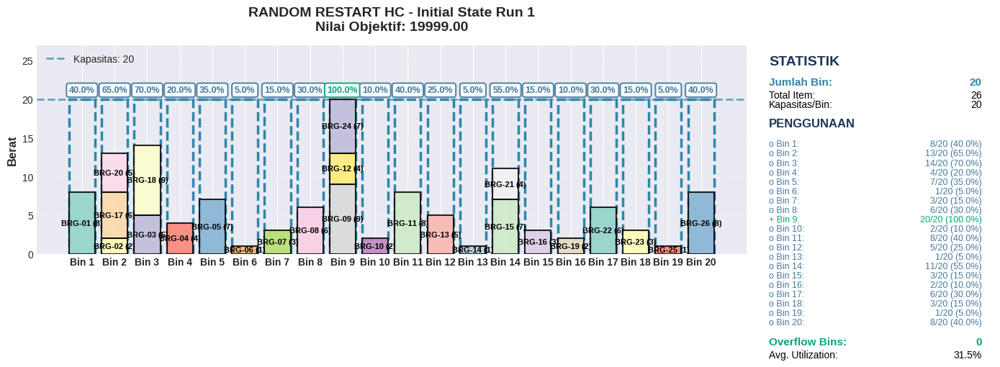

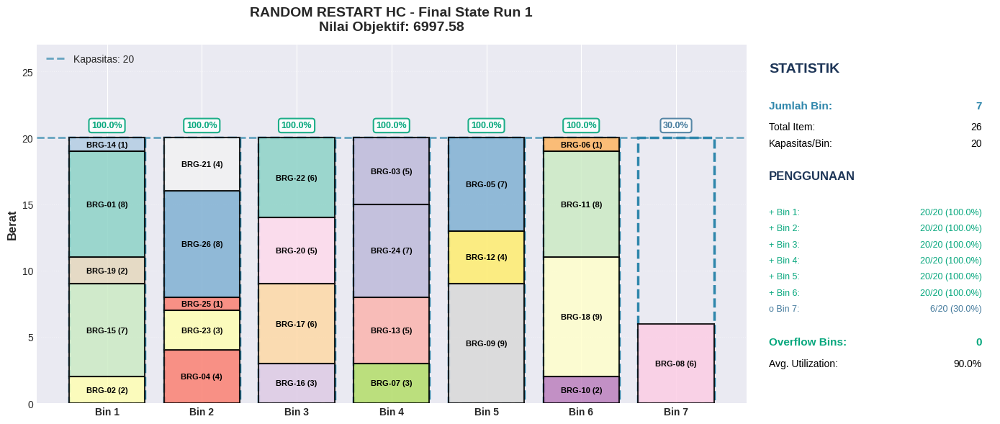

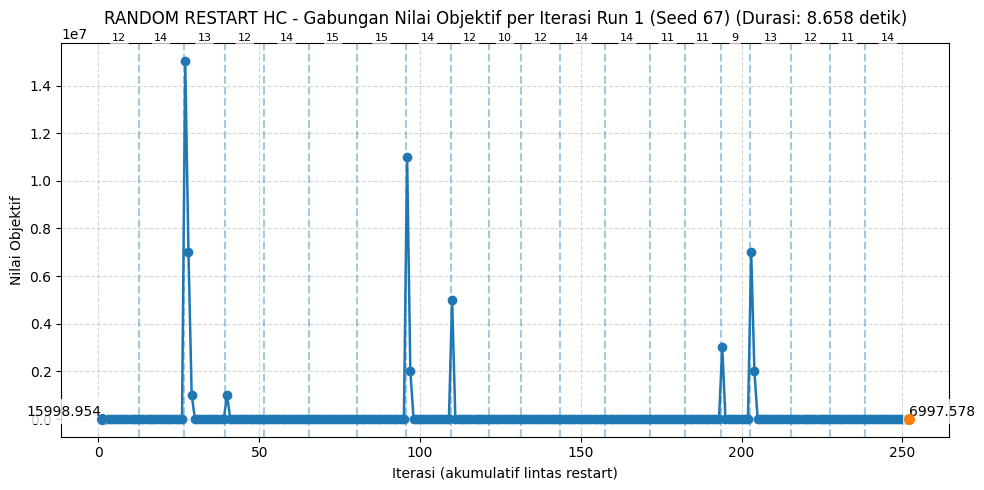


🏁 RUN 2 — Seed: 182 | Final Objective: 6997.58


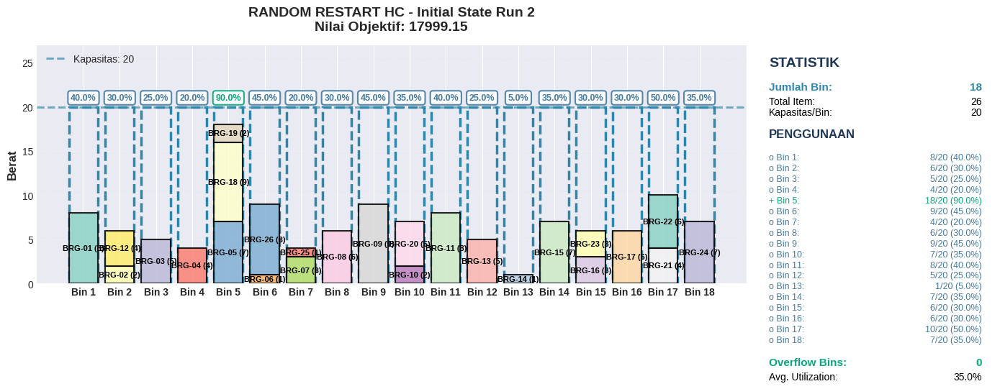

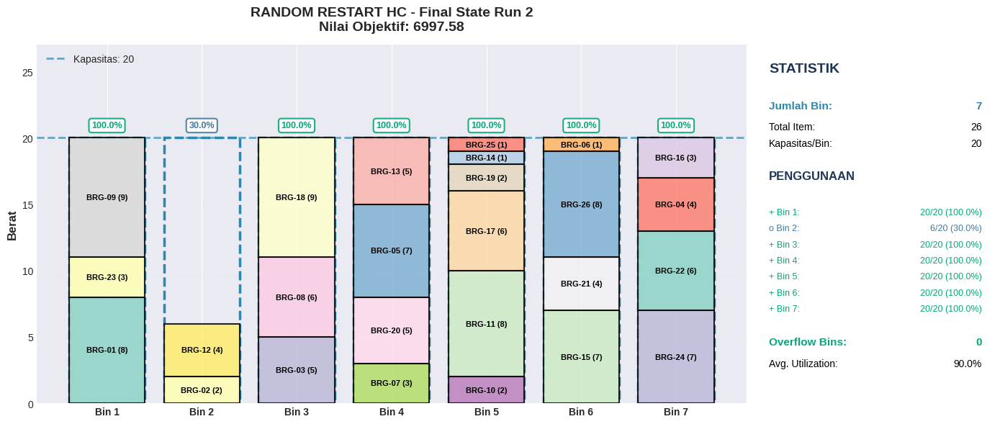

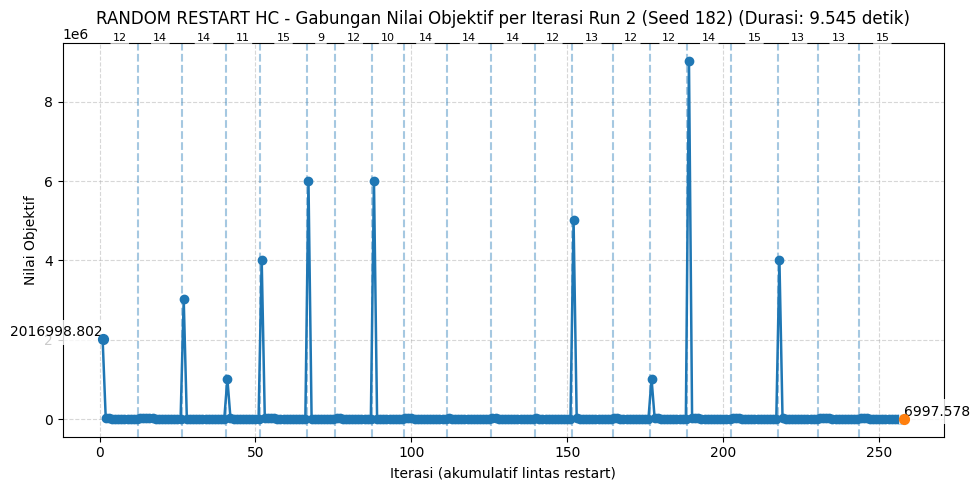


🏁 RUN 3 — Seed: 69 | Final Objective: 6997.58


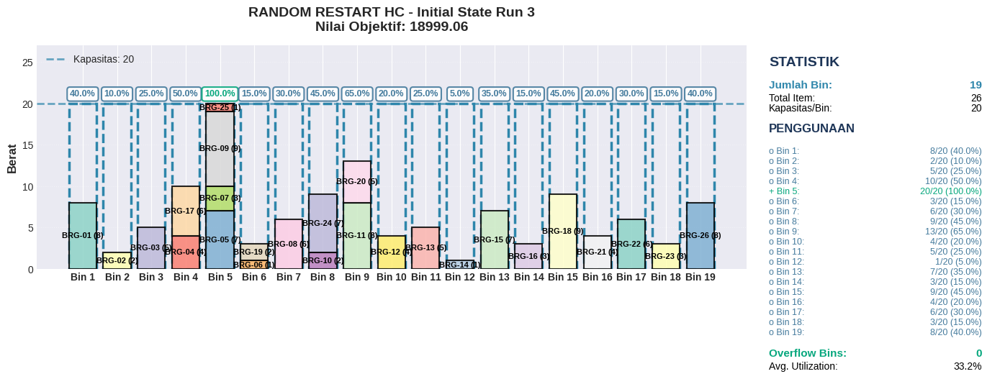

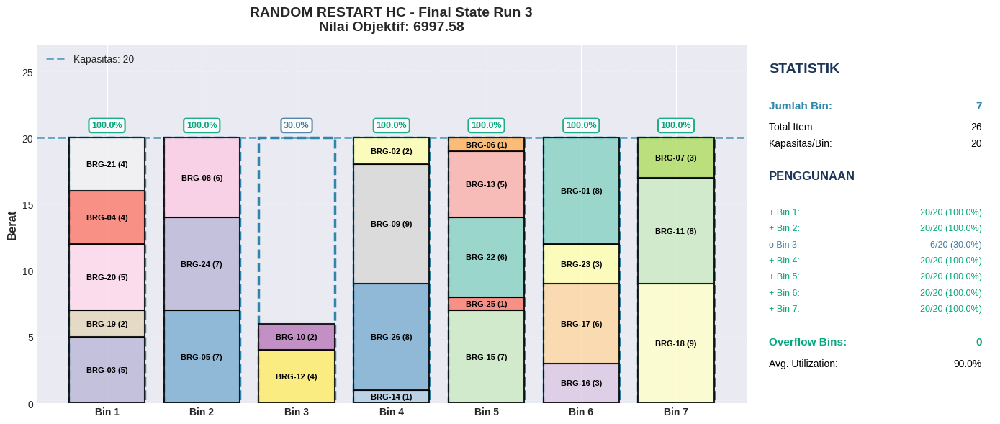

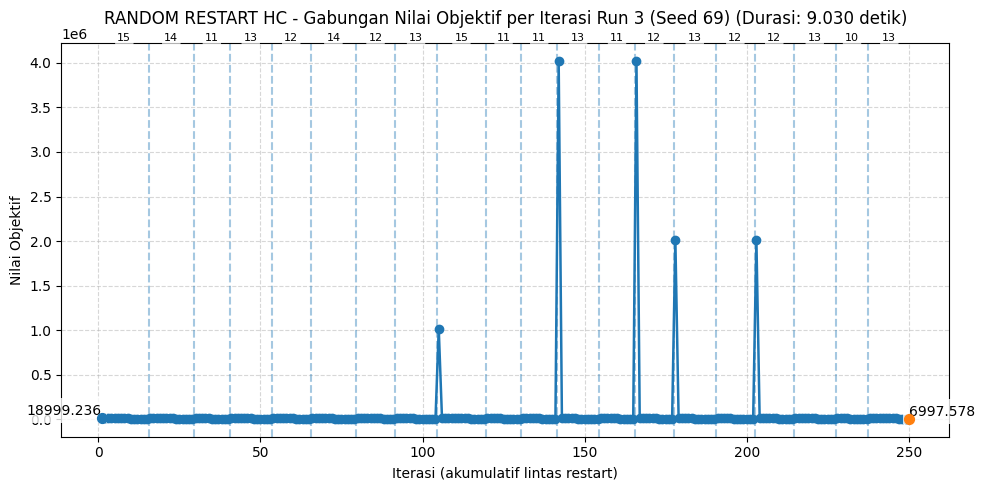

In [ ]:
print("\n RANDOM RESTART HILL CLIMBING")

for result in rr_results:
  run_id = result['run']
  seed = result['seed']
  final_obj = result['best_val']

  print(f"\n🏁 RUN {run_id} — Seed: {seed} | Final Objective: {final_obj:.2f}")

  Visualizer.visualize_state(
    result['initial_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"RANDOM RESTART HC - Initial State Run {run_id}"
  )

  Visualizer.visualize_state(
    result['final_state'],
    EXPERIMENT_ITEMS,
    EXPERIMENT_CAPACITY,
    f"RANDOM RESTART HC - Final State Run {run_id}"
  )

  RandomRestartHill.plot_objective_all_histories(
    result['all_histories'],
    duration=result['duration'],
    title=f"RANDOM RESTART HC - Gabungan Nilai Objektif per Iterasi Run {run_id} (Seed {seed})"
  )


## **EKSPERIMEN 2: Simulated Annealing**

**Metrik yang dicatat:**
- State awal dan akhir
- Nilai objective function akhir
- Plot objective function vs iterasi
- Durasi pencarian
- **Plot e^(-ΔE/T) vs iterasi**
- **Frekuensi 'stuck' di local optima**


EKSPERIMEN 2: SIMULATED ANNEALING

--- Run 1 (Seed: 67) ---
Initial Objective: 25007996.99
Final Objective: 6997.72
Improvement: 99.97%
Iterasi: 1981
Durasi: 0.101 detik
Stuck Episodes: 0
Stuck Fraction: 99.39%
Accepted Worse Moves: 705


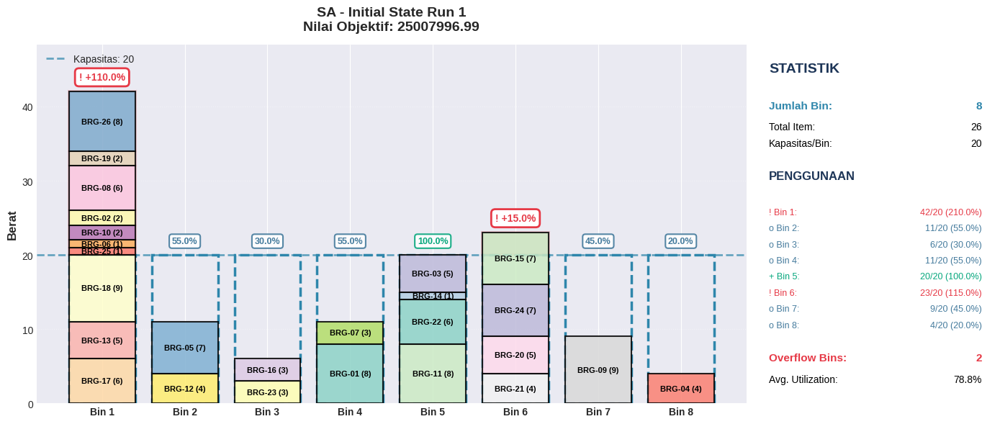

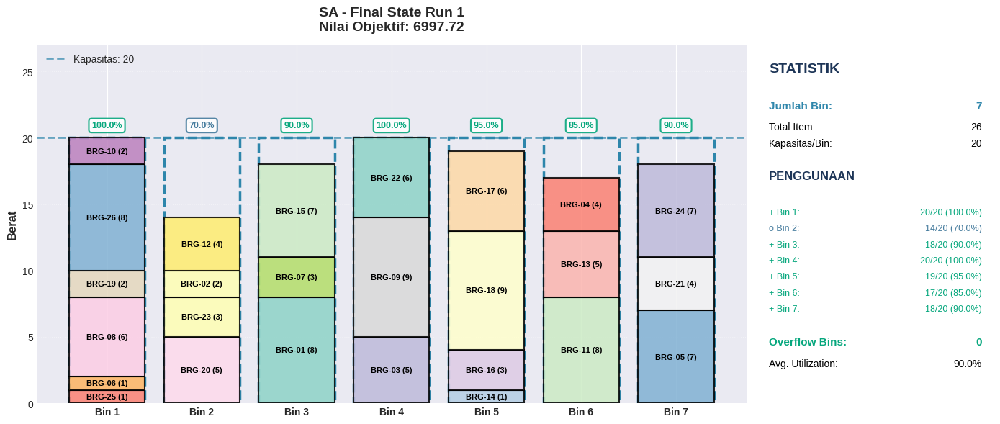

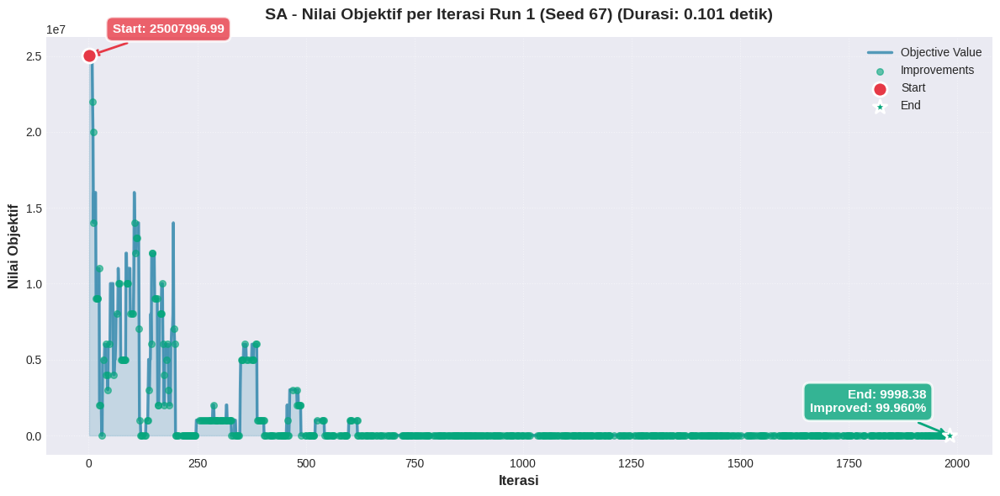

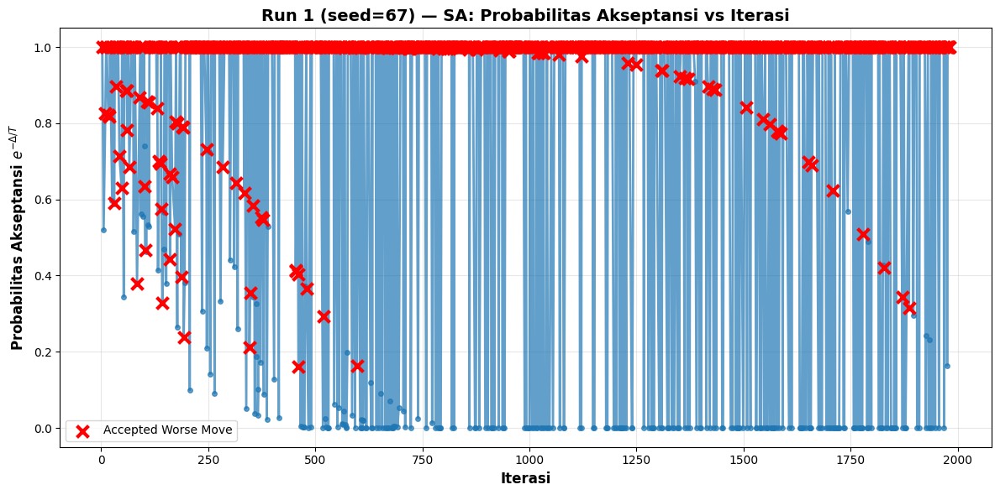

Tidak ada suhu valid untuk divisualisasikan.


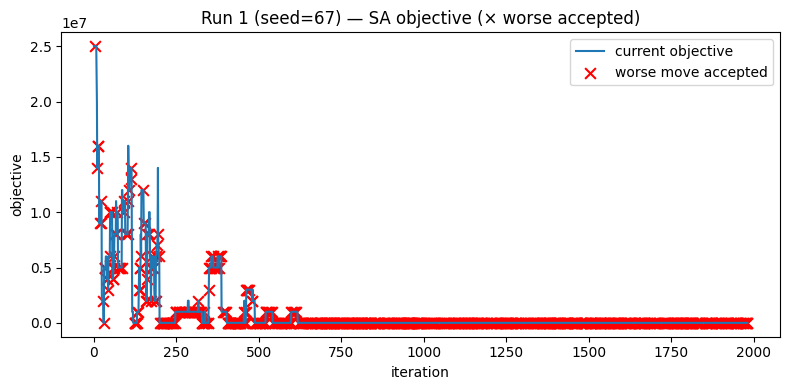

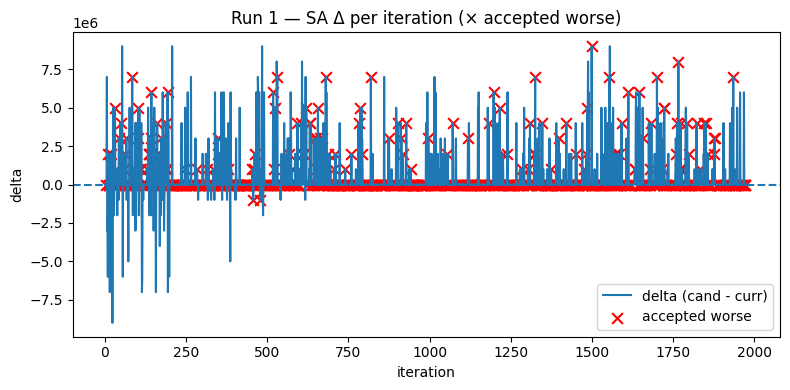


--- Run 2 (Seed: 182) ---
Initial Objective: 39006995.63
Final Objective: 6997.60
Improvement: 99.98%
Iterasi: 5000
Durasi: 0.263 detik
Stuck Episodes: 9
Stuck Fraction: 98.92%
Accepted Worse Moves: 1052


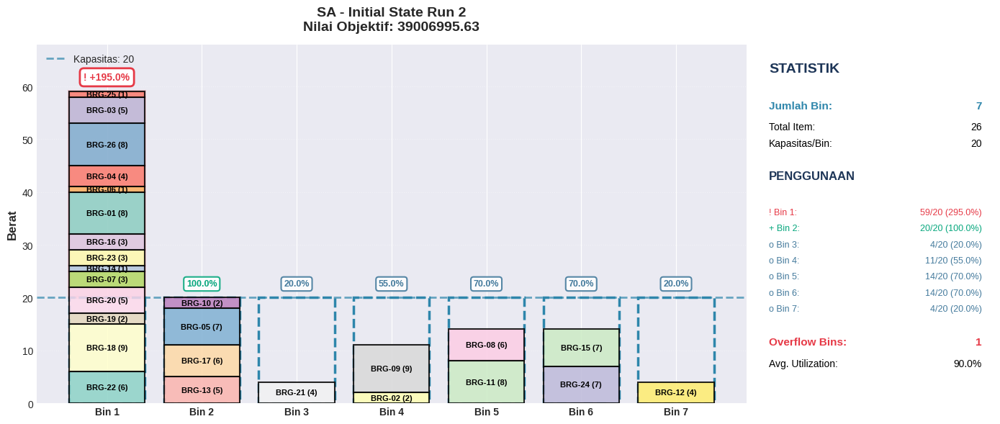

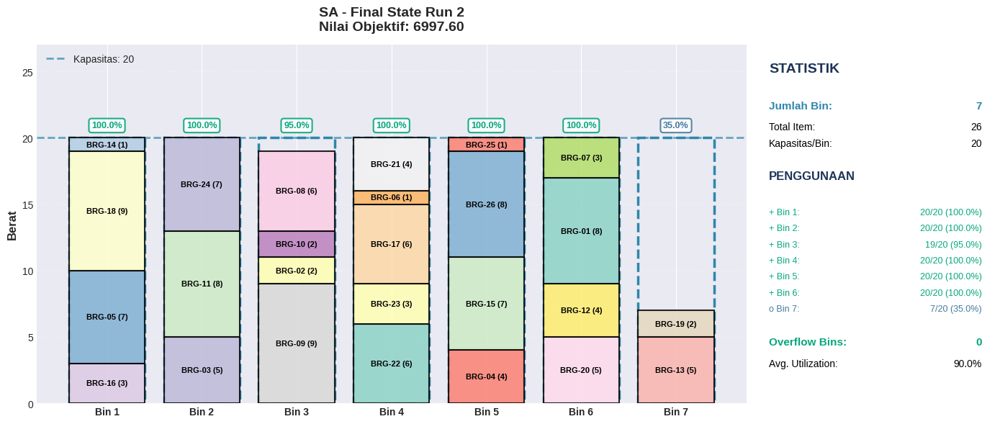

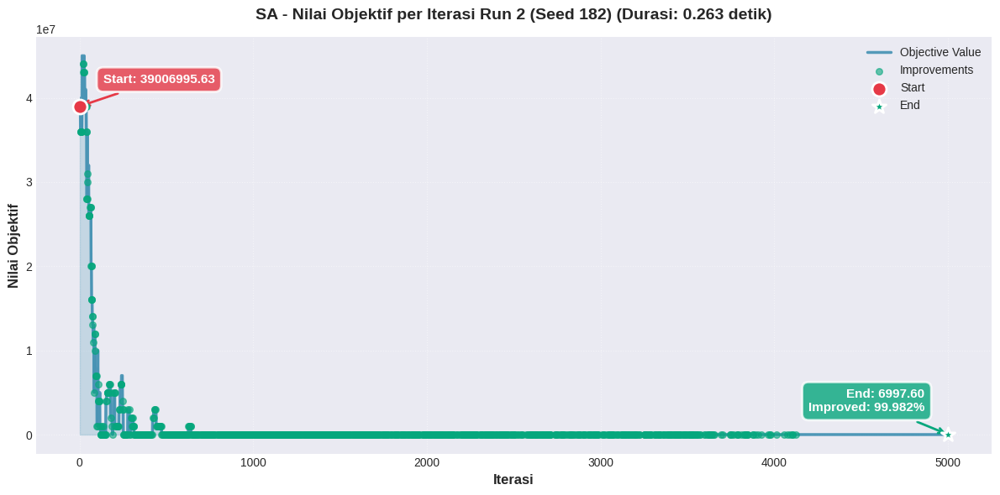

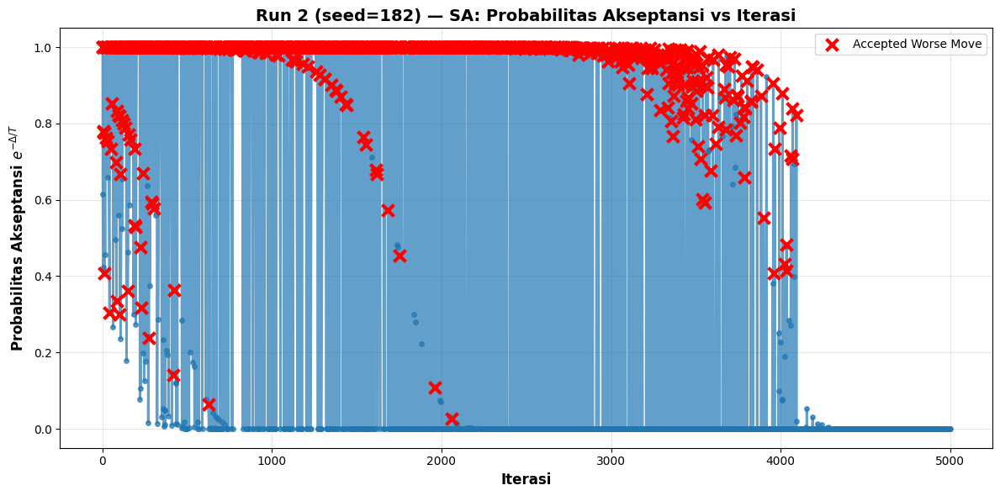

Tidak ada suhu valid untuk divisualisasikan.


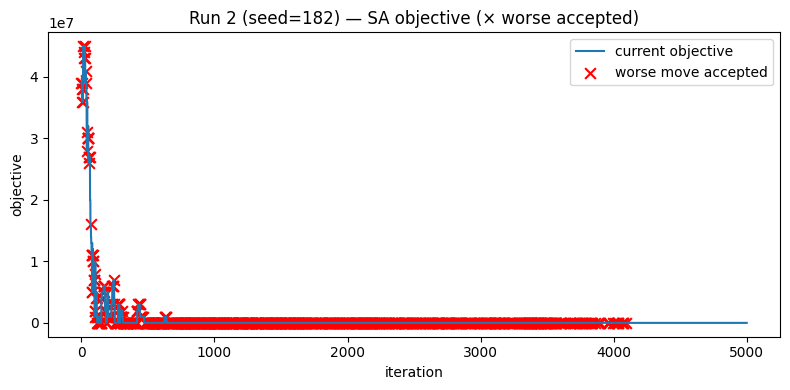

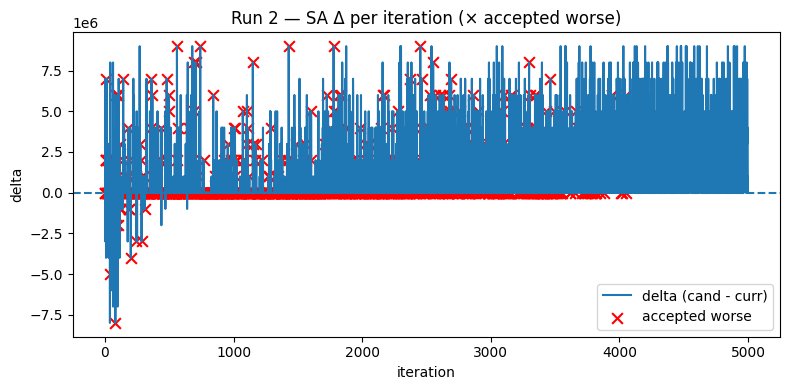


--- Run 3 (Seed: 69) ---
Initial Objective: 25008997.23
Final Objective: 6997.58
Improvement: 99.97%
Iterasi: 5000
Durasi: 0.243 detik
Stuck Episodes: 6
Stuck Fraction: 99.22%
Accepted Worse Moves: 1101


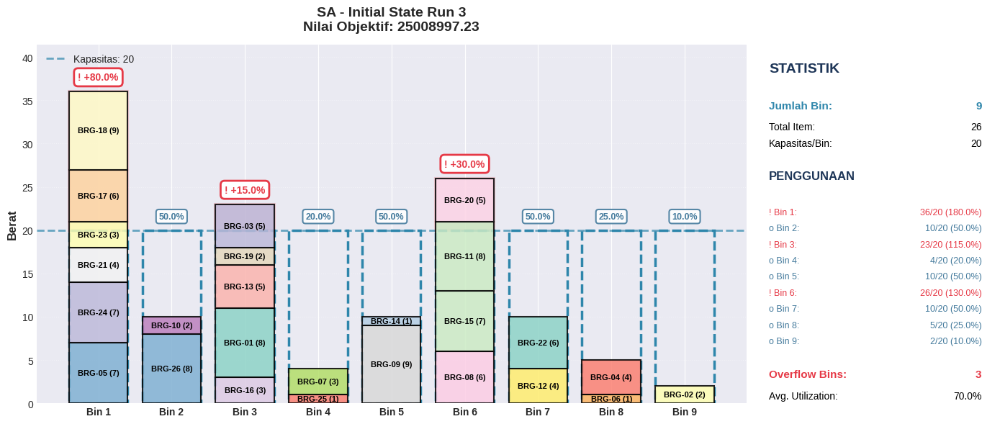

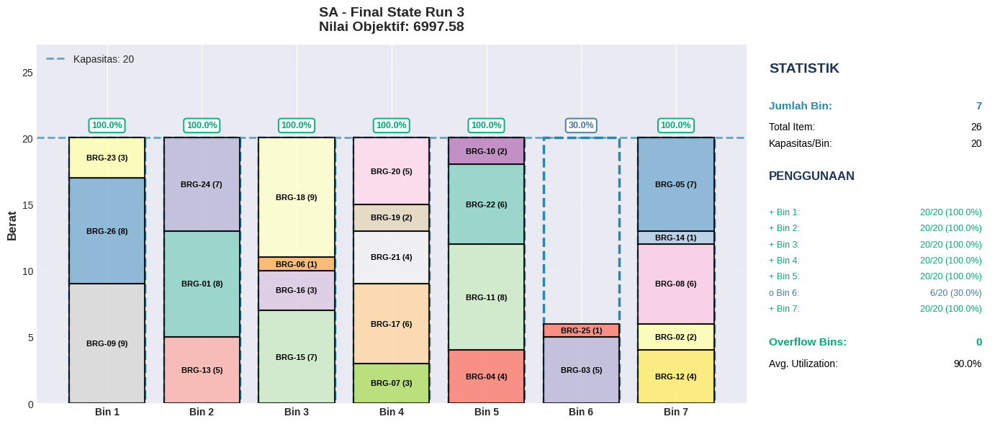

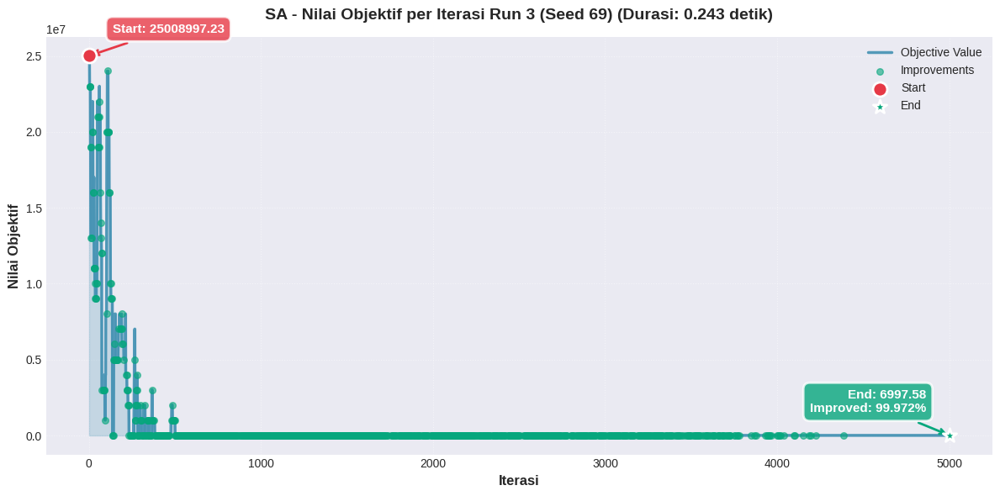

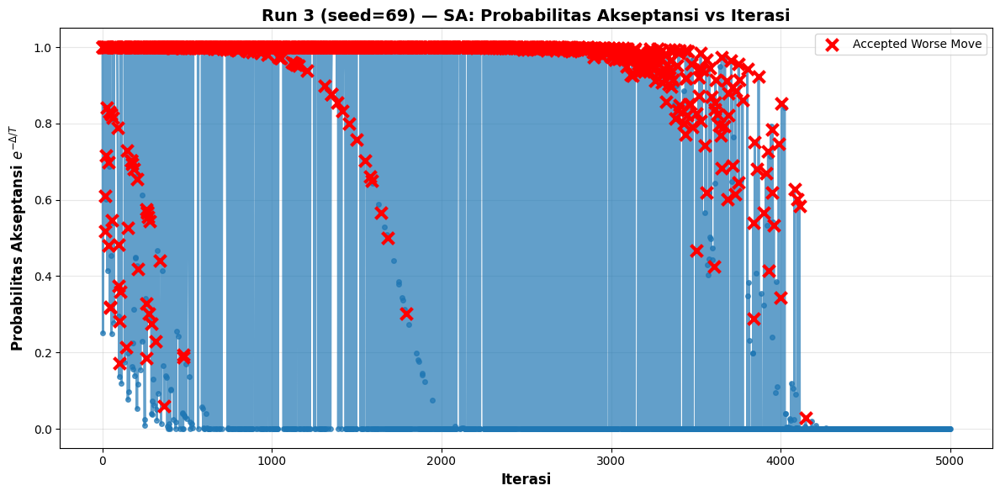

Tidak ada suhu valid untuk divisualisasikan.


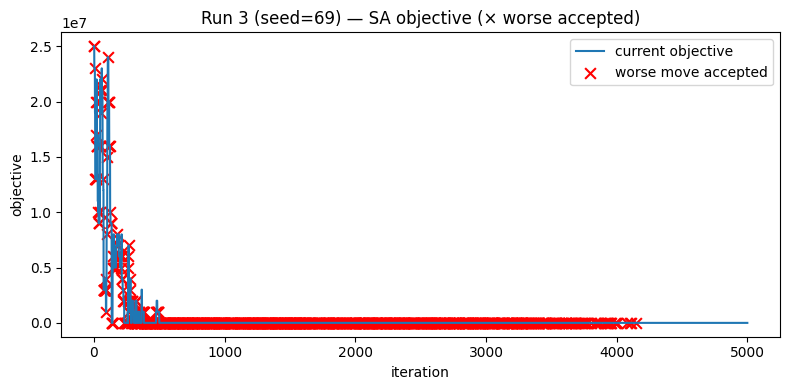

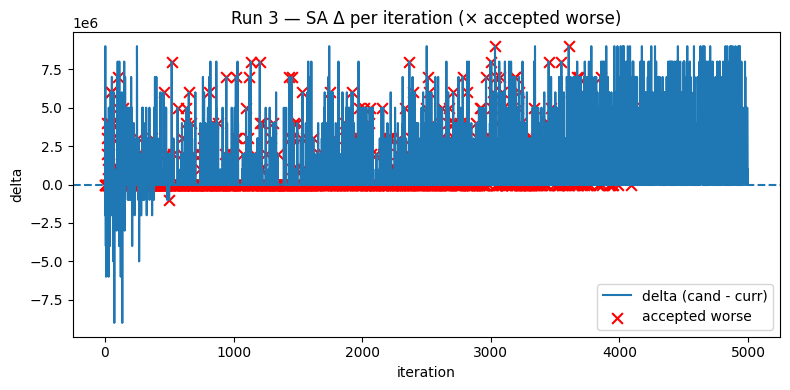


RINGKASAN SIMULATED ANNEALING
Objective Function Akhir:
  Min: 6997.58
  Max: 6997.72
  Rata-rata: 6997.63
  Std Dev: 0.06

Durasi:
  Rata-rata: 0.202 detik

Stuck Episodes:
  Rata-rata: 5.0

Accepted Worse Moves:
  Rata-rata: 952.7
  Min–Max : 705–1101


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

print("\n" + "=" * 60)
print("EKSPERIMEN 2: SIMULATED ANNEALING")
print("=" * 60)

sa_results = []
MAX_ITER_SA = 5000

for run_idx, seed in enumerate(SEEDS, 1):
    print(f"\n--- Run {run_idx} (Seed: {seed}) ---")

    result_dict = SimulatedAnnealing.run(
        items=EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        max_iter=MAX_ITER_SA,
        seed=seed,
        alpha=0.995
    )

    episodes, total_stagnant, frac = Visualizer.stuck_metrics(
        result_dict["objective_values"], window=150, verbose=False
    )

    prob_hist        = result_dict.get("probability_values", result_dict.get("probability_history", []))
    temp_hist        = result_dict.get("temperature_values", result_dict.get("temperature_history", []))
    history_current  = result_dict["history_current"]
    moves_log        = result_dict.get("moves_log", [])
    accepted_worse_idx = result_dict.get("accepted_worse_idx", [])
    delta_hist       = result_dict.get("delta_history", [m.get("delta") for m in moves_log] if moves_log else [])

    result = {
        'run': run_idx,
        'seed': seed,
        'initial_state': result_dict["initial_state"],
        'final_state': result_dict["final_state"],
        'history': result_dict["objective_values"],
        'history_current': history_current,
        'probability_history': prob_hist,
        'temperature_history': temp_hist,
        'delta_history': delta_hist,
        'final_objective': result_dict["objective_values"][-1],
        'duration': result_dict["duration"],
        'iterations': len(result_dict["objective_values"]) - 1,
        'stuck_episodes': episodes,
        'stuck_total': total_stagnant,
        'stuck_fraction': frac,
        'accepted_worse': len(accepted_worse_idx),
        'accepted_worse_idx': accepted_worse_idx
    }
    sa_results.append(result)

    print(f"Initial Objective: {result['history'][0]:.2f}")
    print(f"Final Objective: {result['final_objective']:.2f}")
    print(f"Improvement: {((result['history'][0] - result['final_objective']) / result['history'][0] * 100):.2f}%")
    print(f"Iterasi: {result['iterations']}")
    print(f"Durasi: {result['duration']:.3f} detik")
    print(f"Stuck Episodes: {episodes}")
    print(f"Stuck Fraction: {frac*100:.2f}%")
    print(f"Accepted Worse Moves: {result['accepted_worse']}")

    Visualizer.visualize_state(
        result['initial_state'],
        EXPERIMENT_ITEMS,
        EXPERIMENT_CAPACITY,
        f"SA - Initial State Run {run_idx}"
    )

    Visualizer.visualize_state(
        result['final_state'],
        EXPERIMENT_ITEMS,
        EXPERIMENT_CAPACITY,
        f"SA - Final State Run {run_idx}"
    )

    Visualizer.plot_objective_values(
        result['history_current'],
        result['duration'],
        title=f"SA - Nilai Objektif per Iterasi Run {run_idx} (Seed {result['seed']})"
    )

    acceptance_probs = []
    iterations_with_worse = []

    for i, (delta, temp) in enumerate(zip(delta_hist, temp_hist)):
        if delta is not None and delta > 0 and temp > 0:
            prob = np.exp(-delta / temp)
            acceptance_probs.append(prob)
            iterations_with_worse.append(i)

    if acceptance_probs:
        plt.figure(figsize=(12, 6))
        plt.plot(iterations_with_worse, acceptance_probs, 'o-', linewidth=2, markersize=4, alpha=0.7)

        if accepted_worse_idx:
            accepted_probs = []
            accepted_iters = []
            for idx in accepted_worse_idx:
                if idx in iterations_with_worse:
                    pos = iterations_with_worse.index(idx)
                    accepted_probs.append(acceptance_probs[pos])
                    accepted_iters.append(idx)

            if accepted_probs:
                plt.scatter(accepted_iters, accepted_probs, color='red', s=100,
                           marker='x', linewidth=3, label='Accepted Worse Move', zorder=5)

        plt.xlabel("Iterasi", fontsize=12, fontweight='bold')
        plt.ylabel(r"Probabilitas Akseptansi $e^{-\Delta/T}$", fontsize=12, fontweight='bold')
        plt.title(f"Run {run_idx} (seed={seed}) — SA: Probabilitas Akseptansi vs Iterasi",
                 fontsize=14, fontweight='bold')
        plt.ylim(-0.05, 1.05)
        plt.grid(True, alpha=0.3)
        plt.legend(fontsize=10)
        plt.tight_layout()
        plt.show()

    Visualizer.plot_eet(
        probability_history=prob_hist,
        temperature_history=temp_hist,
        history_current=history_current,
        title=f"Run {run_idx} (seed={seed}) — SA: $e^{{-\\Delta/T}}$ vs Iterasi"
    )

    plt.figure(figsize=(8,4))
    plt.plot(history_current, label="current objective")
    if accepted_worse_idx:
        xw = [i for i in accepted_worse_idx if 0 <= i < len(history_current)]
        yw = [history_current[i] for i in xw]
        plt.scatter(xw, yw, marker='x', s=60, label="worse move accepted", color='red')
    plt.xlabel("iteration"); plt.ylabel("objective")
    plt.title(f"Run {run_idx} (seed={seed}) — SA objective (× worse accepted)")
    plt.legend(); plt.tight_layout(); plt.show()

    if delta_hist:
        plt.figure(figsize=(8,4))
        plt.plot(delta_hist, label="delta (cand - curr)")
        acc_idx = ([i for i,m in enumerate(moves_log) if m.get("worse") and m.get("accepted")]
                   if moves_log else [i for i in accepted_worse_idx if 0 <= i < len(delta_hist)])
        if acc_idx:
            y = [delta_hist[i] for i in acc_idx]
            plt.scatter(acc_idx, y, marker='x', s=60, label="accepted worse", color='red')
        plt.axhline(0, linestyle="--")
        plt.xlabel("iteration"); plt.ylabel("delta")
        plt.title(f"Run {run_idx} — SA Δ per iteration (× accepted worse)")
        plt.legend(); plt.tight_layout(); plt.show()

print("\n" + "=" * 60)
print("RINGKASAN SIMULATED ANNEALING")
print("=" * 60)
final_objectives = [r['final_objective'] for r in sa_results]
durations = [r['duration'] for r in sa_results]
stuck_eps = [r['stuck_episodes'] for r in sa_results]
accepted_worse_all = [r['accepted_worse'] for r in sa_results]

print("Objective Function Akhir:")
print(f"  Min: {min(final_objectives):.2f}")
print(f"  Max: {max(final_objectives):.2f}")
print(f"  Rata-rata: {np.mean(final_objectives):.2f}")
print(f"  Std Dev: {np.std(final_objectives):.2f}")

print("\nDurasi:")
print(f"  Rata-rata: {np.mean(durations):.3f} detik")

print("\nStuck Episodes:")
print(f"  Rata-rata: {np.mean(stuck_eps):.1f}")

print("\nAccepted Worse Moves:")
print(f"  Rata-rata: {np.mean(accepted_worse_all):.1f}")
print(f"  Min–Max : {int(np.min(accepted_worse_all))}–{int(np.max(accepted_worse_all))}")
print("=" * 60)

## **EKSPERIMEN 3: Genetic Algorithm**

**Eksperimen yang dilakukan:**
1. **Kontrol Populasi** - Variasi iterasi (50, 100, 200)
2. **Kontrol Iterasi** - Variasi populasi (50, 100, 200)
3. **Pengaruh Mutation Rate** - Minimal 2 variasi (0.1, 0.2)

**Metrik yang dicatat:**
- State awal dan akhir
- Nilai objective function akhir (max dan rata-rata populasi)
- Plot objective function vs iterasi
- Durasi pencarian
- Pengaruh parameter


EKSPERIMEN GENETIC ALGORITHM

=== Eksperimen 2: Variasi Jumlah Generasi ===

Menjalankan GA dengan Mutation Rate = 0.15

Menjalankan GA dengan Populasi = 2


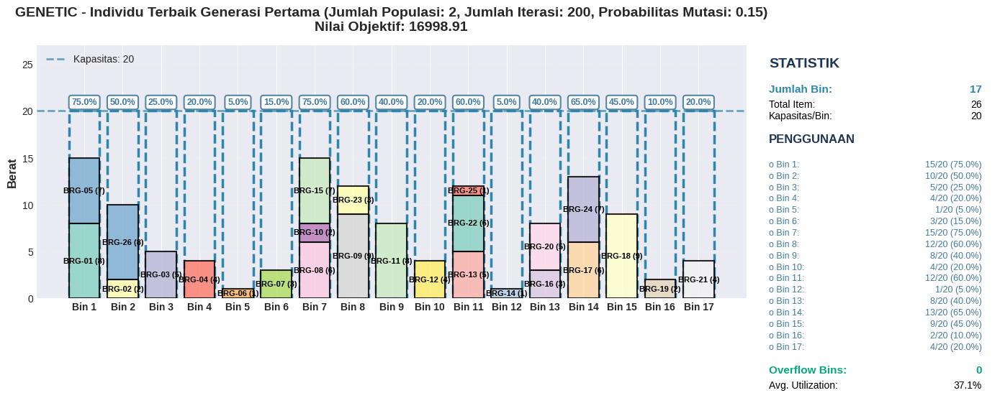

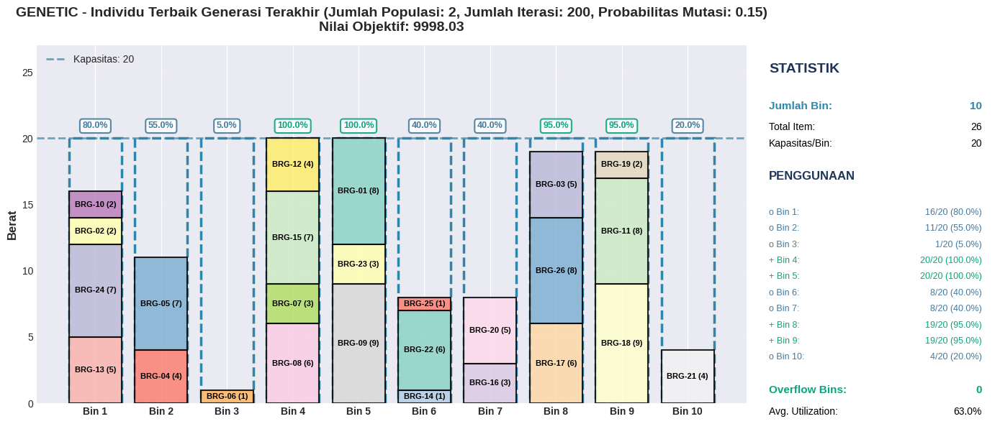

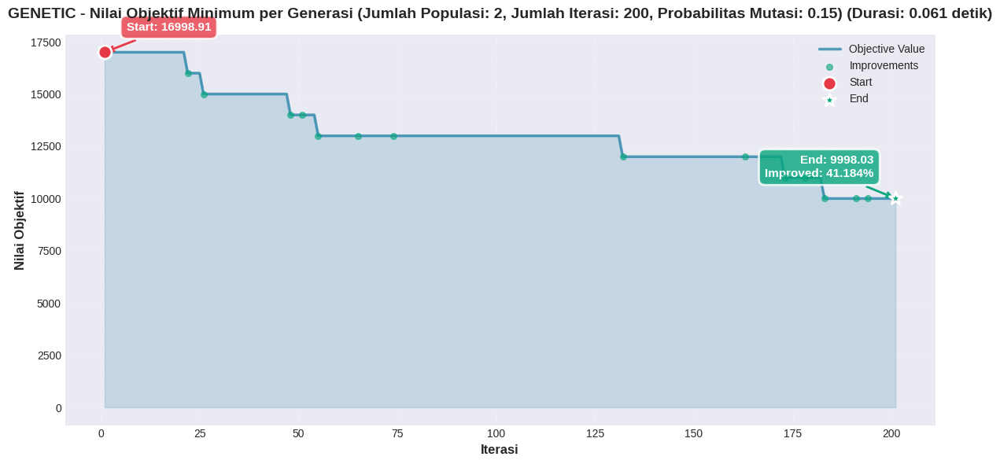


Menjalankan GA dengan Populasi = 2


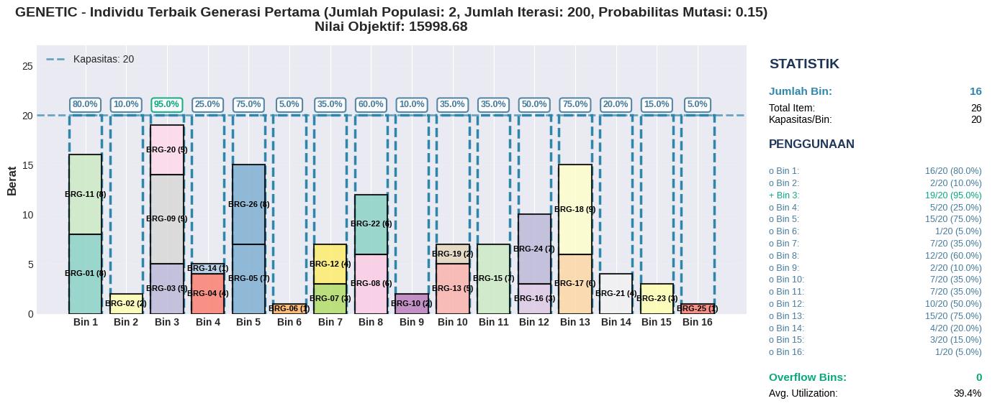

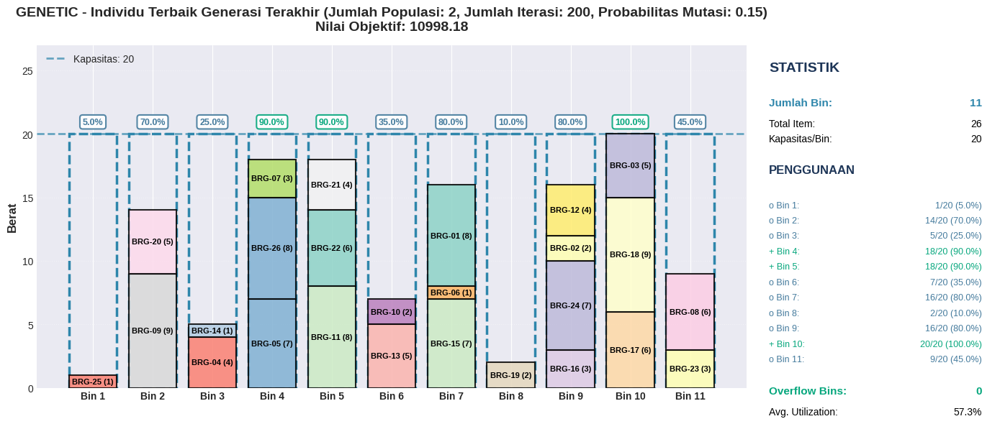

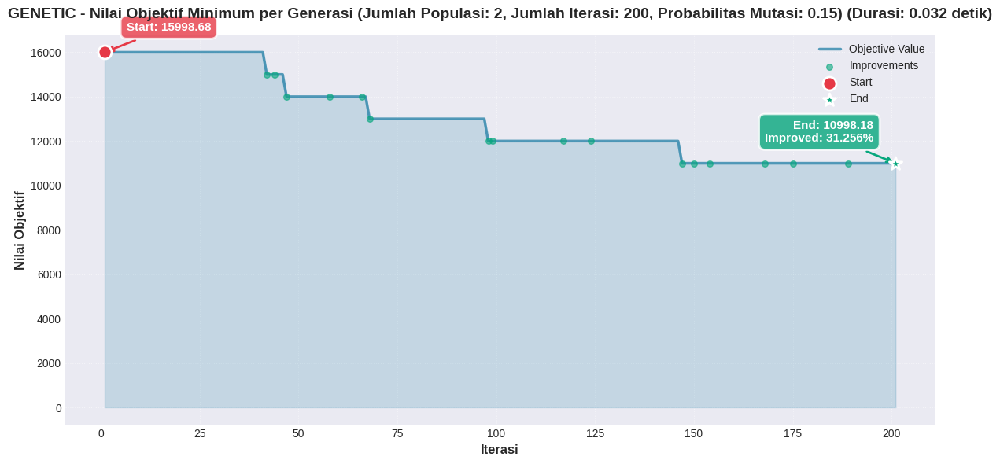


Menjalankan GA dengan Populasi = 2


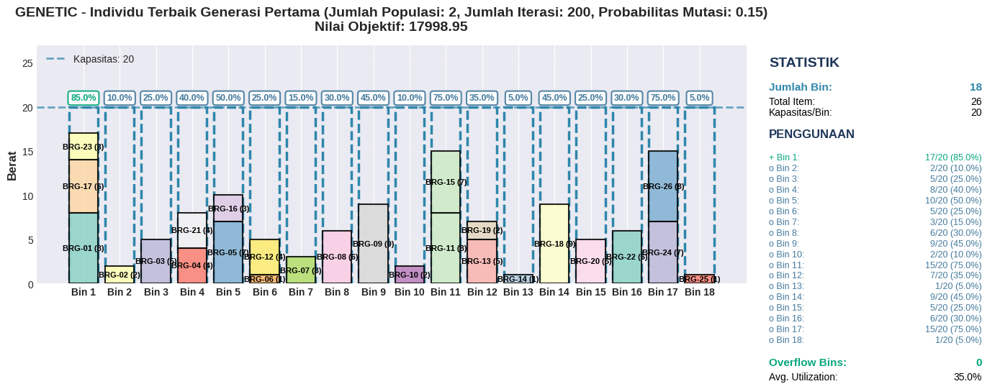

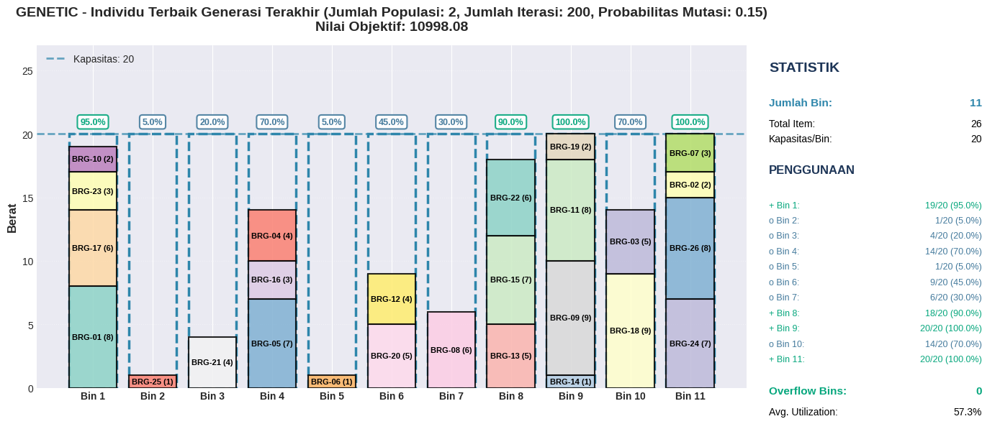

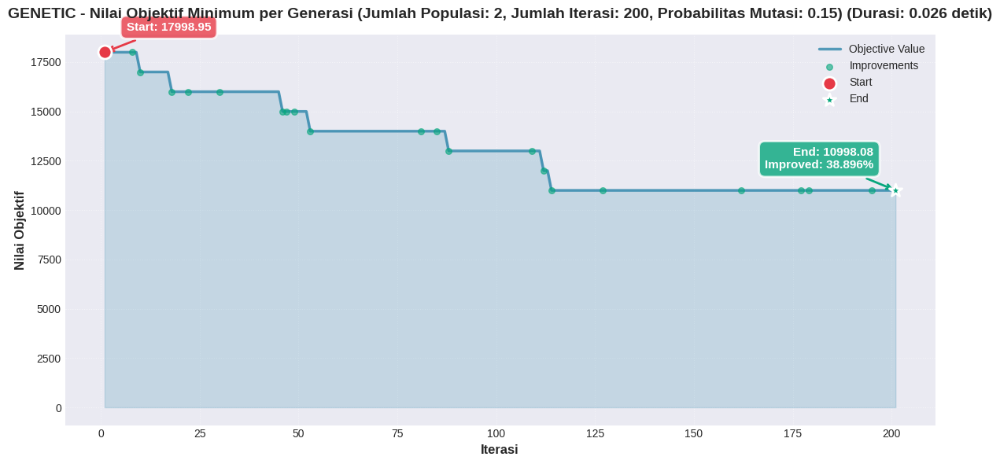


Menjalankan GA dengan Populasi = 8


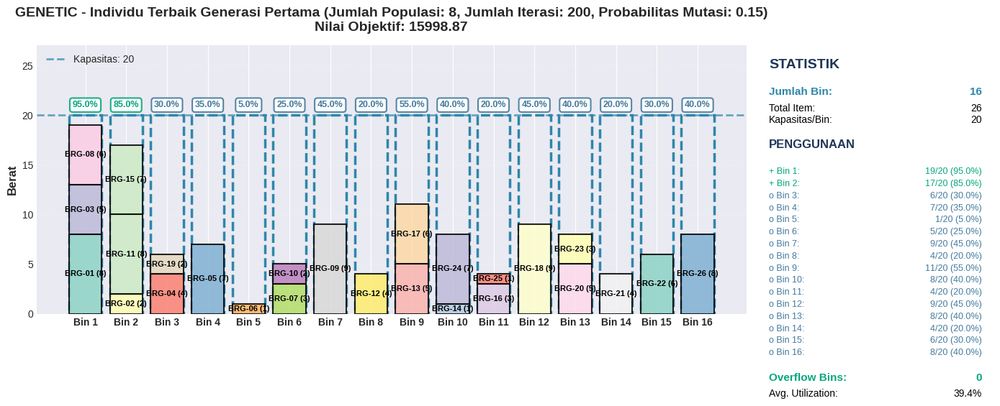

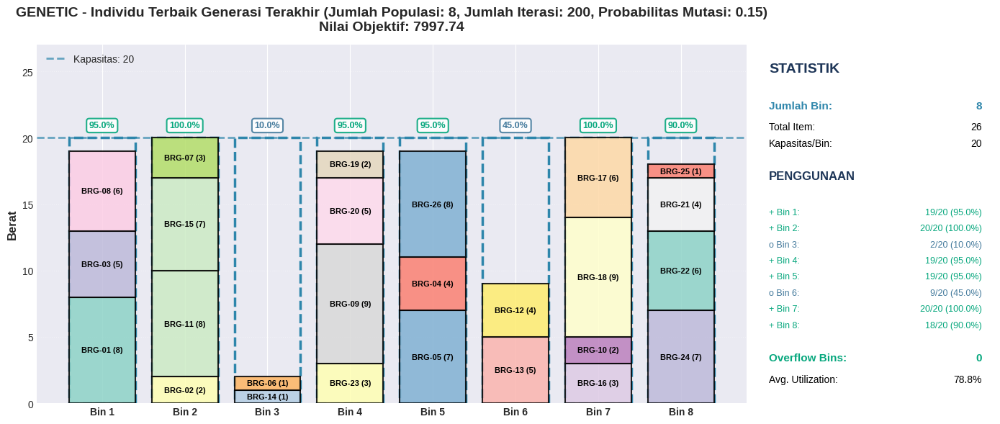

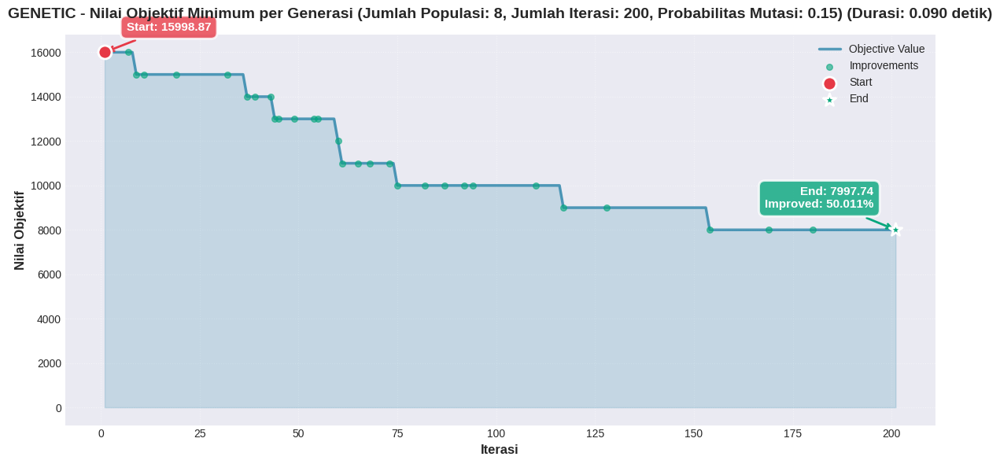


Menjalankan GA dengan Populasi = 8


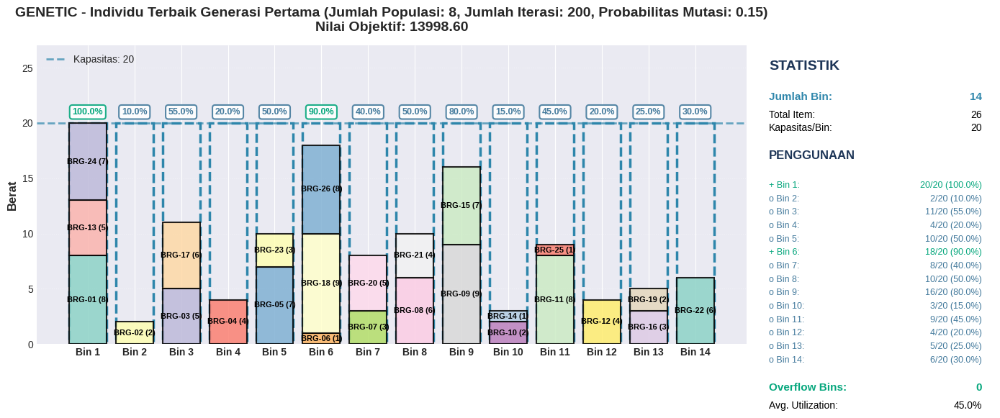

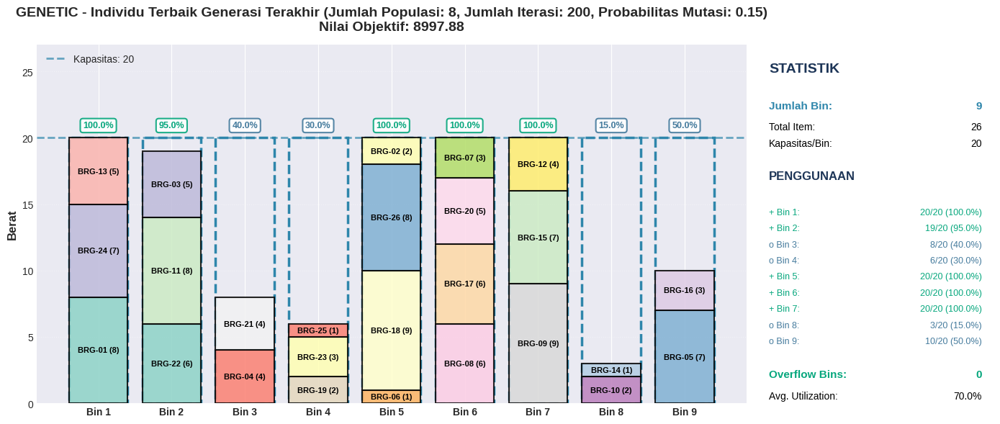

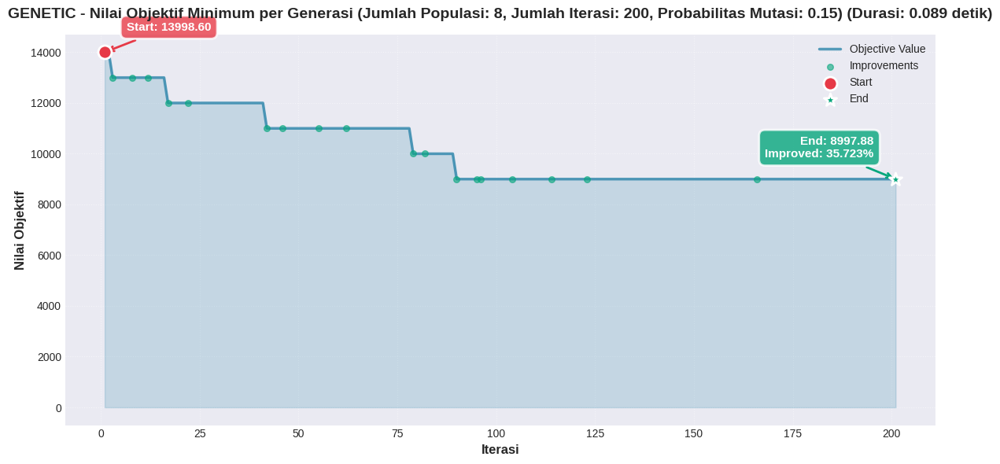


Menjalankan GA dengan Populasi = 8


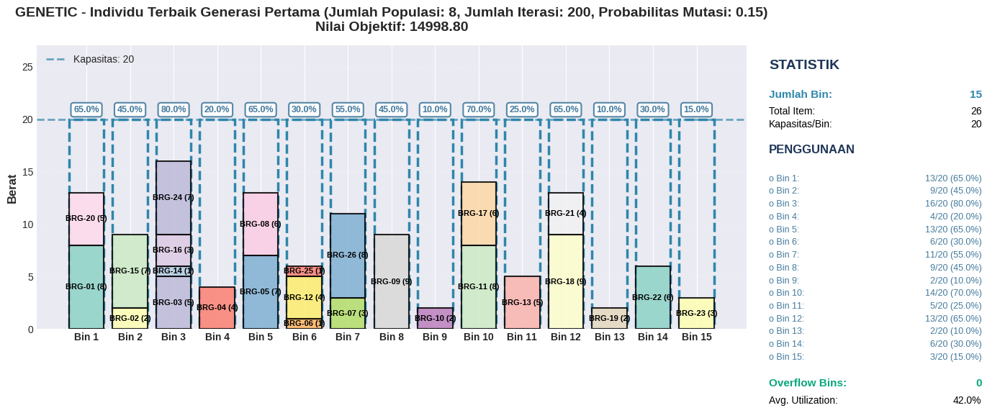

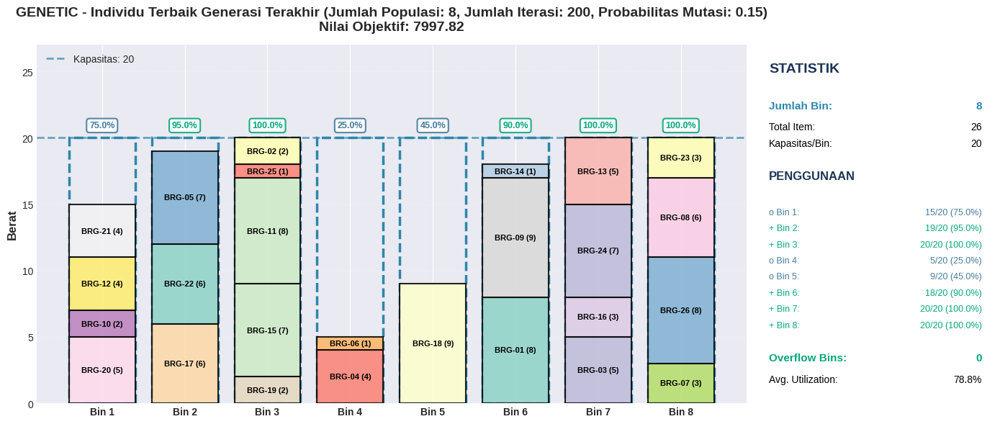

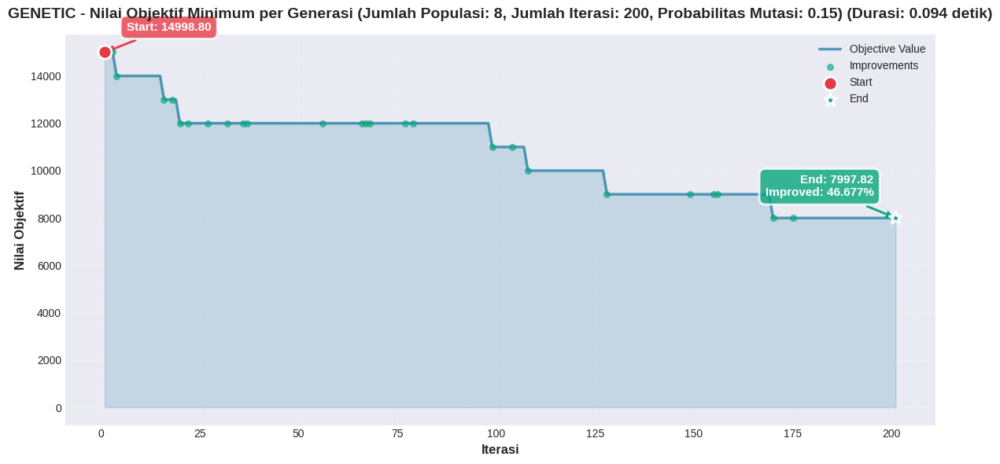


Menjalankan GA dengan Populasi = 16


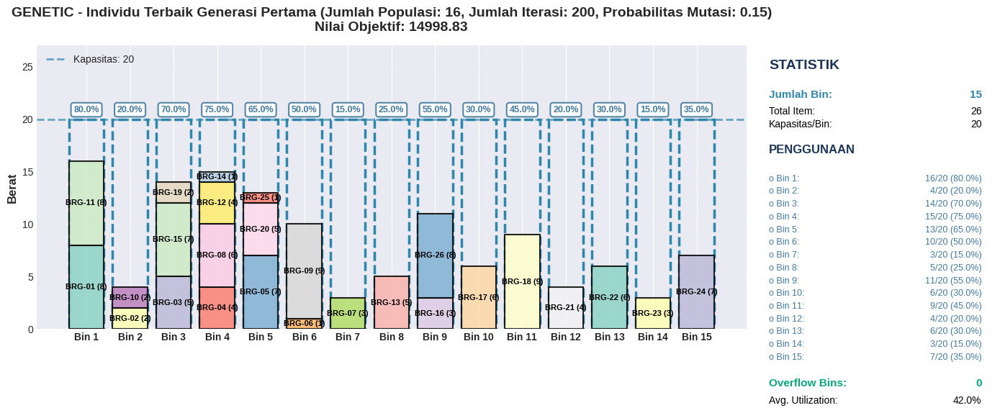

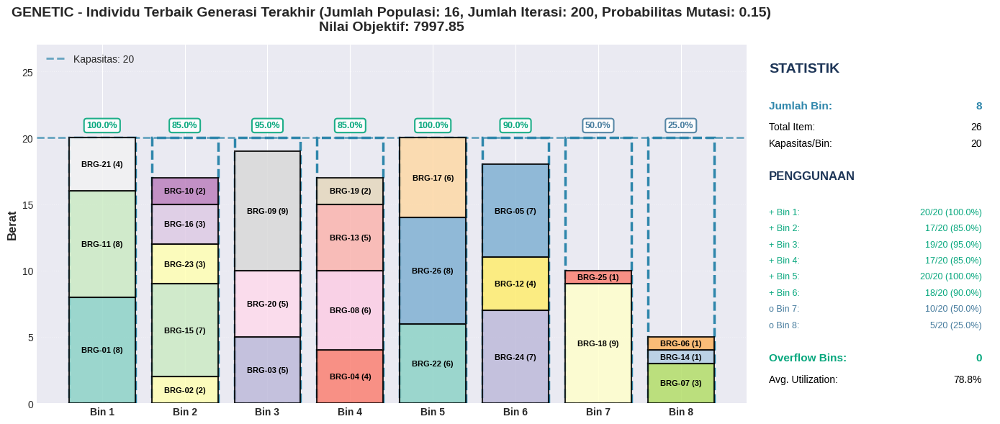

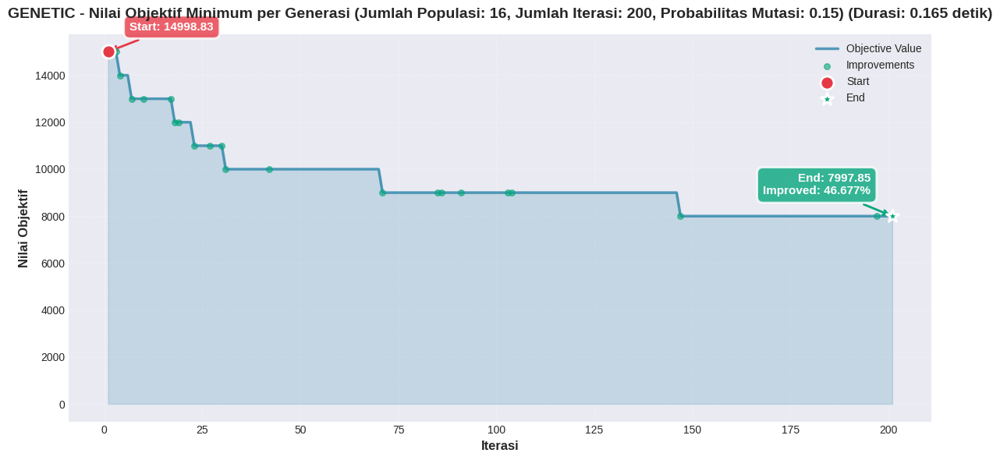


Menjalankan GA dengan Populasi = 16


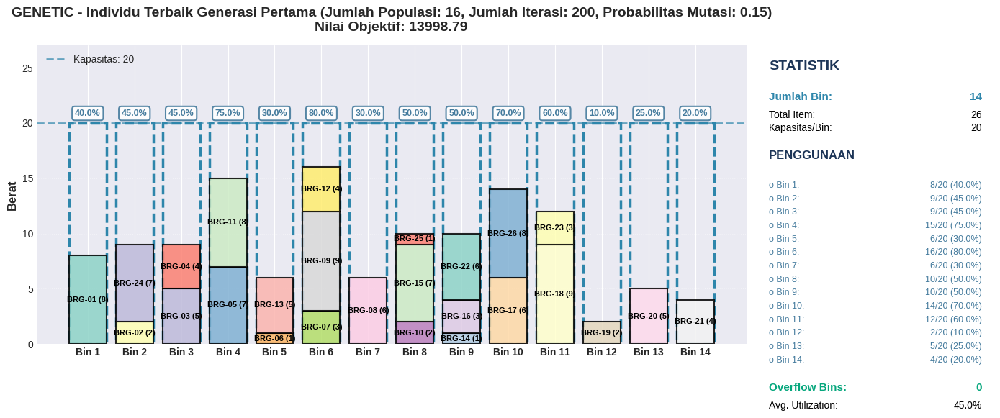

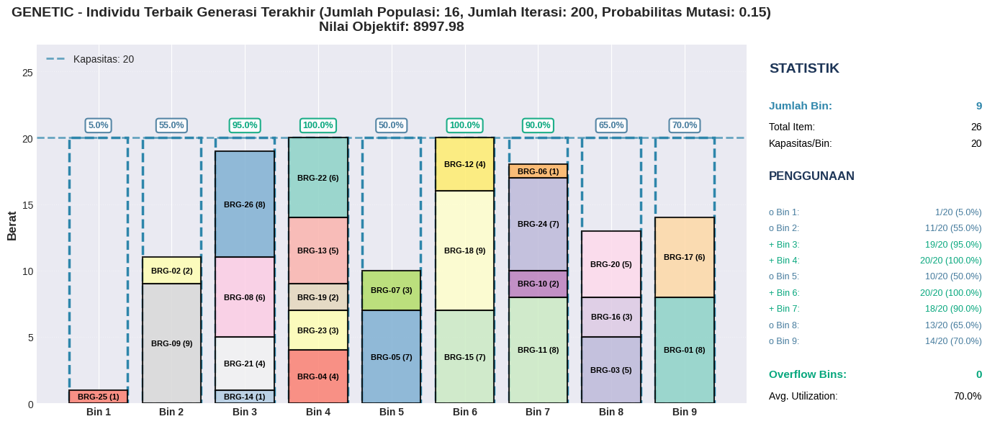

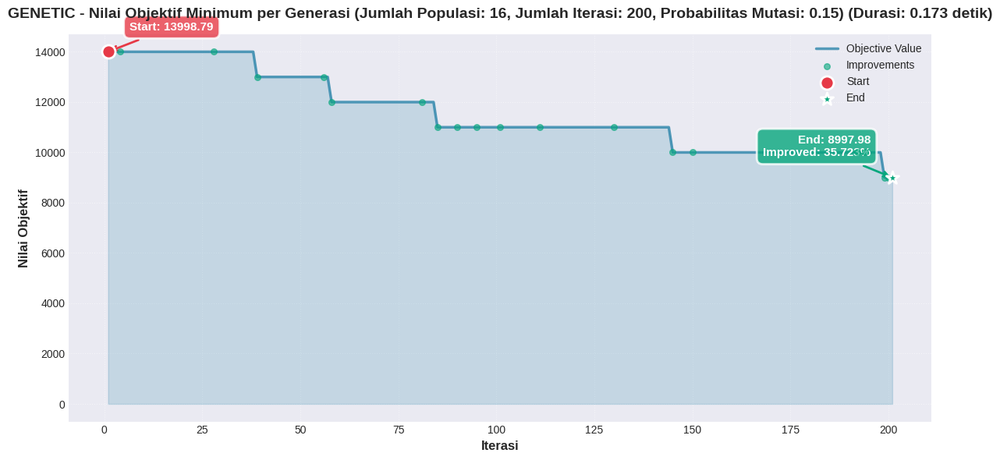


Menjalankan GA dengan Populasi = 16


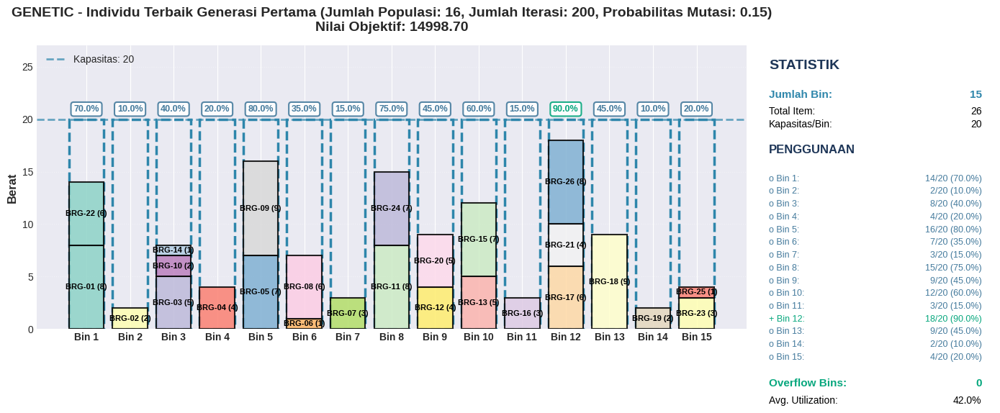

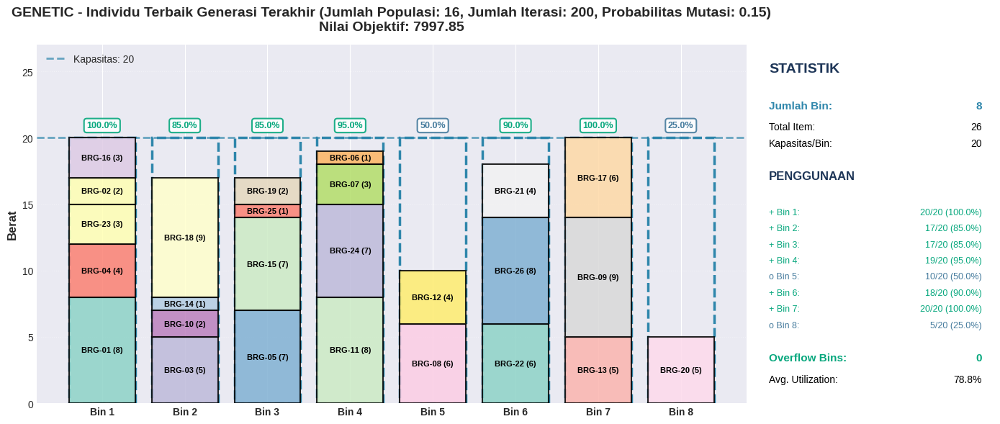

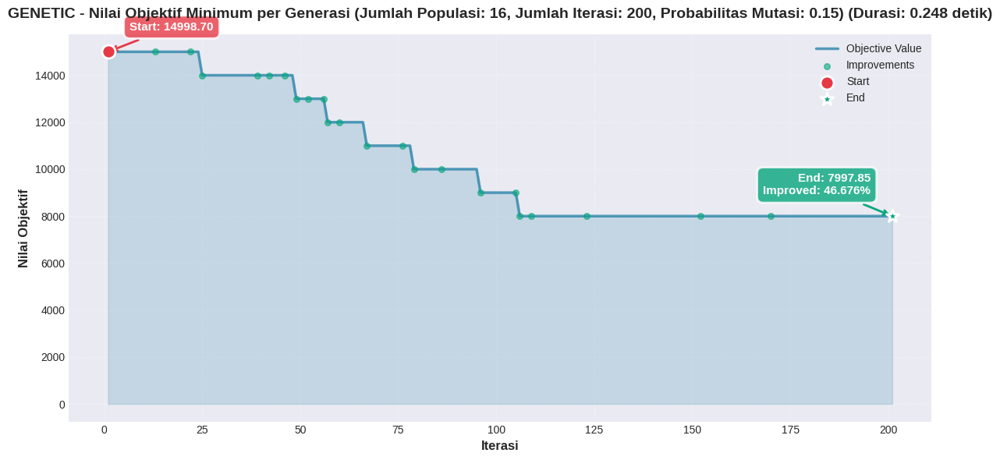


Menjalankan GA dengan Generasi = 100


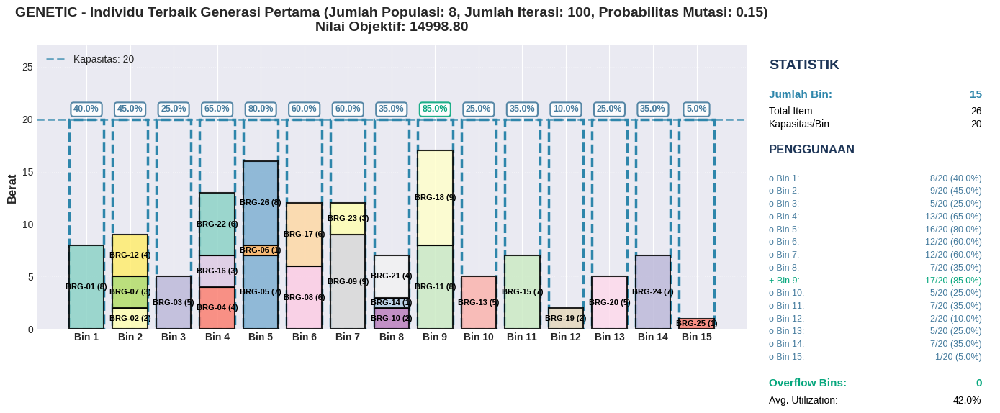

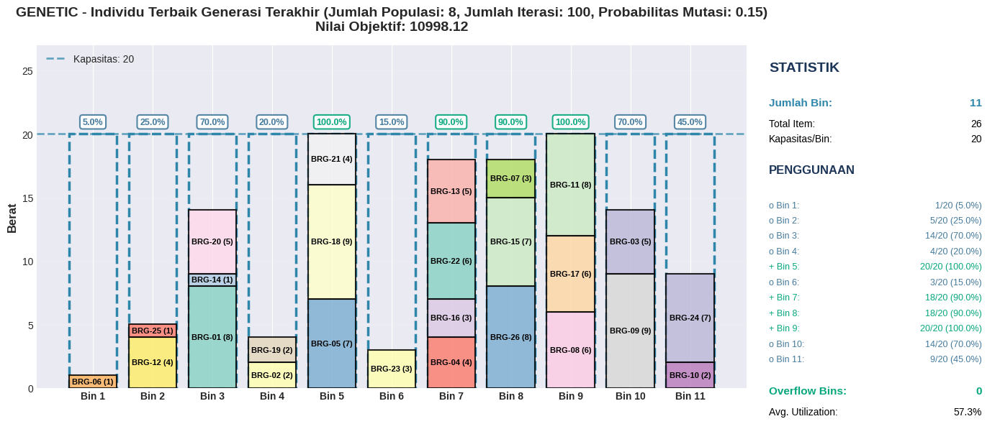

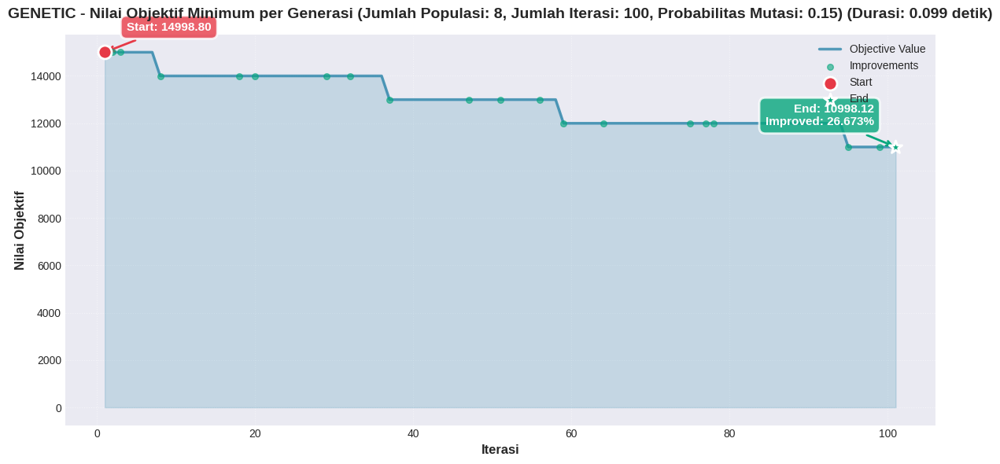


Menjalankan GA dengan Generasi = 100


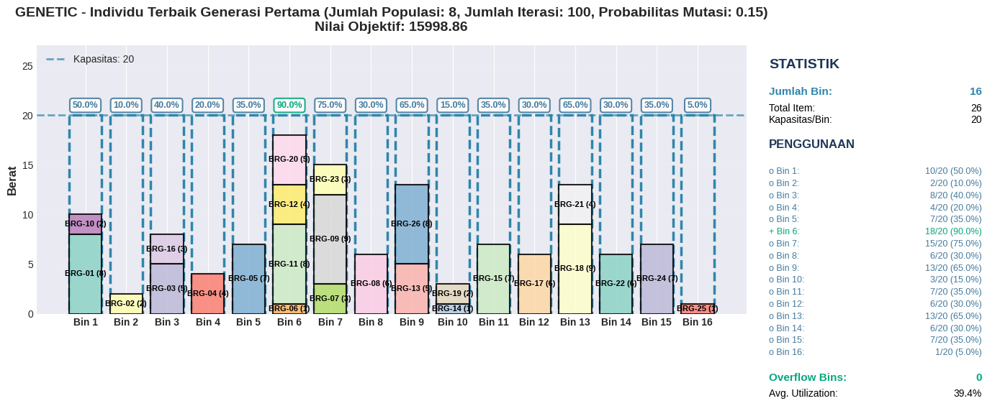

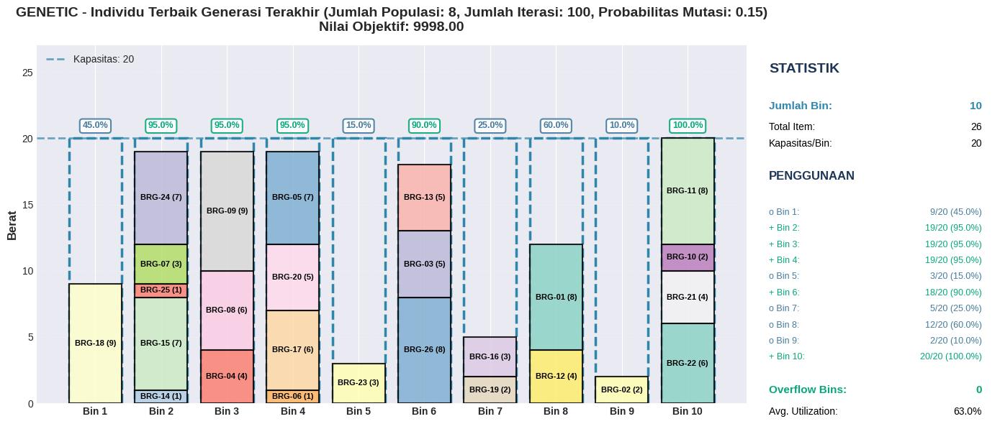

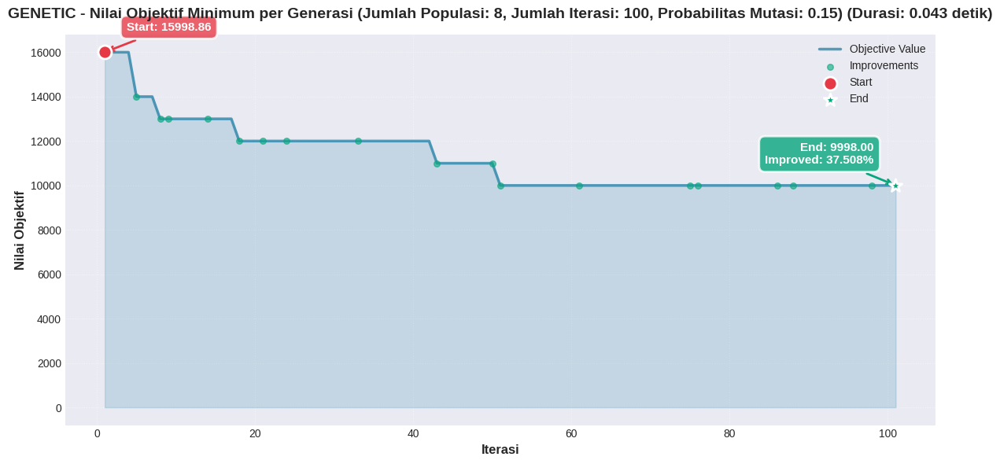


Menjalankan GA dengan Generasi = 100


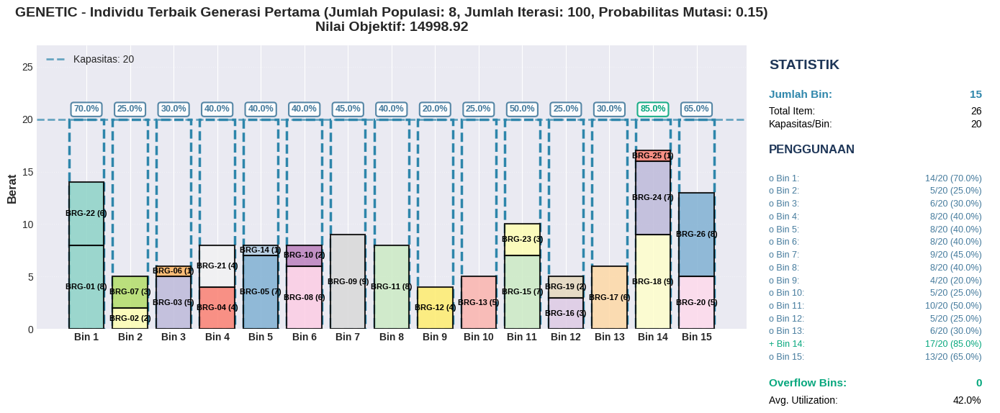

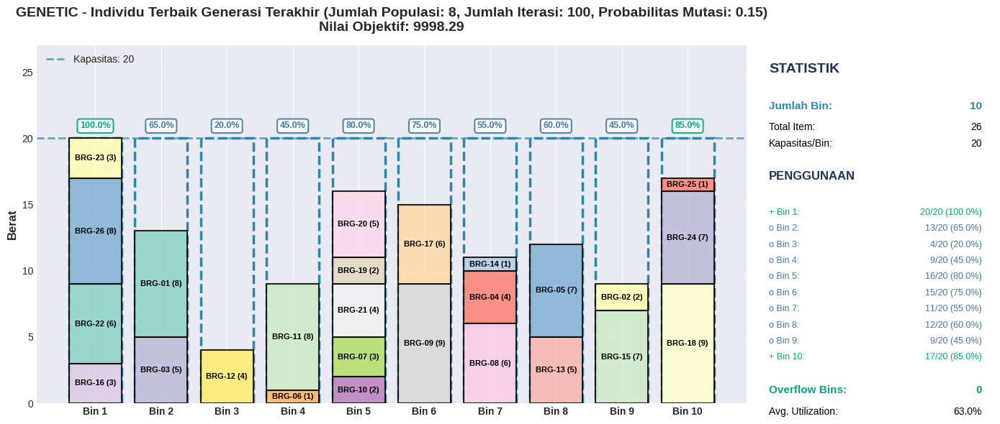

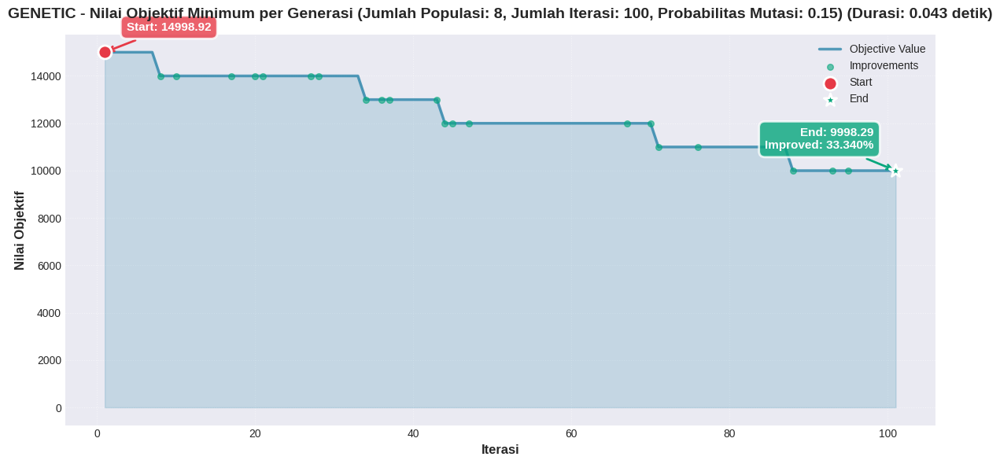


Menjalankan GA dengan Generasi = 200


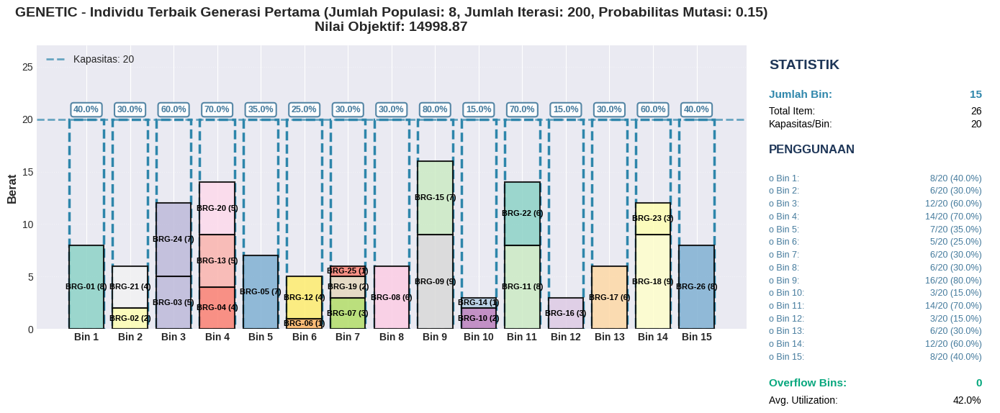

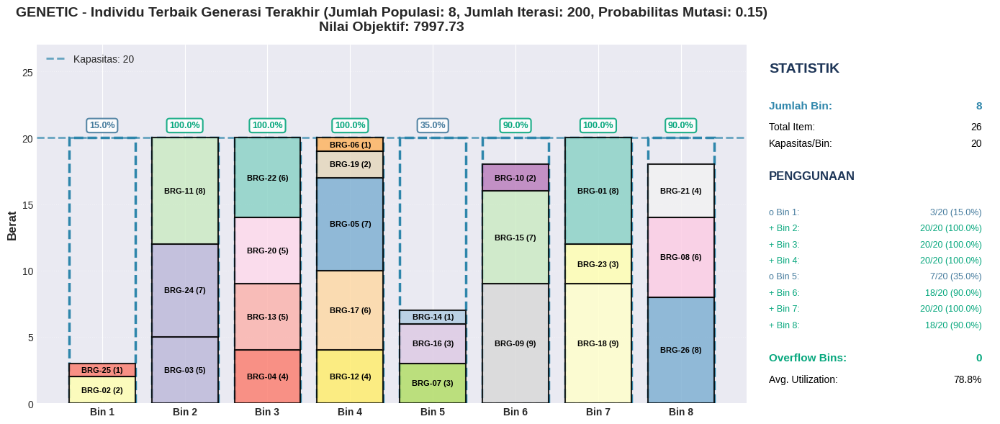

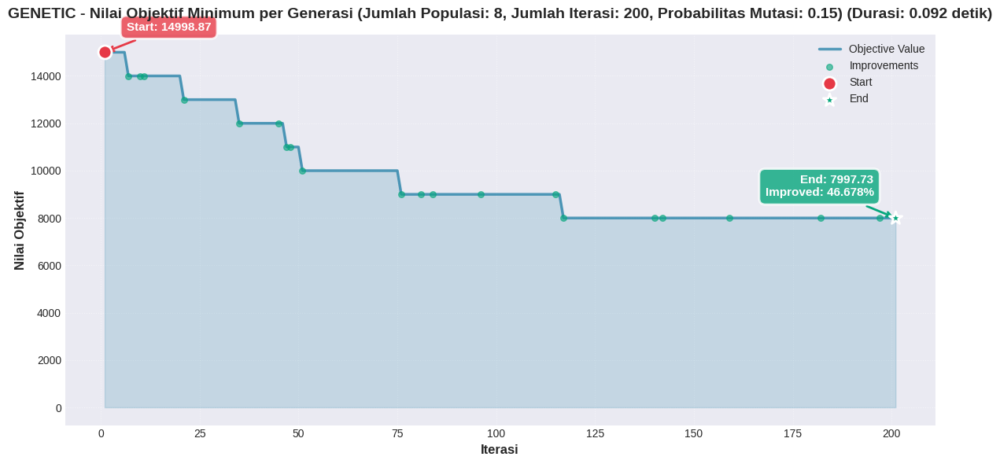


Menjalankan GA dengan Generasi = 200


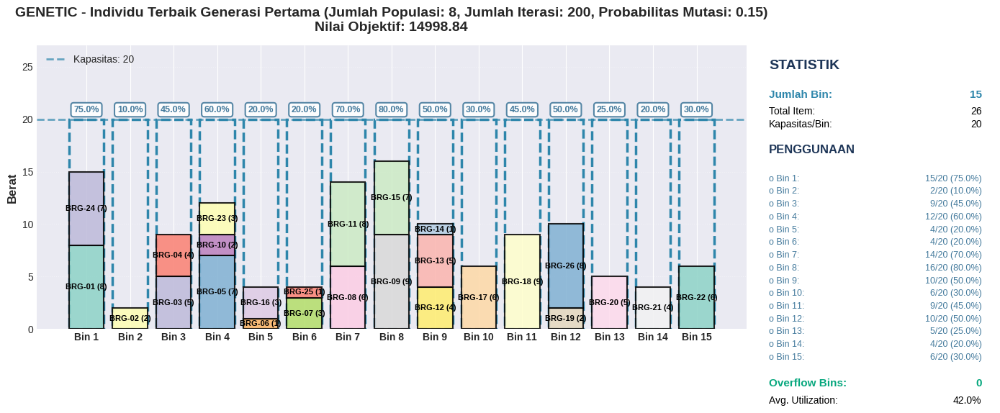

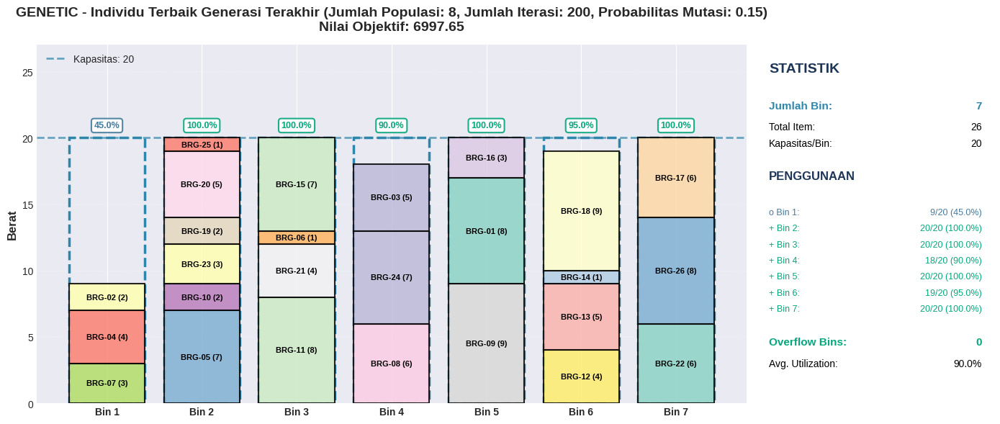

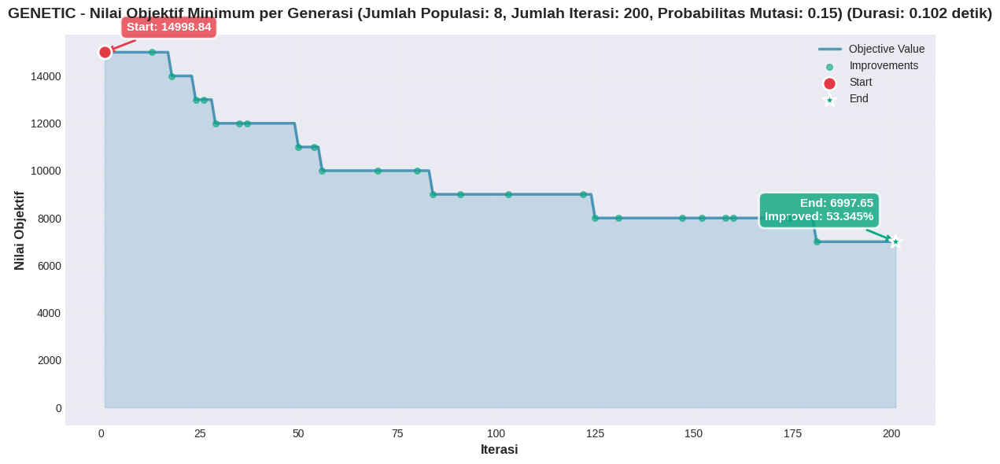


Menjalankan GA dengan Generasi = 200


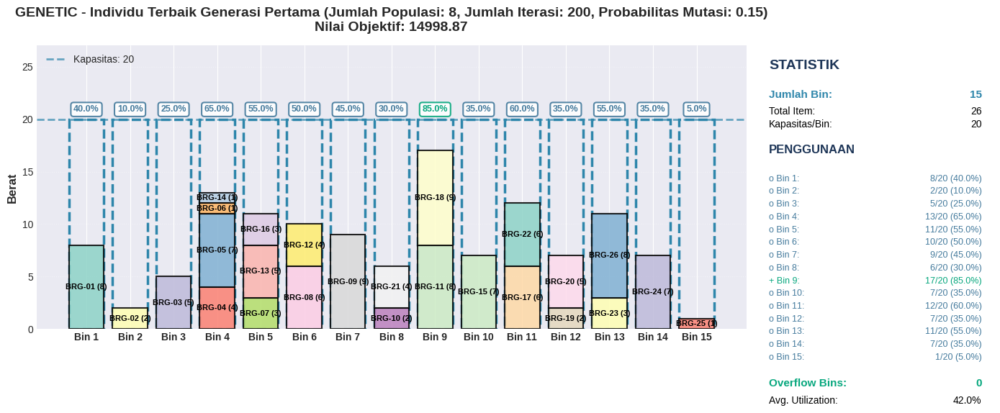

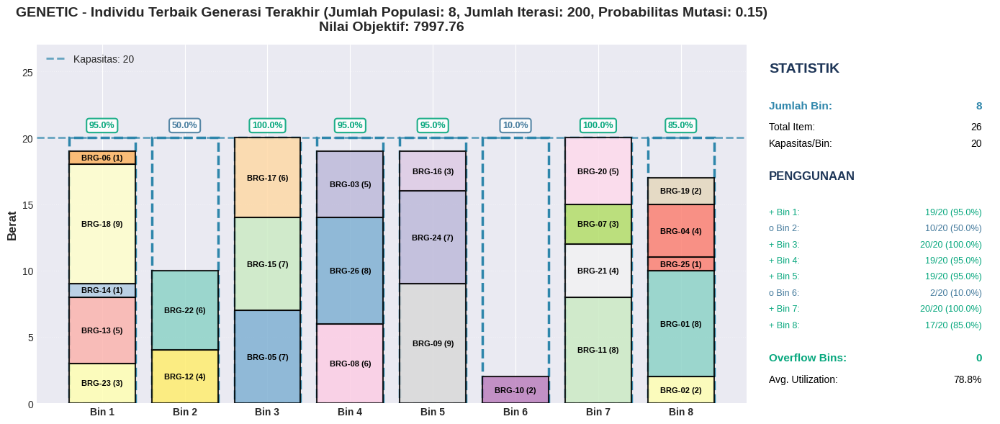

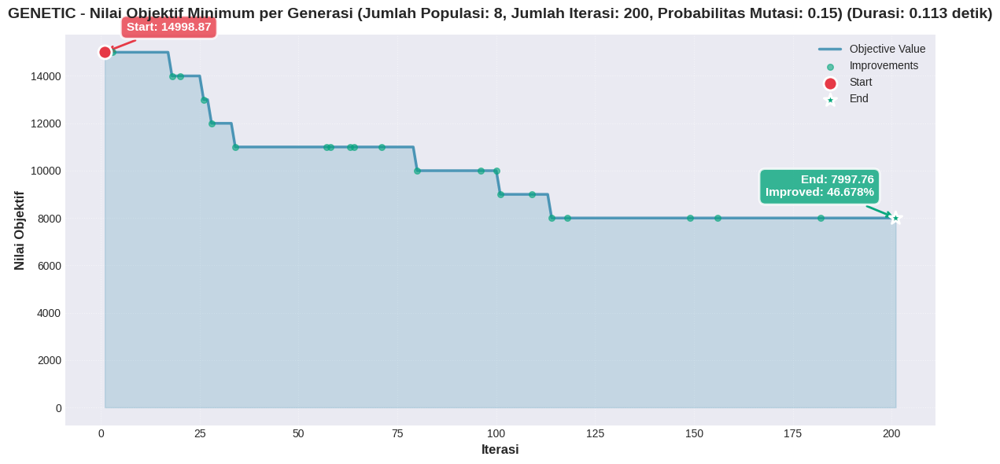


Menjalankan GA dengan Generasi = 500


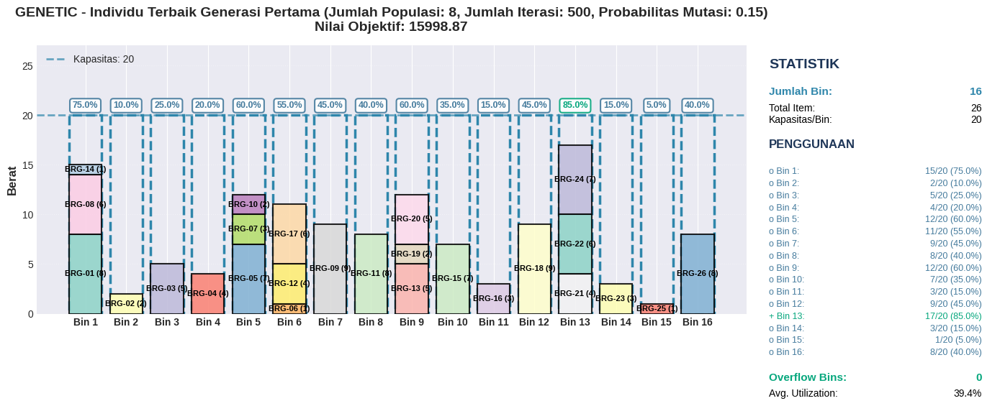

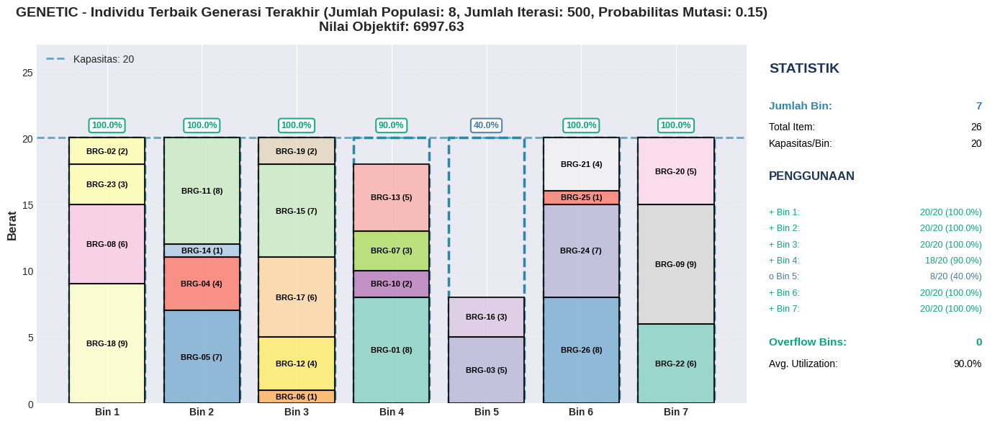

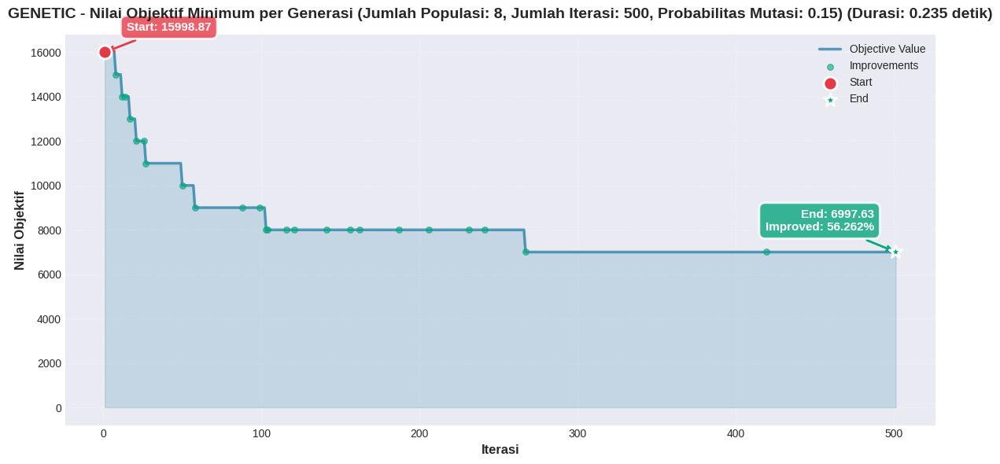


Menjalankan GA dengan Generasi = 500


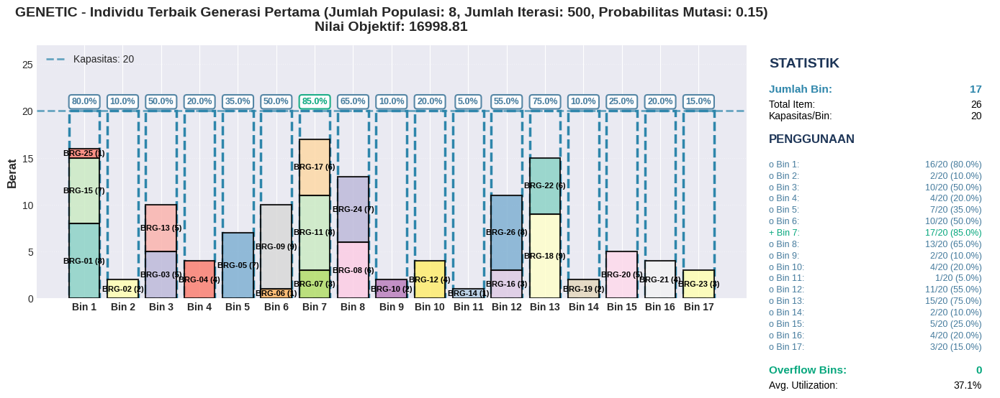

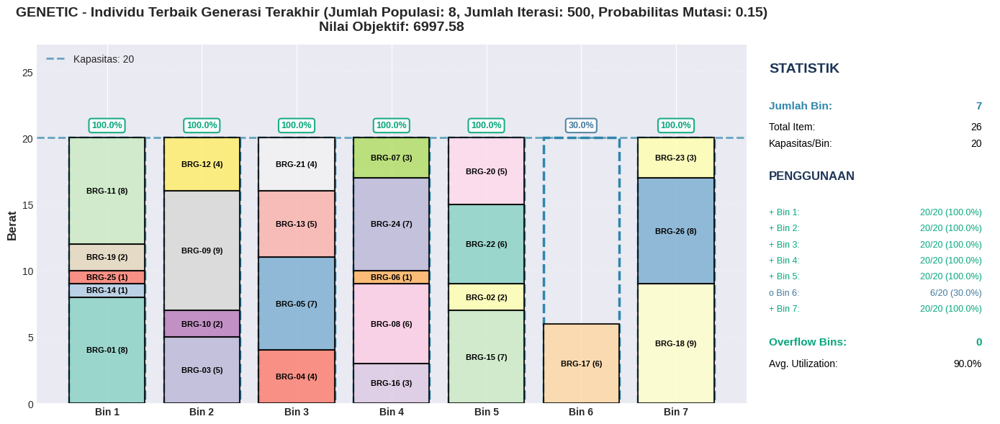

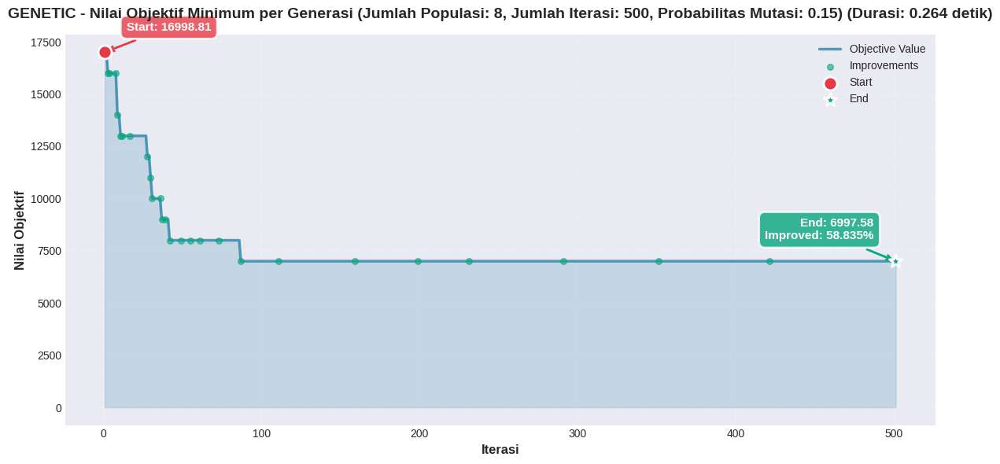


Menjalankan GA dengan Generasi = 500


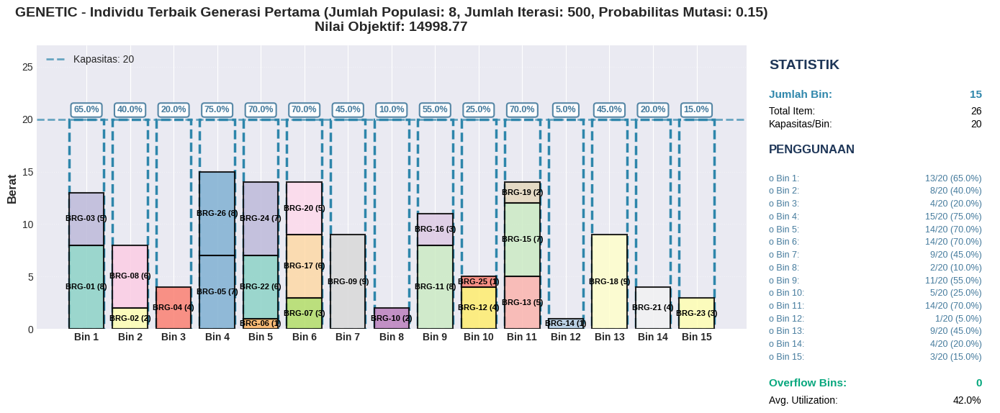

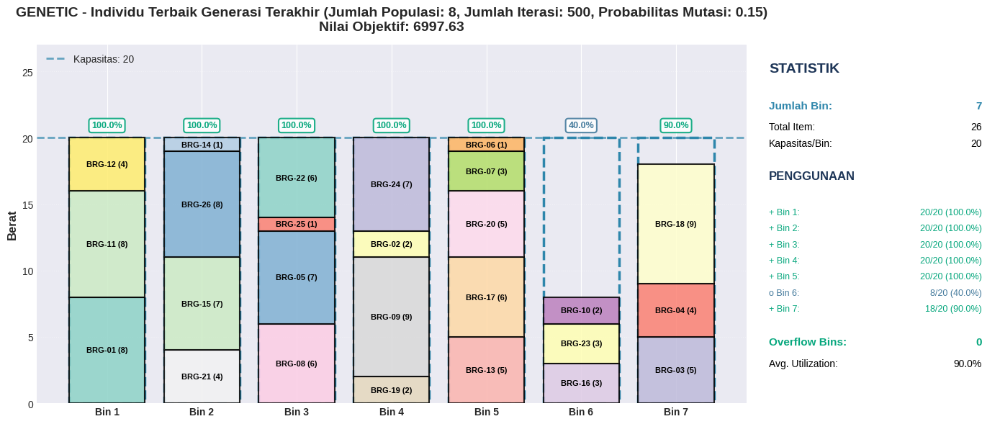

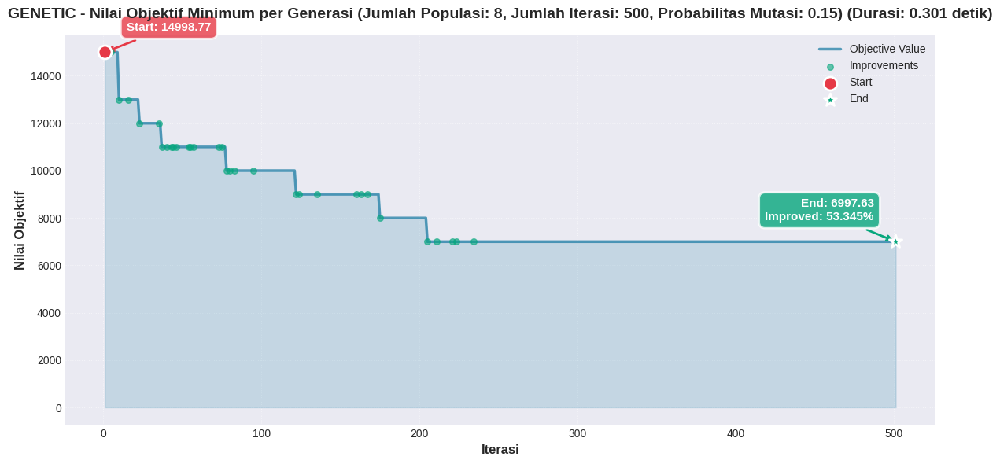


Menjalankan GA dengan Mutation Rate = 0.5

Menjalankan GA dengan Populasi = 2


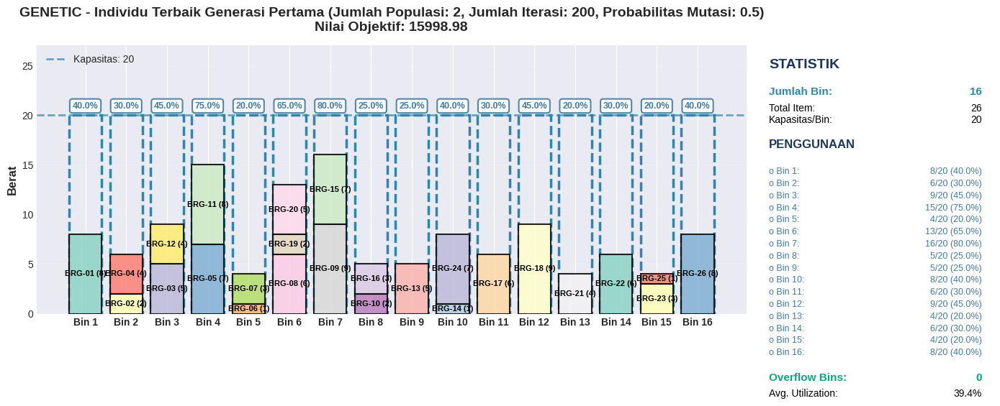

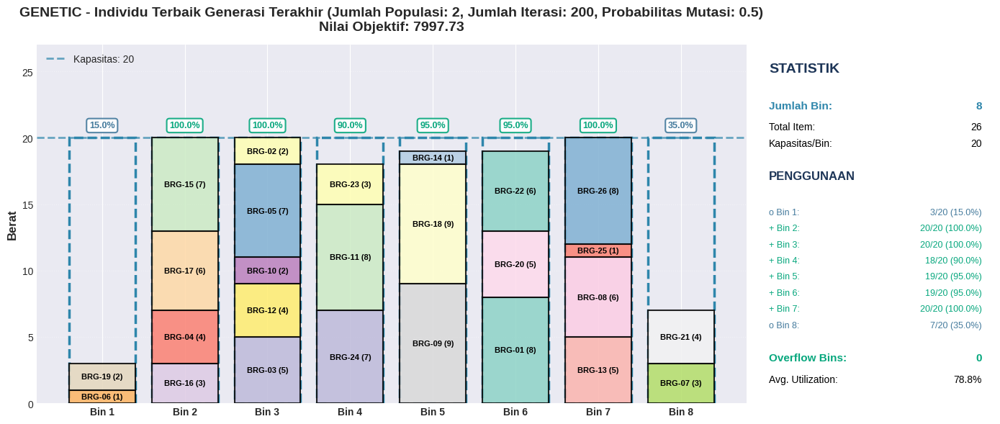

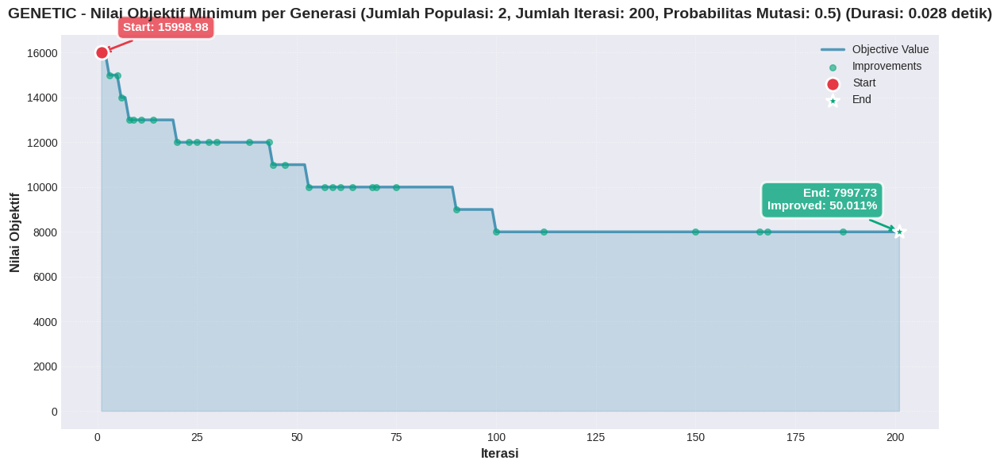


Menjalankan GA dengan Populasi = 2


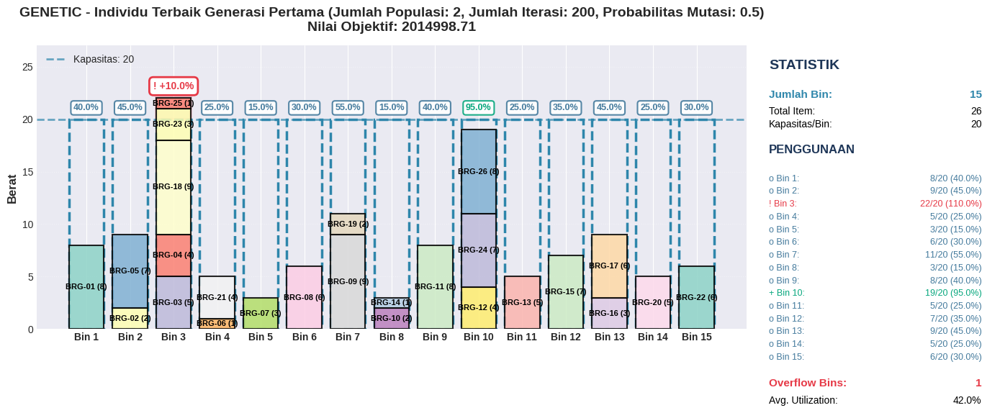

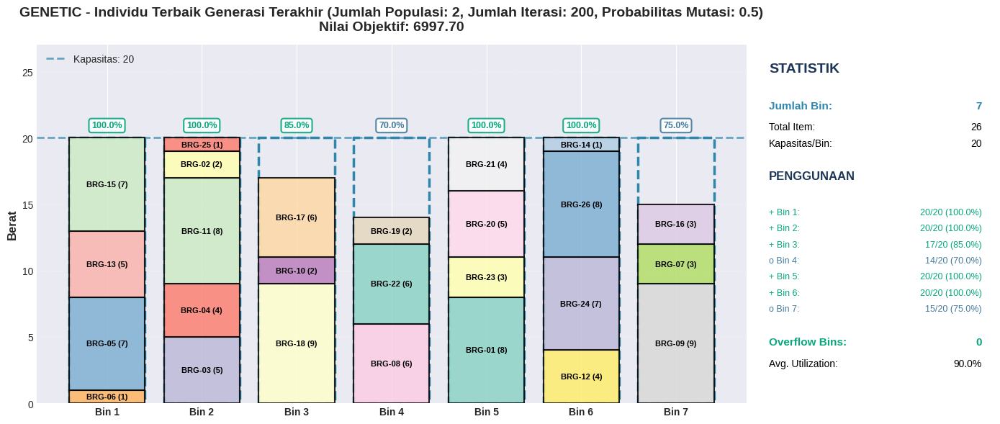

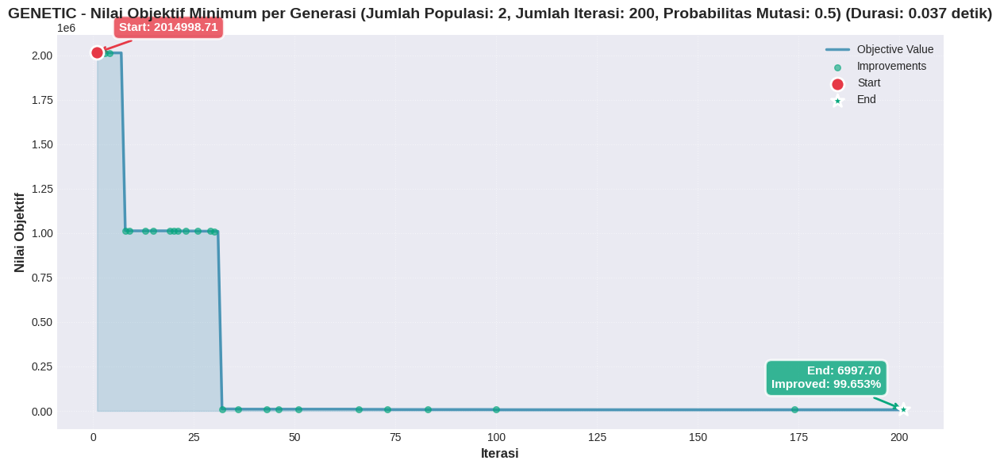


Menjalankan GA dengan Populasi = 2


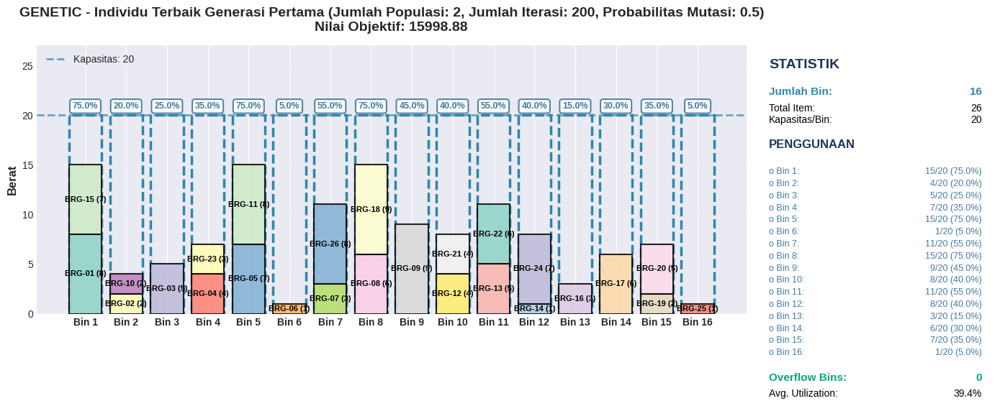

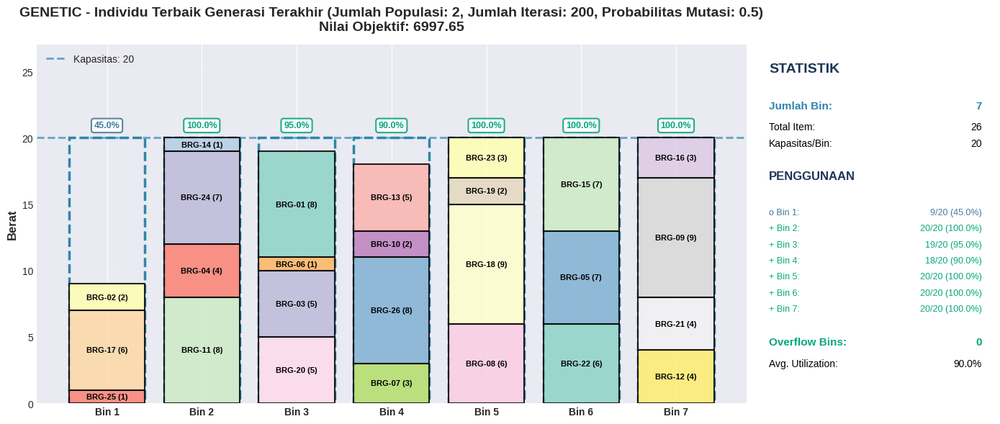

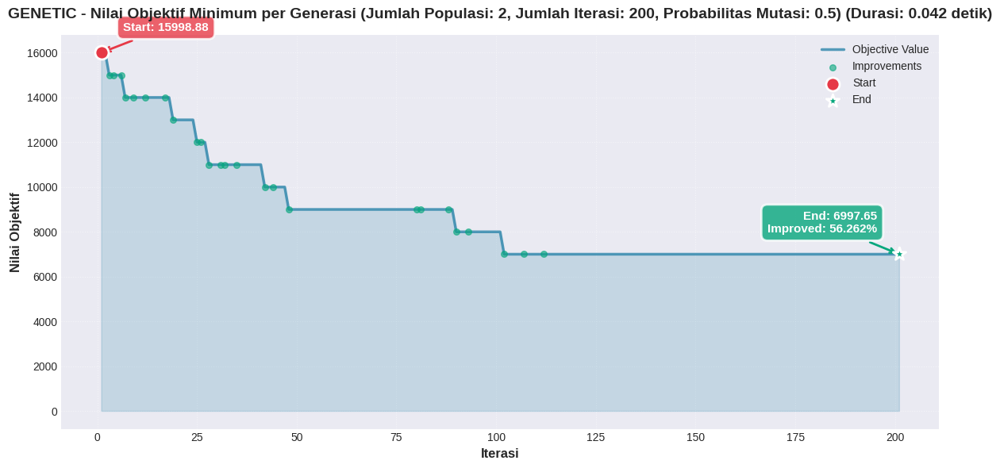


Menjalankan GA dengan Populasi = 8


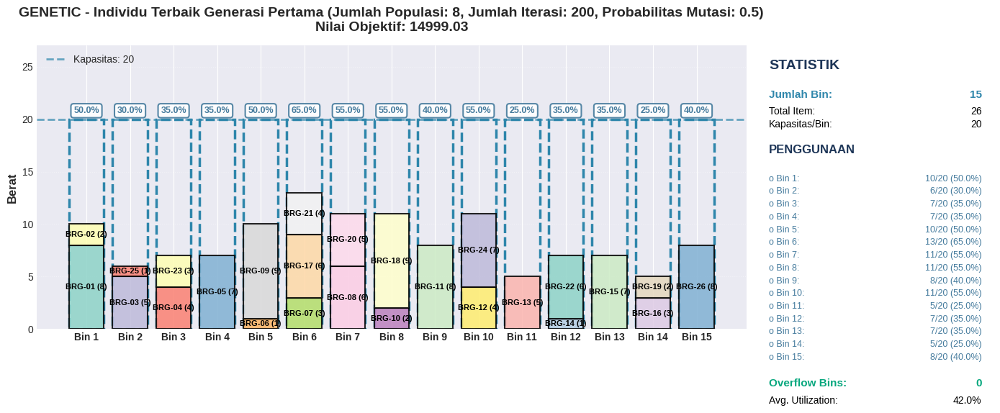

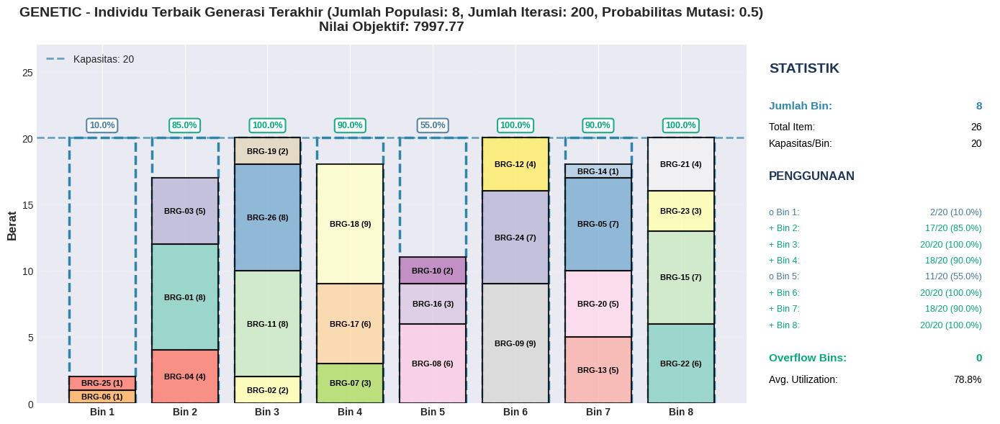

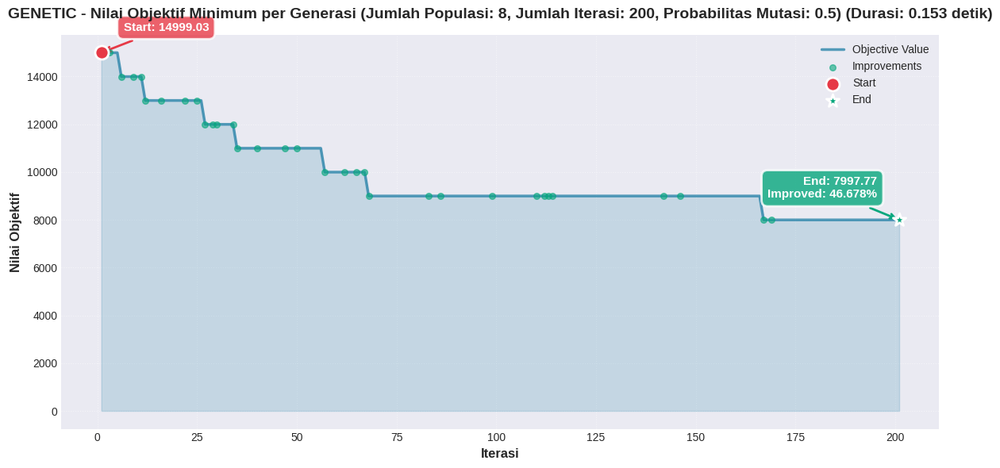


Menjalankan GA dengan Populasi = 8


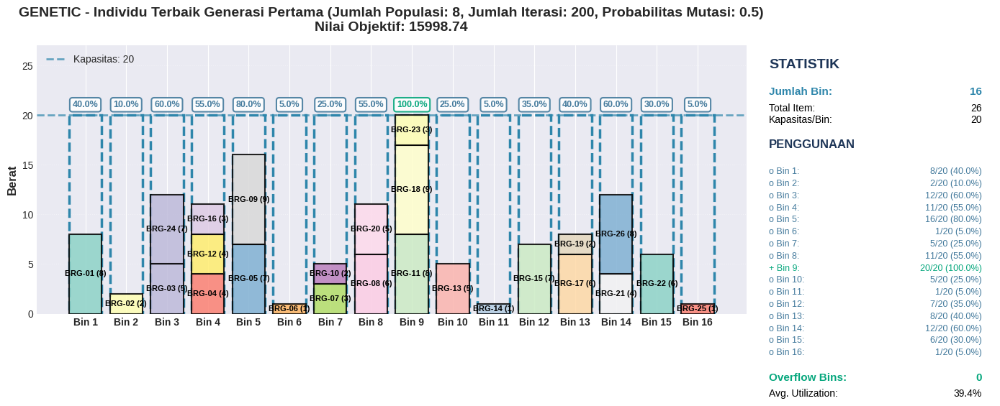

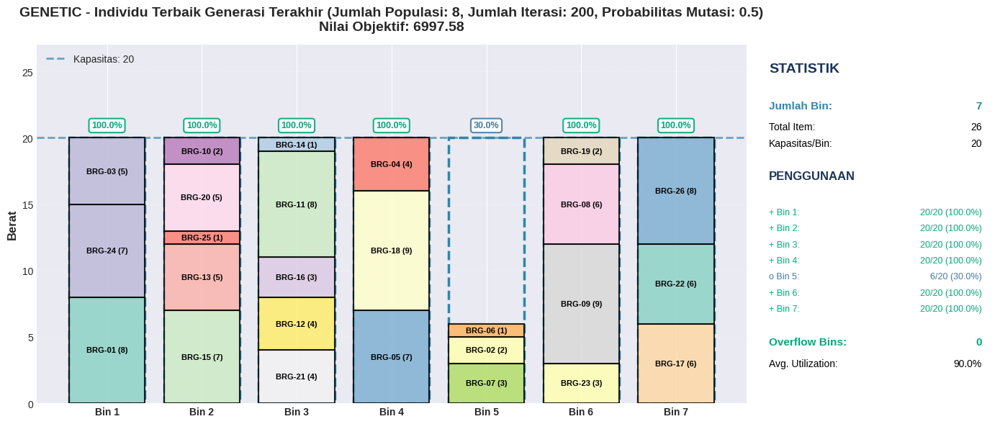

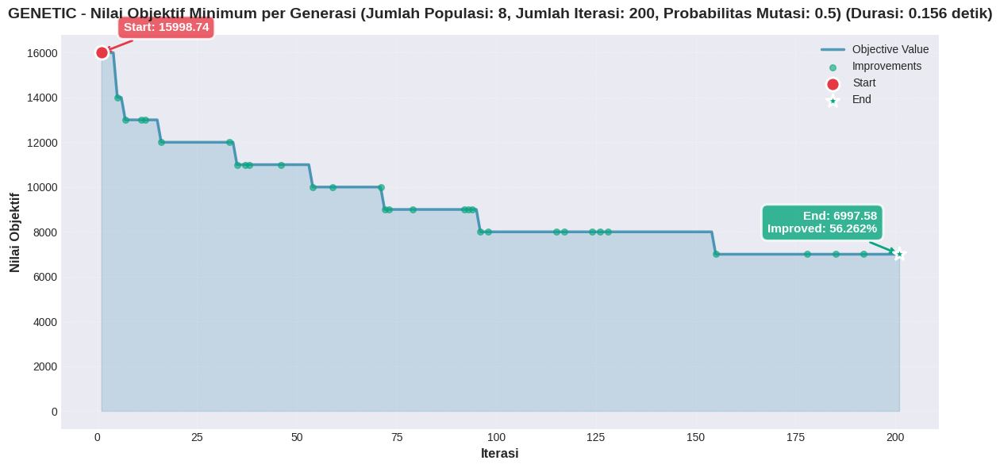


Menjalankan GA dengan Populasi = 8


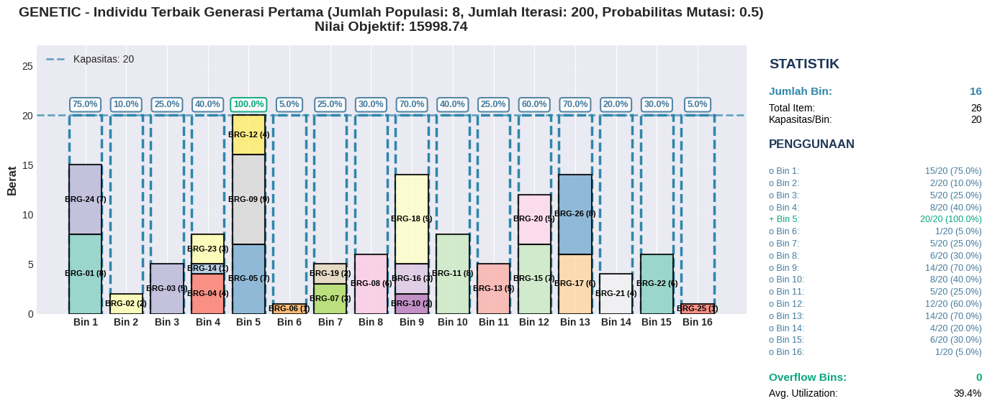

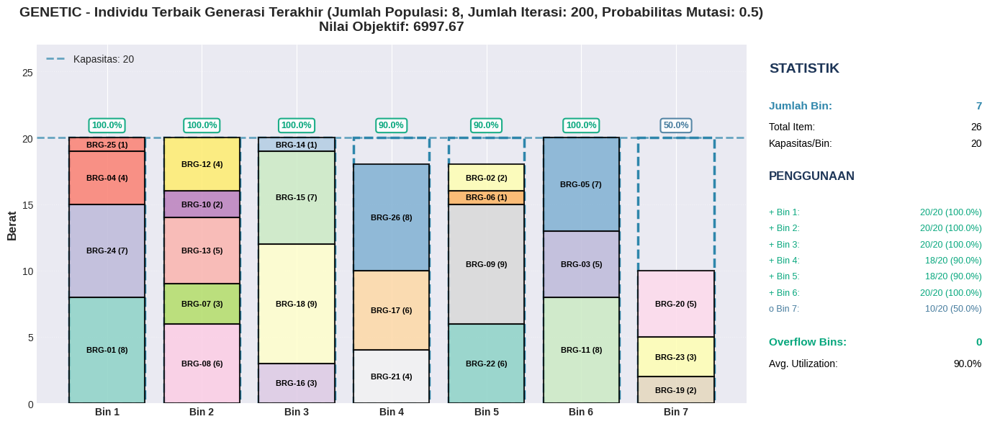

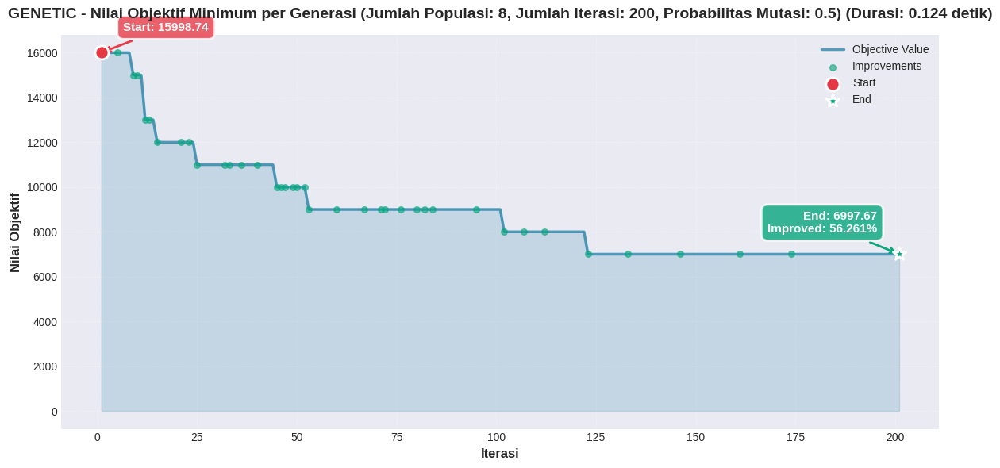


Menjalankan GA dengan Populasi = 16


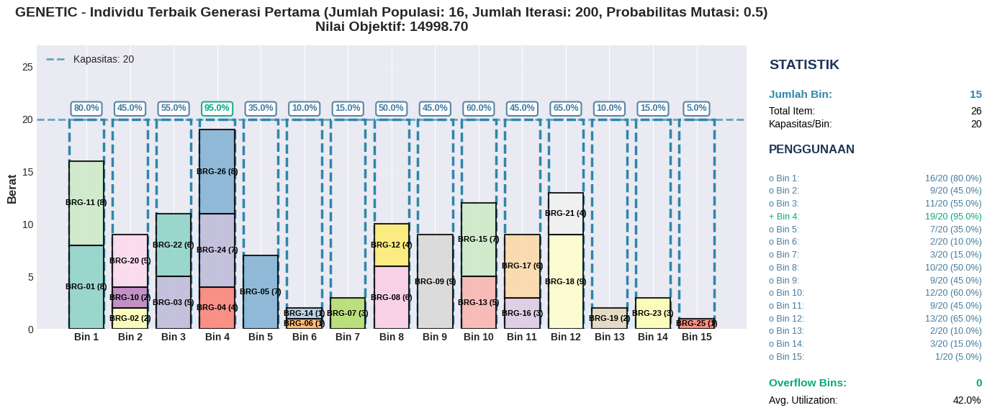

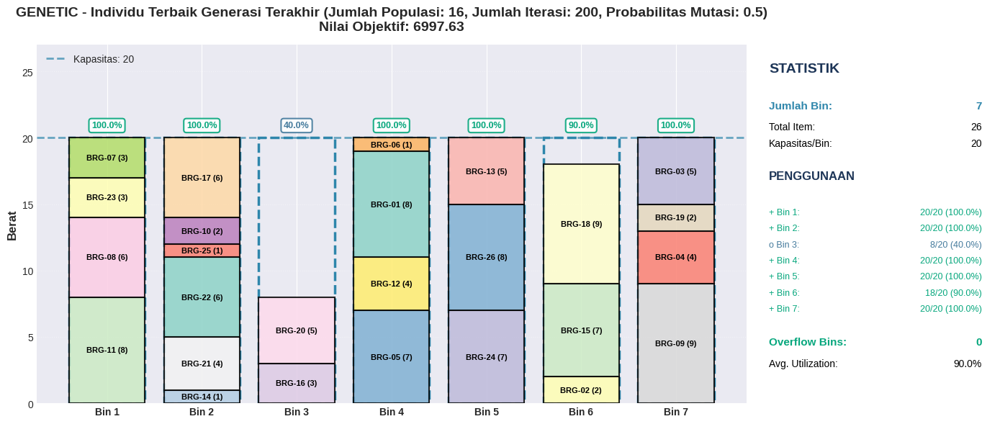

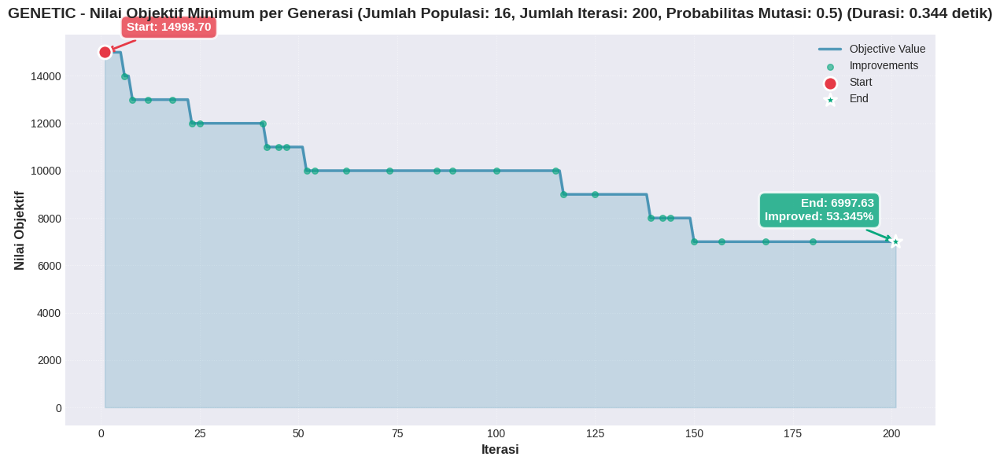


Menjalankan GA dengan Populasi = 16


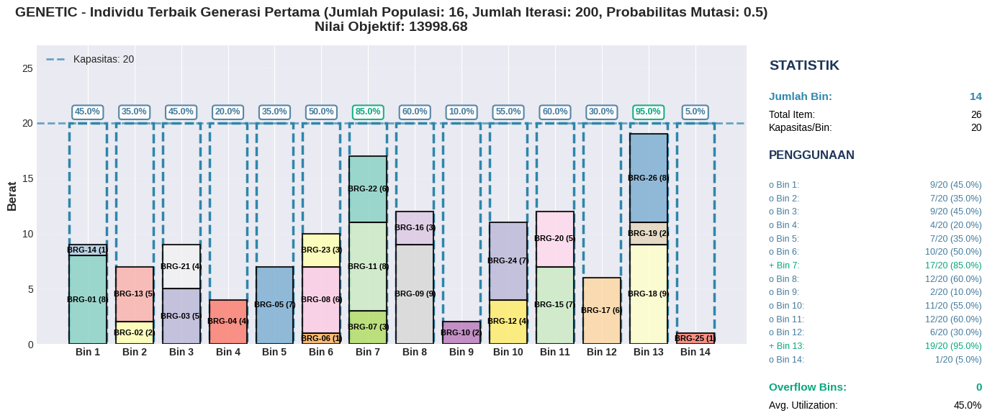

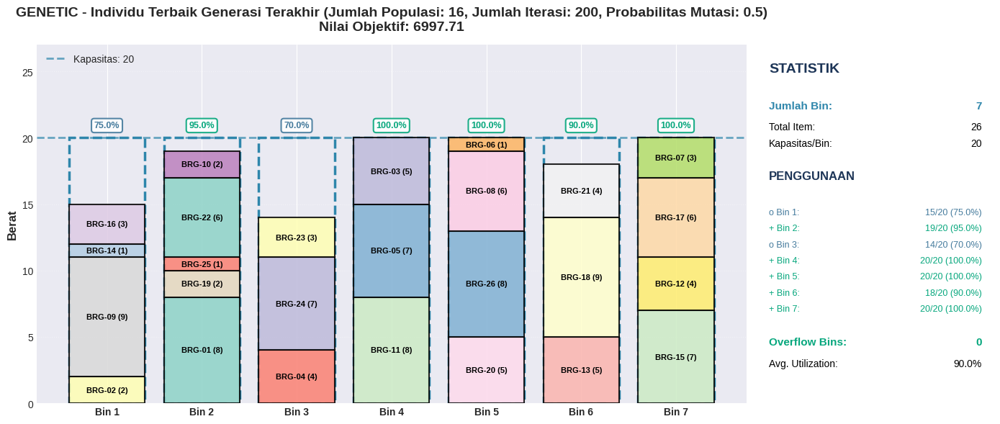

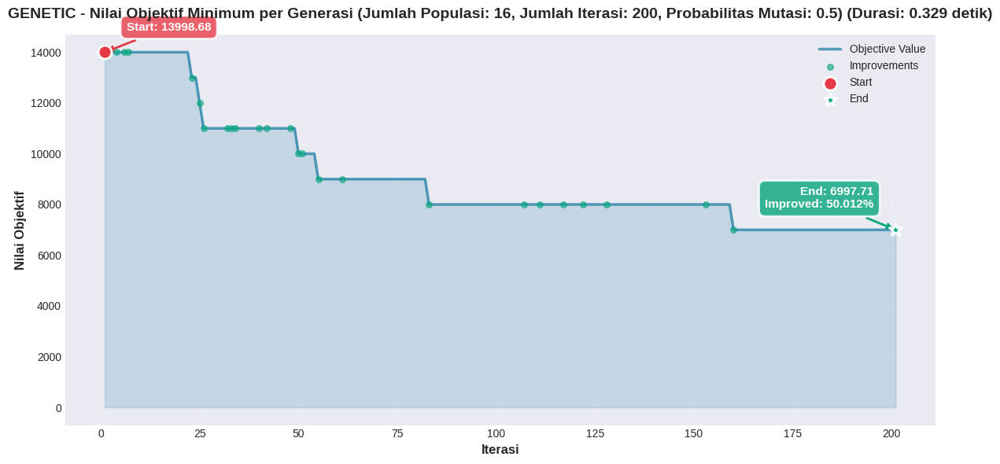


Menjalankan GA dengan Populasi = 16


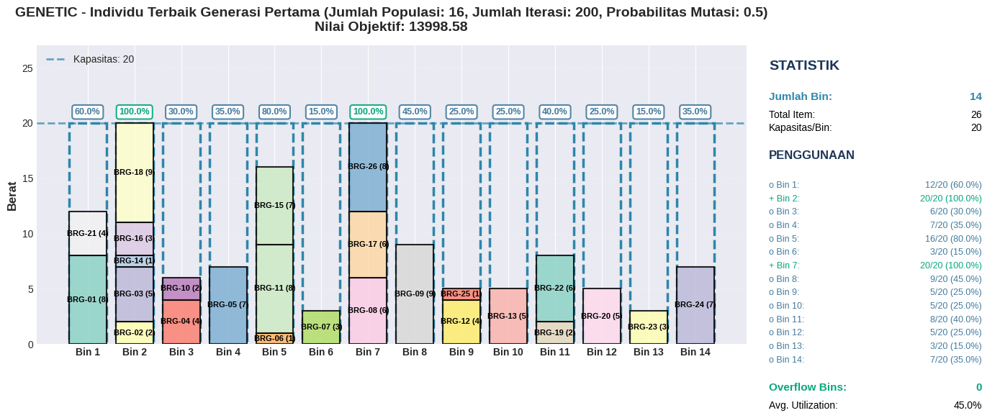

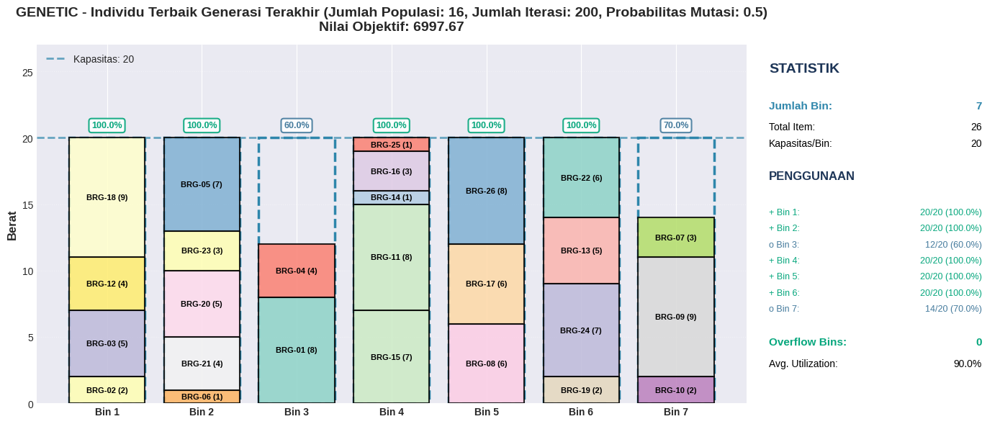

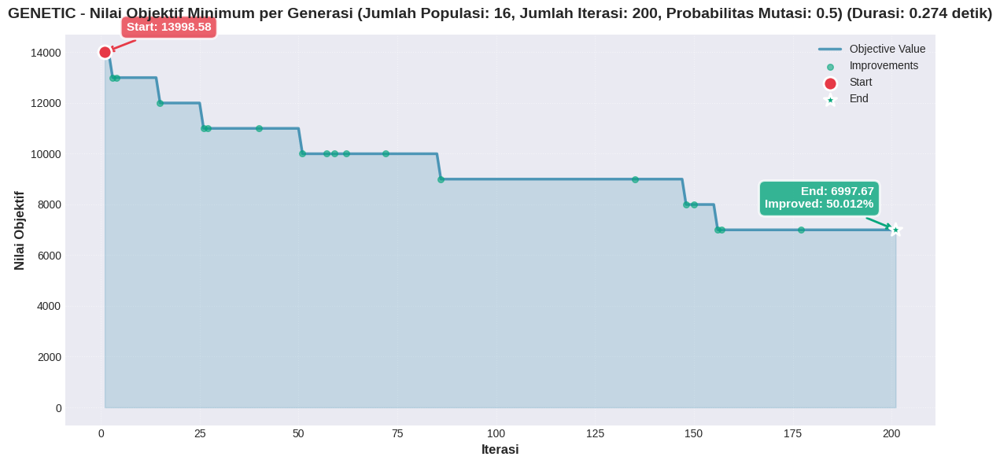


Menjalankan GA dengan Generasi = 100


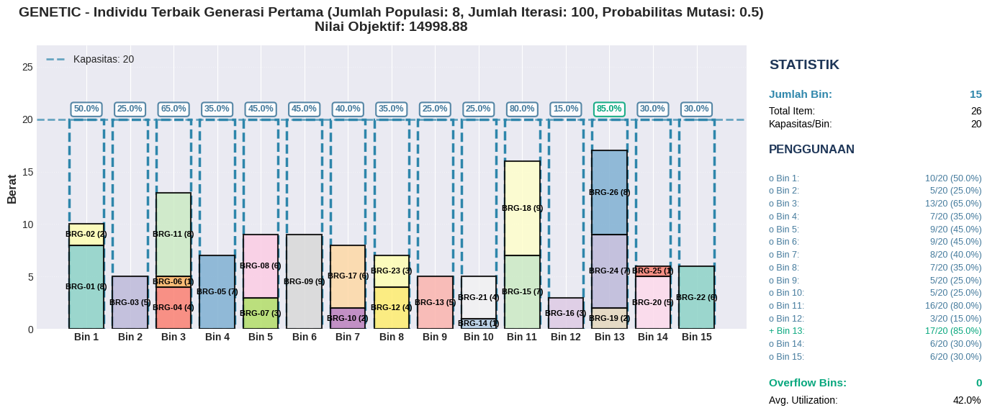

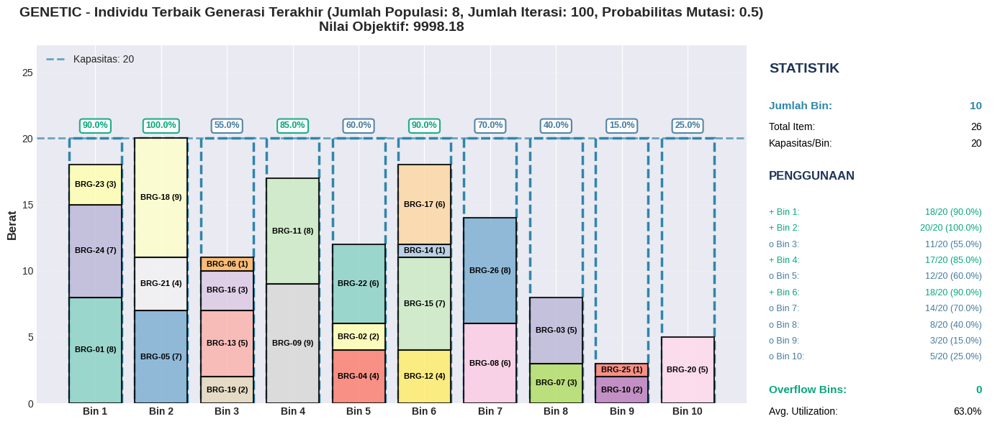

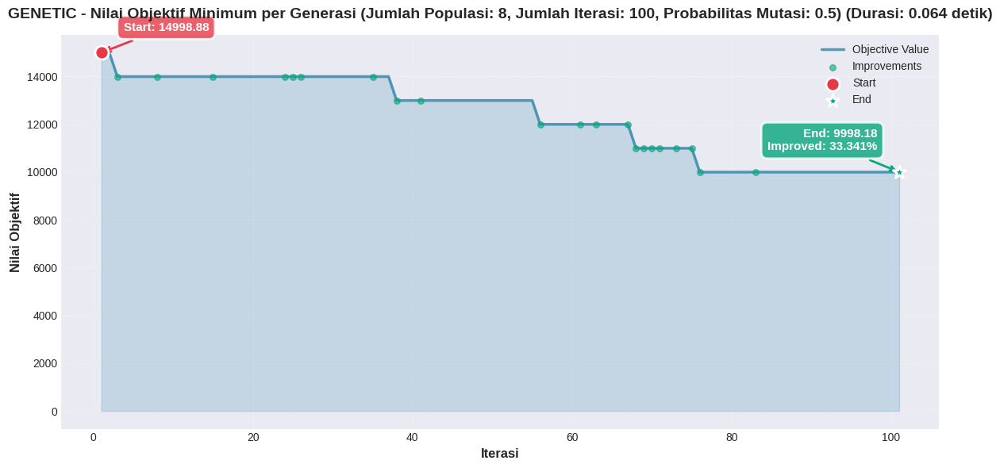


Menjalankan GA dengan Generasi = 100


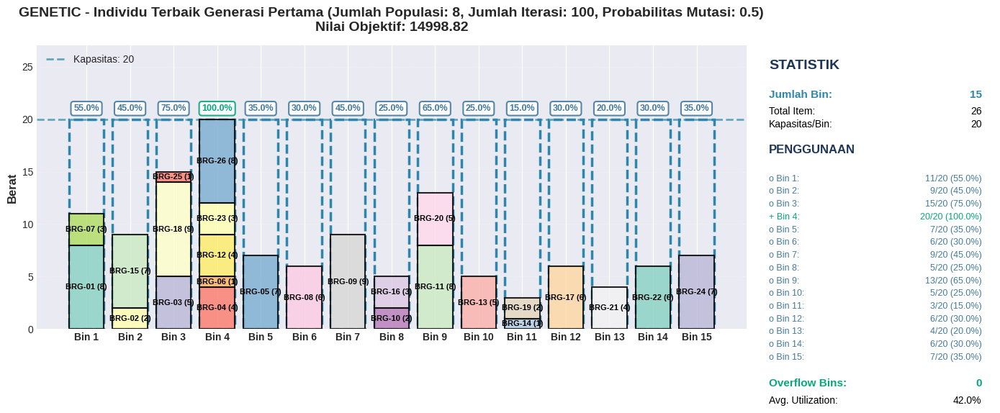

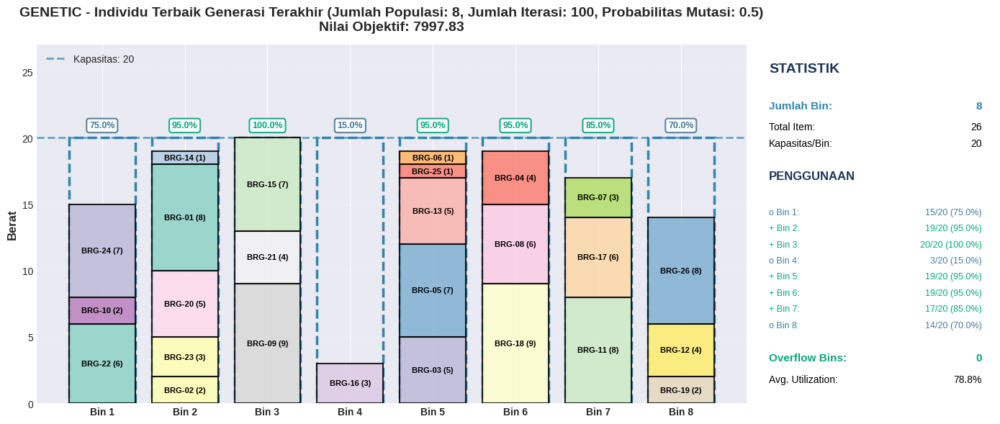

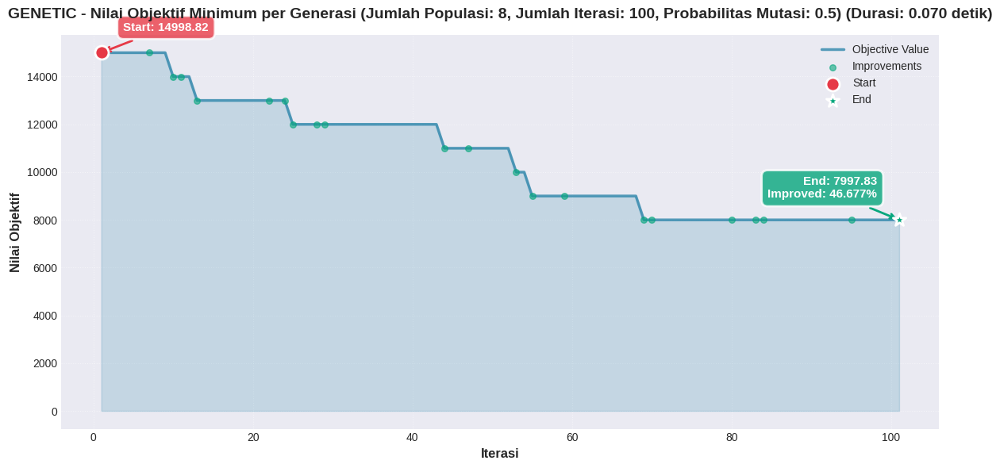


Menjalankan GA dengan Generasi = 100


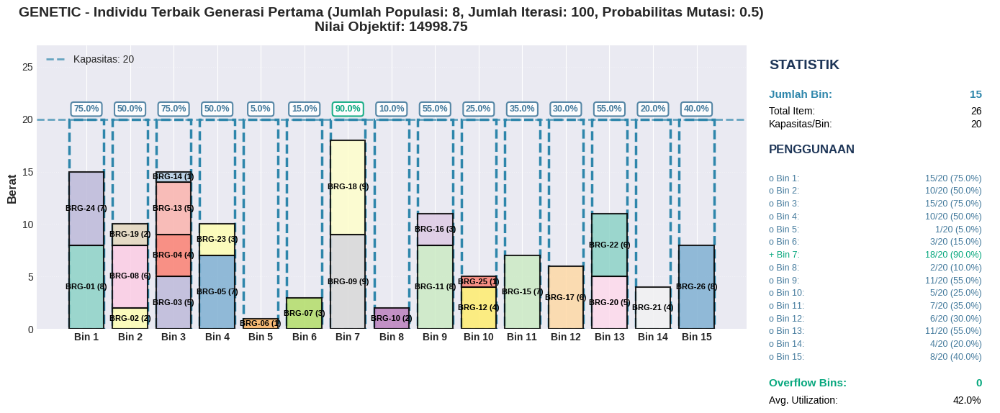

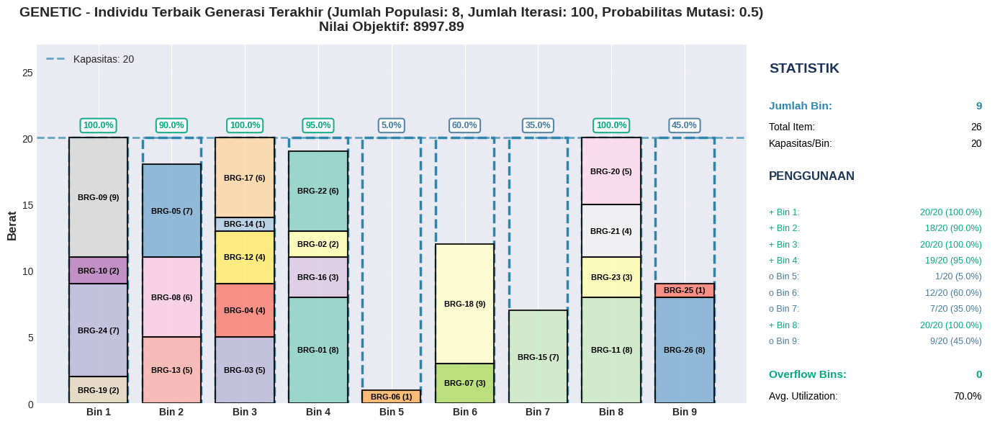

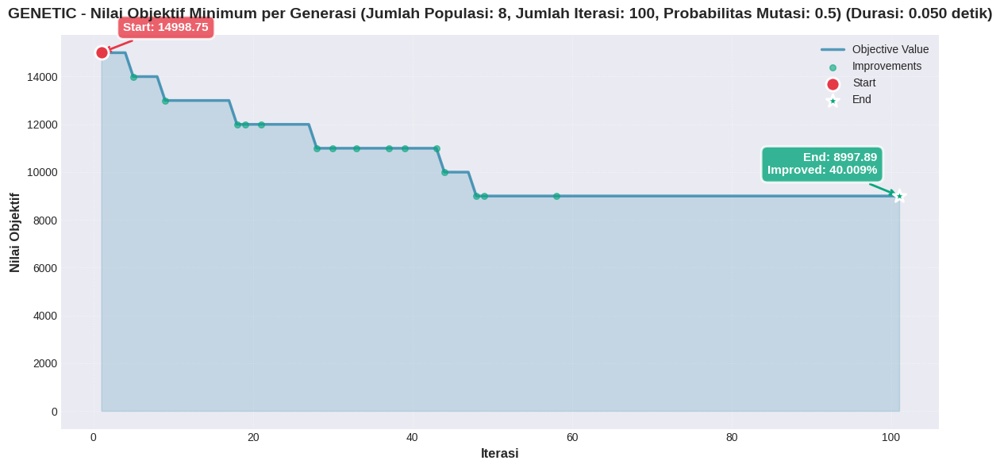


Menjalankan GA dengan Generasi = 200


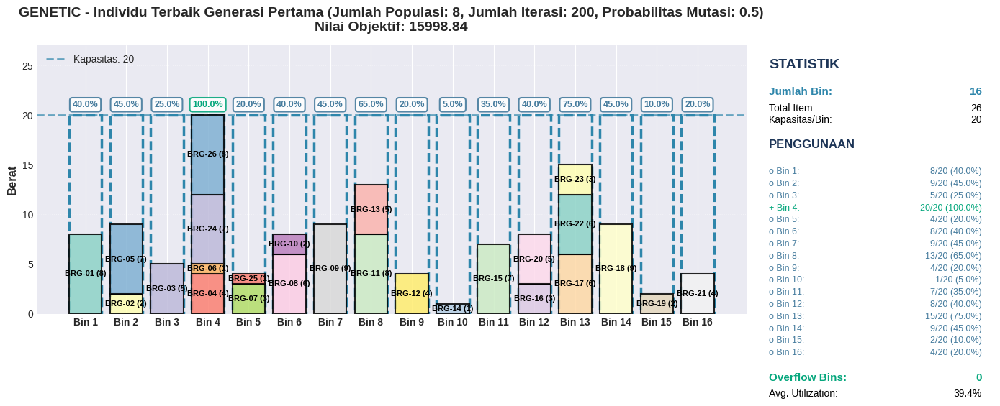

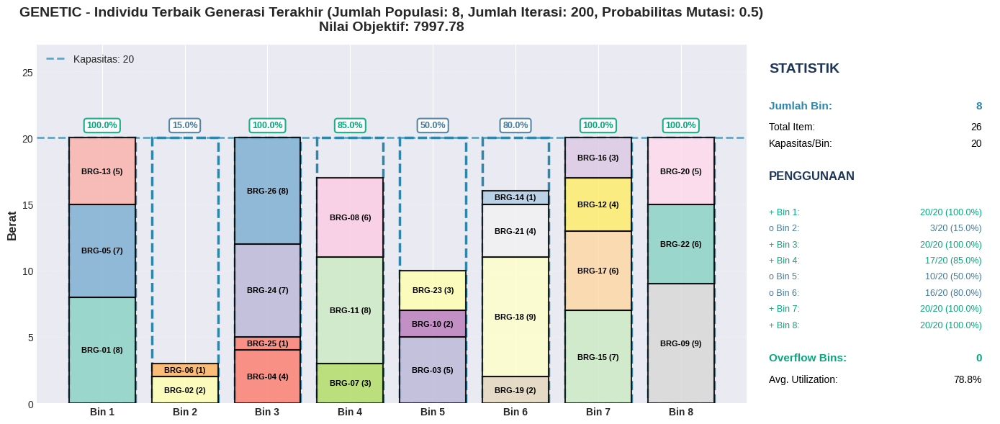

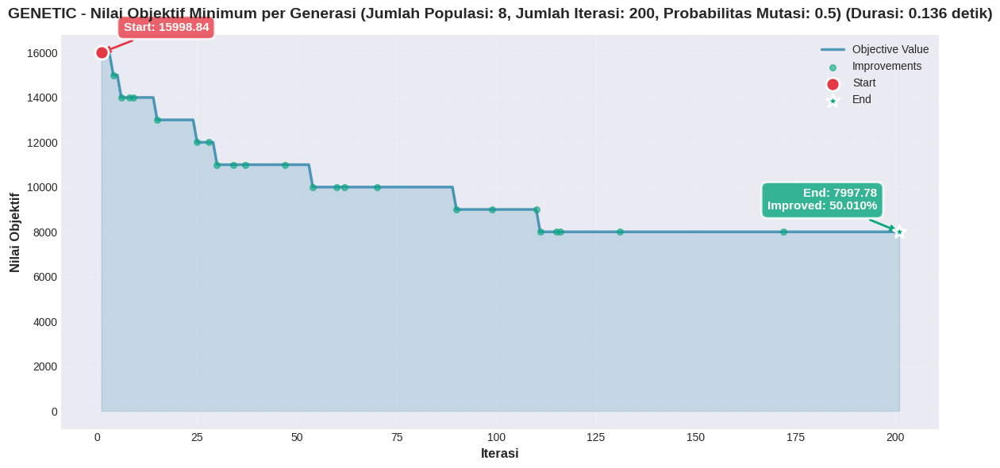


Menjalankan GA dengan Generasi = 200


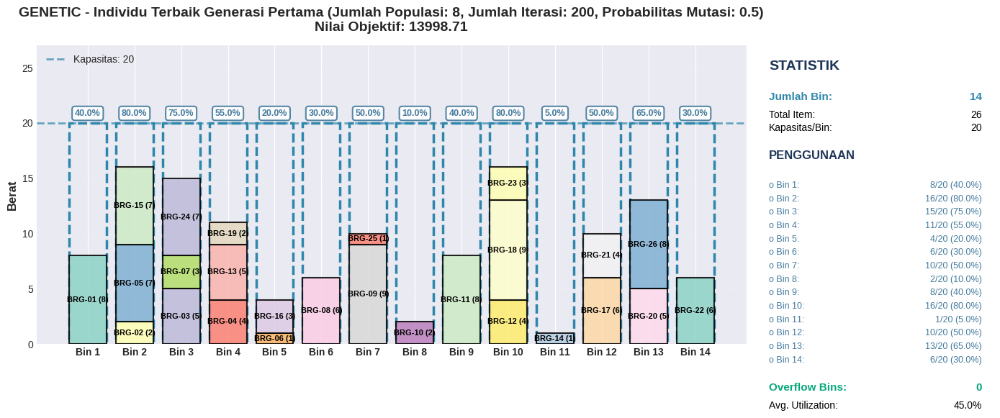

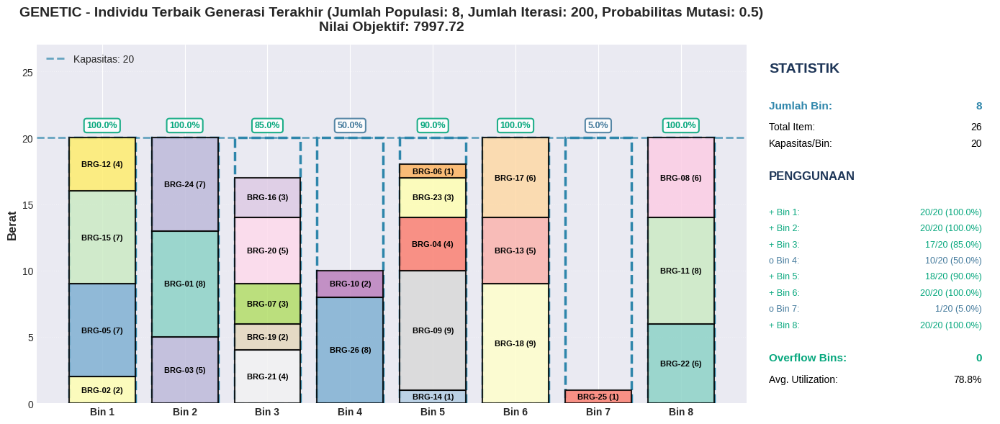

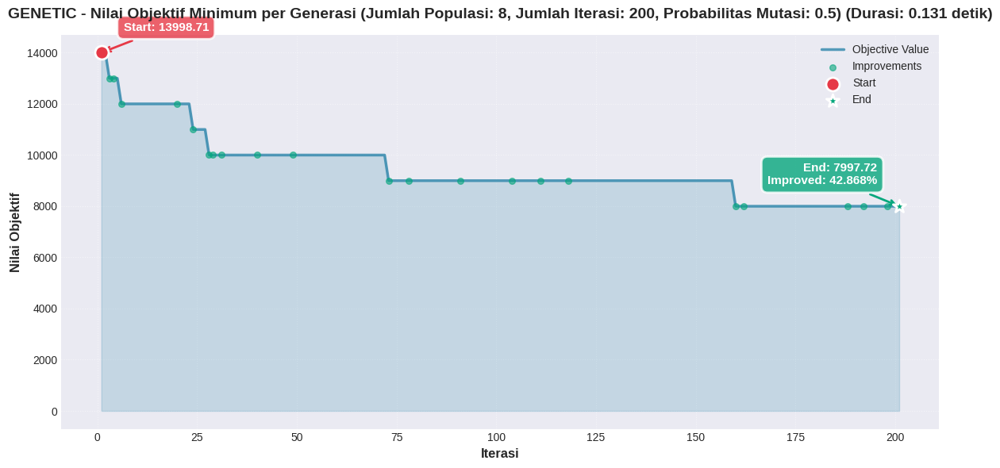


Menjalankan GA dengan Generasi = 200


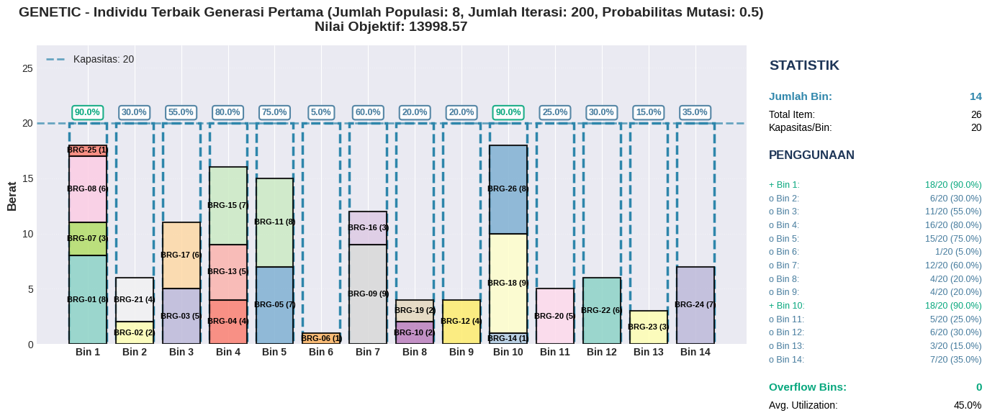

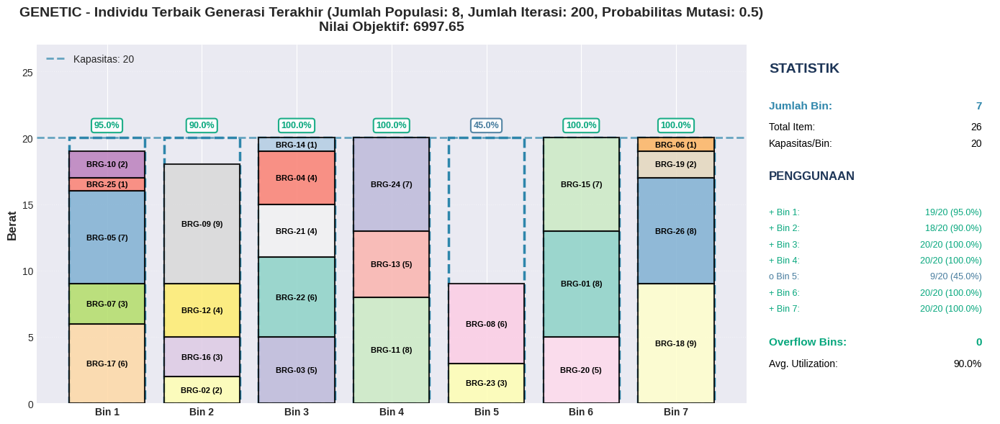

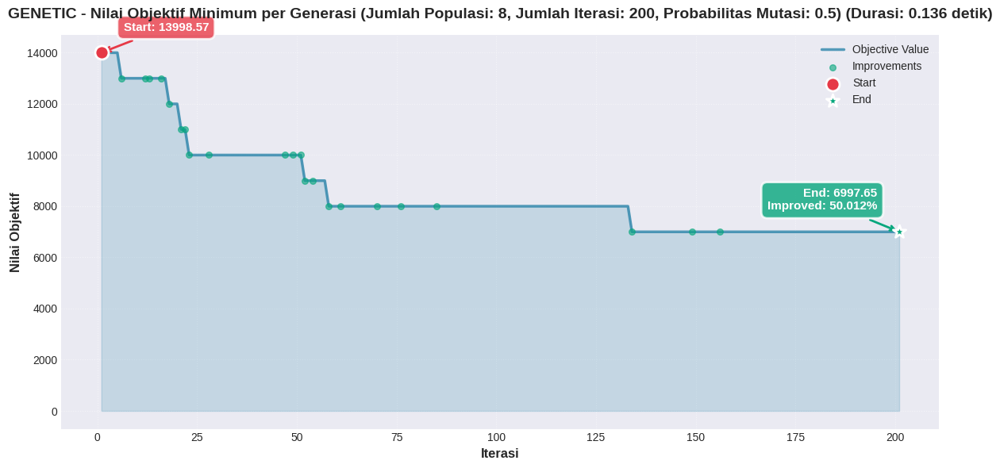


Menjalankan GA dengan Generasi = 500


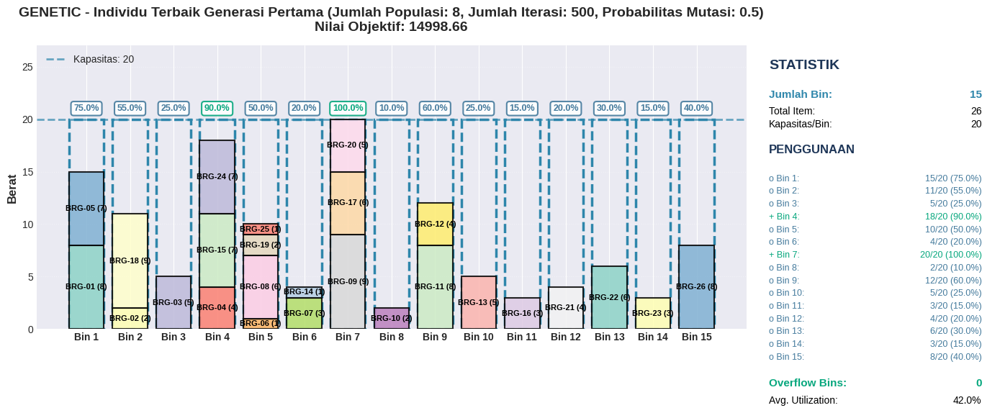

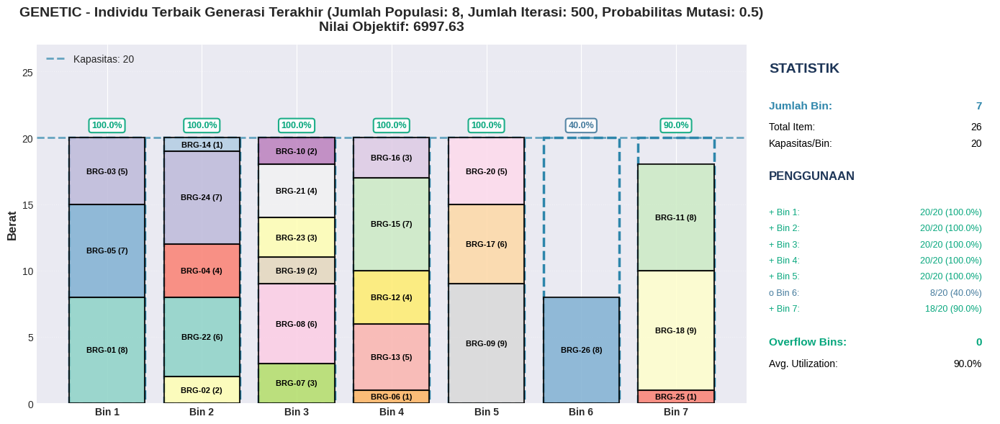

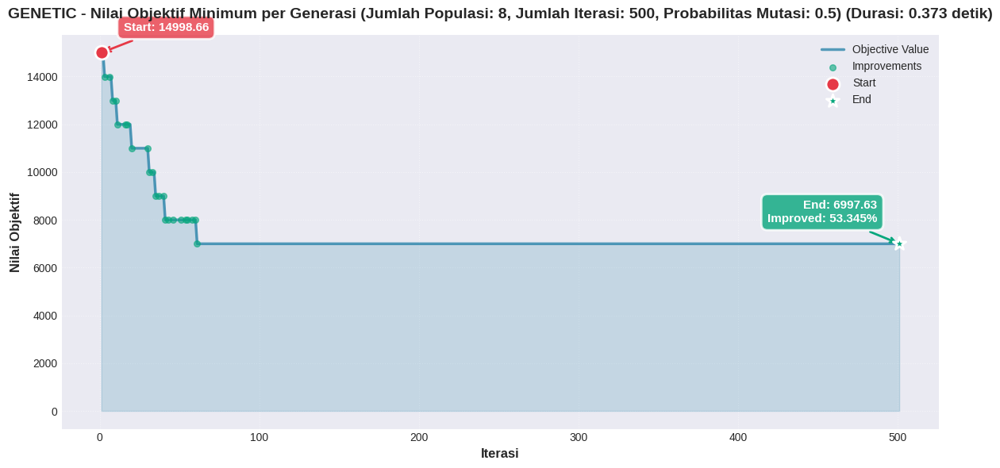


Menjalankan GA dengan Generasi = 500


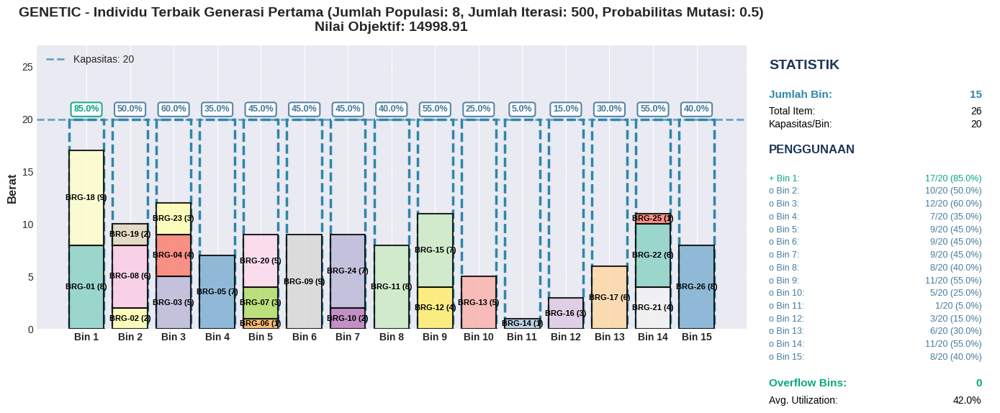

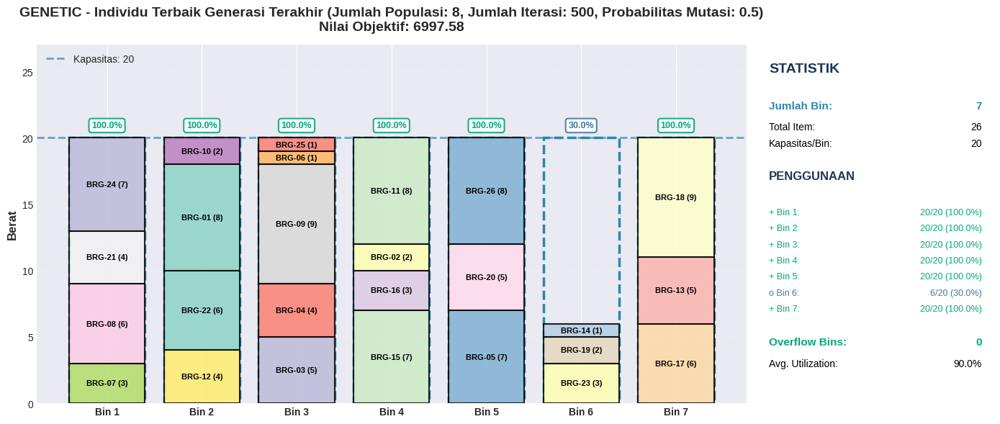

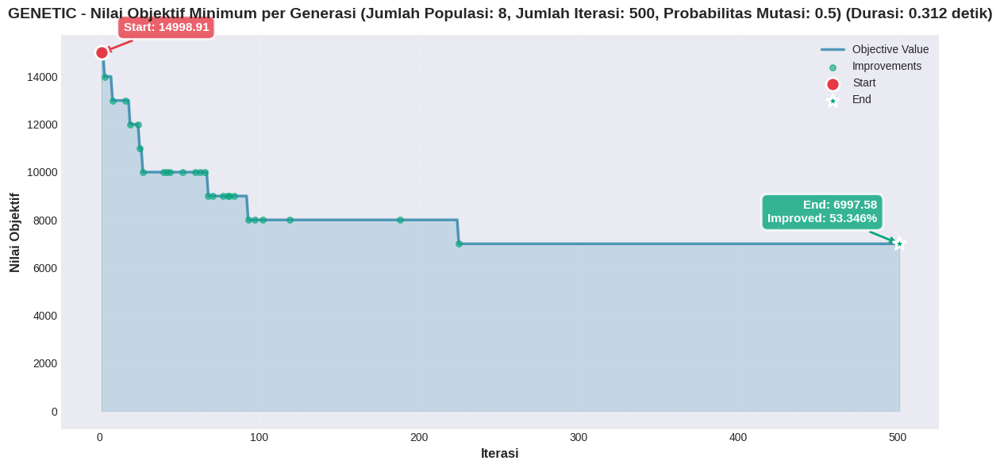


Menjalankan GA dengan Generasi = 500


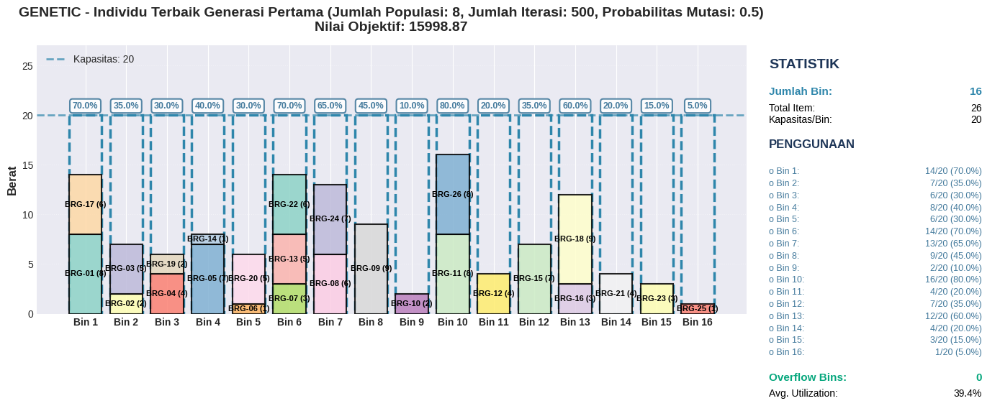

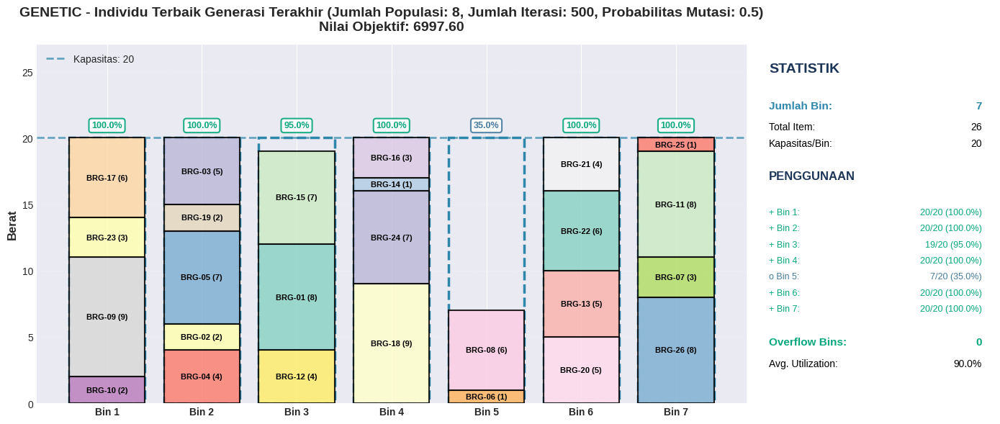

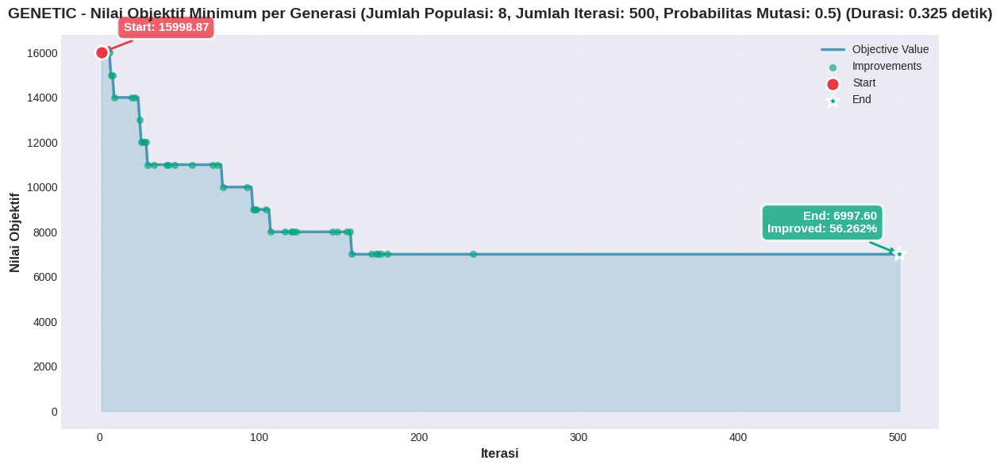

In [ ]:
print("\nEKSPERIMEN GENETIC ALGORITHM")
population_base = 8
max_iteration_base = 200
mutation = 0.15
population_variations = [2, 8, 16]
max_iteration_variations = [100, 200, 500]
mutation_rate_variations = [0.15, 0.5]

print("\n=== Eksperimen 2: Variasi Jumlah Generasi ===")
for mutation in mutation_rate_variations:
  print(f"\nMenjalankan GA dengan Mutation Rate = {mutation}")
  for pop_size in population_variations:
    for i in range(3):
      print(f"\nMenjalankan GA dengan Populasi = {pop_size}")

      min_objective_values, best_initial_individual, best_final_individual, duration = Genetic.run(
        items=EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        population_size=pop_size,
        max_iteration=max_iteration_base,
        mutation_rate=mutation,
      )

      Visualizer.visualize_state(
        best_initial_individual,
        EXPERIMENT_ITEMS,
        EXPERIMENT_CAPACITY,
        f"GENETIC - Individu Terbaik Generasi Pertama (Jumlah Populasi: {pop_size}, Jumlah Iterasi: {max_iteration_base}, Probabilitas Mutasi: {mutation})"
      )

      Visualizer.visualize_state(
        best_final_individual,
        EXPERIMENT_ITEMS,
        EXPERIMENT_CAPACITY,
        f"GENETIC - Individu Terbaik Generasi Terakhir (Jumlah Populasi: {pop_size}, Jumlah Iterasi: {max_iteration_base}, Probabilitas Mutasi: {mutation})"
      )

      Visualizer.plot_objective_values(
        min_objective_values,
        duration,
        title=f"GENETIC - Nilai Objektif Minimum per Generasi (Jumlah Populasi: {pop_size}, Jumlah Iterasi: {max_iteration_base}, Probabilitas Mutasi: {mutation})"
      )

  for gens in max_iteration_variations:
    for i in range(3):
      print(f"\nMenjalankan GA dengan Generasi = {gens}")
      min_objective_values, best_initial_individual, best_final_individual, duration = Genetic.run(
        items=EXPERIMENT_ITEMS,
        max_capacity=EXPERIMENT_CAPACITY,
        population_size=8,
        max_iteration=gens,
        mutation_rate=mutation
      )

      Visualizer.visualize_state(
        best_initial_individual,
        EXPERIMENT_ITEMS,
        EXPERIMENT_CAPACITY,
        f"GENETIC - Individu Terbaik Generasi Pertama (Jumlah Populasi: {population_base}, Jumlah Iterasi: {gens}, Probabilitas Mutasi: {mutation})"
      )

      Visualizer.visualize_state(
        best_final_individual,
        EXPERIMENT_ITEMS,
        EXPERIMENT_CAPACITY,
        f"GENETIC - Individu Terbaik Generasi Terakhir (Jumlah Populasi: {population_base}, Jumlah Iterasi: {gens}, Probabilitas Mutasi: {mutation})"
      )

      Visualizer.plot_objective_values(
        min_objective_values,
        duration,
        title=f"GENETIC - Nilai Objektif Minimum per Generasi (Jumlah Populasi: {population_base}, Jumlah Iterasi: {gens}, Probabilitas Mutasi: {mutation})"
      )


